In [14]:
import numpy as np
import pandas as pd
from econml.dr import DRLearner
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier, XGBRegressor
from sklearn.ensemble import GradientBoostingClassifier, GradientBoostingRegressor
from sklearn.linear_model import LinearRegression
from sklearn.calibration import CalibratedClassifierCV
from sklearn.model_selection import train_test_split
from sklearn.impute import KNNImputer
from sklearn.preprocessing import MinMaxScaler
from sklift.viz import plot_qini_curve, plot_uplift_curve
from sklift.metrics import qini_auc_score, uplift_auc_score
from sklearn.calibration import calibration_curve
import matplotlib.pyplot as plt
from nb21 import elast, cumulative_gain

In [15]:
# Load dataset
data = pd.read_csv('../data/bsc_project_set.csv')
data = data.drop(['id', 'Unnamed: 0', 'peep'], axis=1)

# Convert categorical data into numeric
categorical_columns = ['sex', 'peep_regime', 'mort_28']
data = pd.get_dummies(data, columns=categorical_columns, drop_first=False)
data = data.drop(['sex_F', 'peep_regime_low', 'mort_28_True'], axis=1)

numeric_columns = data.columns.difference(['mort_28_False'])
scaler = MinMaxScaler()
data[numeric_columns] = scaler.fit_transform(data[numeric_columns])

imputer = KNNImputer(n_neighbors=11, weights='uniform')
data[numeric_columns] = imputer.fit_transform(data[numeric_columns])

# Define treatment and outcome columns
treatment_column = 'peep_regime_high'
outcome_column = 'mort_28_False'

# Define features (excluding treatment and outcome)
features = list(set(data.columns) - {treatment_column, outcome_column})
selected_features = ['age', 'urea', 'weight', 'pf_ratio', 'po2', 'ph', 'fio2', 'driving_pressure', 'plateau_pressure']

X = data[selected_features]
Y = data[outcome_column]
T = data[treatment_column]





KeyboardInterrupt: 

# Evaluation

In [31]:
# Function to evaluate the DR-Learner with given models
def eval_model(calibrated_propensity_model, regression_model, final_model, X, Y, T, selected_features, model_name, n_splits=10):
    results = {'train': [], 'test': []}
    
    for i in range(n_splits):
        print(f"Iteration {i} for {model_name}")
        
        X_train, X_test, y_train, y_test, t_train, t_test = train_test_split(X, Y, T, test_size=0.2, random_state=i*768)

        calibrated_propensity_model.fit(X_train, t_train)

        dr_learner = DRLearner(
            model_propensity=calibrated_propensity_model, 
            model_regression=regression_model,
            model_final=final_model,
            discrete_outcome=True, 
            cv=3,
            random_state=768
        )

        dr_learner.fit(y_train.astype(int), t_train, X=X_train, W=None)
        
        cate_train = dr_learner.effect(X=X_train)
        cate_test = dr_learner.effect(X=X_test)
        
        data_train = pd.DataFrame(X_train, columns=selected_features)
        data_train['outcome'] = y_train
        data_train['treatment'] = t_train
        data_train['CATE_DR'] = cate_train
        
        data_test = pd.DataFrame(X_test, columns=selected_features)
        data_test['outcome'] = y_test
        data_test['treatment'] = t_test
        data_test['CATE_DR'] = cate_test
        
        qini_auc_train = qini_auc_score(data_train['outcome'], data_train['CATE_DR'], data_train['treatment'])
        qini_auc_test = qini_auc_score(data_test['outcome'], data_test['CATE_DR'], data_test['treatment'])
        
        uplift_auc_train = uplift_auc_score(data_train['outcome'], data_train['CATE_DR'], data_train['treatment'])
        uplift_auc_test = uplift_auc_score(data_test['outcome'], data_test['CATE_DR'], data_test['treatment'])
        
        results['train'].append({'qini_auc': qini_auc_train, 'uplift_auc': uplift_auc_train})
        results['test'].append({'qini_auc': qini_auc_test, 'uplift_auc': uplift_auc_test})

        # Visualize Qini Curve Test
        fig, ax = plt.subplots(1, 1)
        ax.set_title(f'Qini curve test - {model_name}')
        plot_qini_curve(data_test['outcome'], data_test['CATE_DR'], data_test['treatment'], perfect=False, name='DR-Learner', ax=ax)
        plt.title(f"Qini curve - test - {model_name}")
        plt.legend(loc='best')
        plt.savefig(f'plots/DR/Qini_curve_test_{model_name}_iter_{i+1}.png', bbox_inches='tight')
        plt.savefig(f'plots/DR/Qini_curve_test_{model_name}_iter_{i+1}.svg', bbox_inches='tight')
        plt.show()

        # Visualize Qini Curve Train
        fig, ax = plt.subplots(1, 1)
        ax.set_title(f'Qini curve train - {model_name}')
        plot_qini_curve(data_train['outcome'], data_train['CATE_DR'], data_train['treatment'], perfect=False, name='DR-Learner', ax=ax)
        plt.title(f"Qini curve - train - {model_name}")
        plt.legend(loc='best')
        plt.savefig(f'plots/DR/Qini_curve_train_{model_name}_iter_{i+1}.png', bbox_inches='tight')
        plt.savefig(f'plots/DR/Qini_curve_train_{model_name}_iter_{i+1}.svg', bbox_inches='tight')
        plt.show()

        # Visualize Uplift Curve Test
        fig, ax = plt.subplots(1, 1)
        ax.set_title(f'Uplift curve test - {model_name}')
        plot_uplift_curve(data_test['outcome'], data_test['CATE_DR'], data_test['treatment'], perfect=False, name='DR-Learner', ax=ax)
        plt.title(f"Uplift curve - test - {model_name}")
        plt.legend(loc='best')
        plt.savefig(f'plots/DR/Uplift_curve_test_{model_name}_iter_{i+1}.png', bbox_inches='tight')
        plt.savefig(f'plots/DR/Uplift_curve_test_{model_name}_iter_{i+1}.svg', bbox_inches='tight')
        plt.show()

        # Visualize Uplift Curve Train
        fig, ax = plt.subplots(1, 1)
        ax.set_title(f'Uplift curve train - {model_name}')
        plot_uplift_curve(data_train['outcome'], data_train['CATE_DR'], data_train['treatment'], perfect=False, name='DR-Learner', ax=ax)
        plt.title(f"Uplift curve - train - {model_name}")
        plt.legend(loc='best')
        plt.savefig(f'plots/DR/Uplift_curve_train_{model_name}_iter_{i+1}.png', bbox_inches='tight')
        plt.savefig(f'plots/DR/Uplift_curve_train_{model_name}_iter_{i+1}.svg', bbox_inches='tight')
        plt.show()
        
        train_data = pd.concat([X_train, y_train, t_train], axis=1)
        test_data = pd.concat([X_test, y_test, t_test], axis=1)

        gain_curve_dr_lr_train = cumulative_gain(train_data.assign(cate=cate_train), "cate", y=outcome_column, t=treatment_column)
        gain_curve_dr_lr_test = cumulative_gain(test_data.assign(cate=cate_test), "cate", y=outcome_column, t=treatment_column)


        # plt.figure(dpi=200)
        plt.plot(gain_curve_dr_lr_test, color="C4", label="DR-Learner Test")
        plt.plot(gain_curve_dr_lr_train, color="C5", label="DR-Learner Train")
        plt.plot([0, 100], [0, elast(data, outcome_column, treatment_column)], linestyle="--", color="black", label="Baseline")
        plt.legend(loc='best')
        plt.title(f"Cumulative gain - {model_name}")
        # plots/swapped/mimic/
        plt.savefig(f'plots/DR/Cumulative_gain_curve_train_{model_name}_iter_{i+1}.png', bbox_inches='tight')
        plt.savefig(f'plots/DR/Cumulative_gain_curve_train_{model_name}_iter_{i+1}.svg', bbox_inches='tight')
        plt.show()

    return results

In [32]:
# Configurations to test
configurations = {
    'SVM Propensity and XGBoost Response with XGBoost Regressor Final': {
        'propensity': SVC(C=1.0, kernel='linear', probability=True, random_state=768),
        'regression': XGBClassifier(learning_rate=0.01, max_depth=3, n_estimators=50, random_state=768),
        'final': XGBRegressor(n_estimators=30, random_state=768)
    },
    'SVM Propensity and Logistic Regression Response with XGBoost Regressor Final': {
        'propensity': SVC(C=1.0, kernel='linear', probability=True, random_state=768),
        'regression': LogisticRegression(C=1.0, solver='liblinear', random_state=768),
        'final': XGBRegressor(n_estimators=30, random_state=768)
    },
    'SVM Propensity and Gradient Boosting Response with XGBoost Regressor Final': {
        'propensity': SVC(C=1.0, kernel='linear', probability=True, random_state=768),
        'regression': GradientBoostingClassifier(learning_rate=0.01, max_depth=3, n_estimators=50, random_state=768),
        'final': XGBRegressor(n_estimators=30, random_state=768)
    },
    'Logistic Regression Propensity and Logistic Regression Response with Linear Regression Final': {
        'propensity': LogisticRegression(C=10.0, solver='lbfgs', random_state=768),
        'regression': LogisticRegression(C=1.0, solver='liblinear', random_state=768),
        'final': LinearRegression()
    },
    'Gradient Boosting Propensity and Gradient Boosting Response with Gradient Boosting Final': {
        'propensity': GradientBoostingClassifier(learning_rate=0.1, max_depth=3, n_estimators=50, random_state=768),
        'regression': GradientBoostingClassifier(learning_rate=0.01, max_depth=3, n_estimators=50, random_state=768),
        'final': GradientBoostingRegressor(n_estimators=30, random_state=768)
    },
    'K-Nearest Neighbors Propensity and Gradient Boosting Response with Gradient Boosting Final': {
        'propensity': KNeighborsClassifier(n_neighbors=7),
        'regression': GradientBoostingClassifier(learning_rate=0.01, max_depth=3, n_estimators=50, random_state=768),
        'final': GradientBoostingRegressor(n_estimators=30, random_state=768)
    }
}

Iteration 0 for SVM Propensity and XGBoost Response with XGBoost Regressor Final


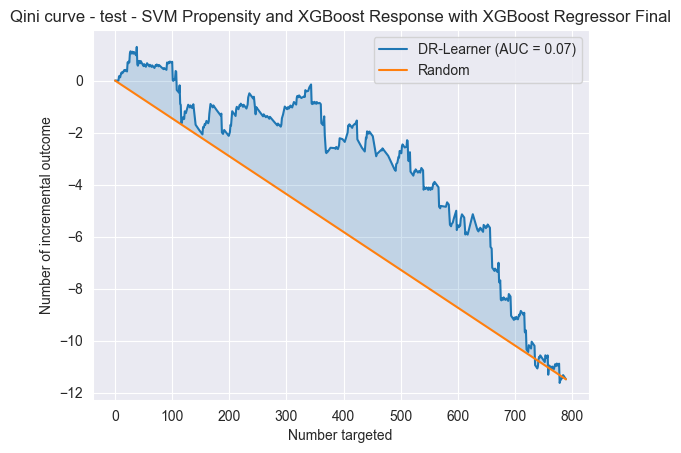

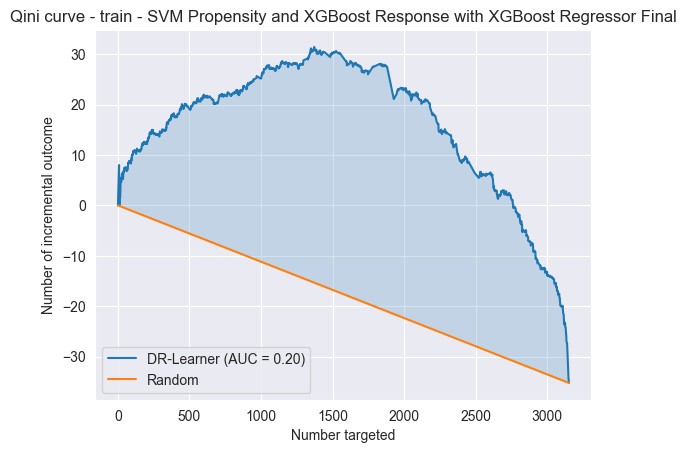

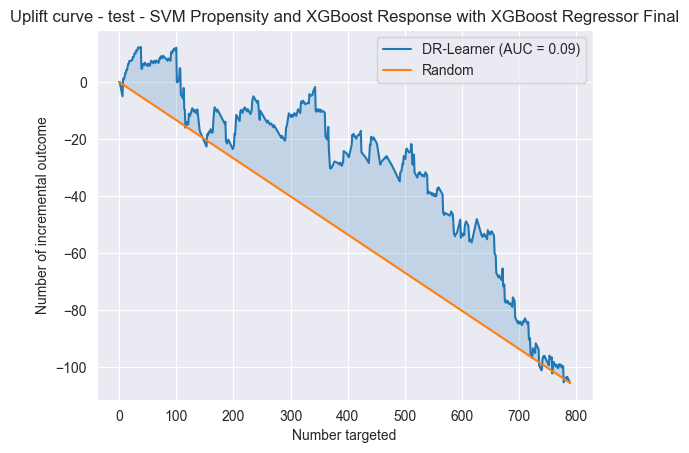

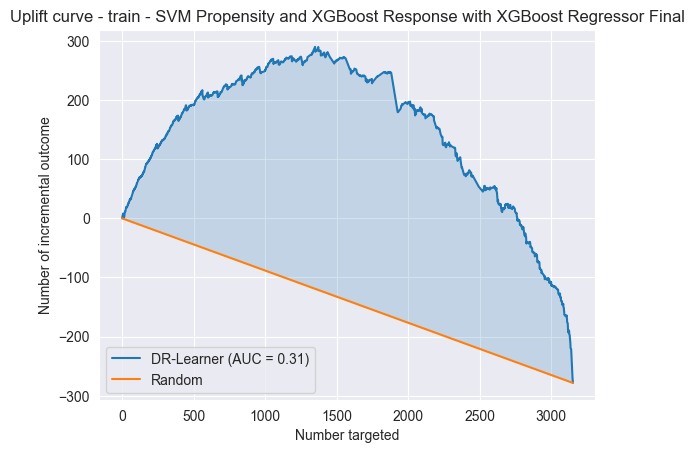

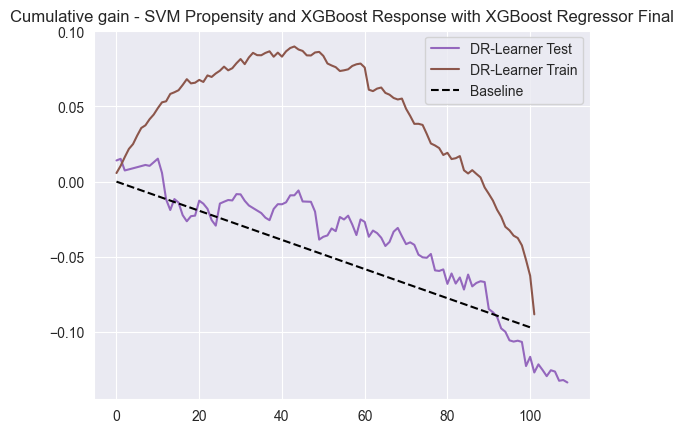

Iteration 1 for SVM Propensity and XGBoost Response with XGBoost Regressor Final


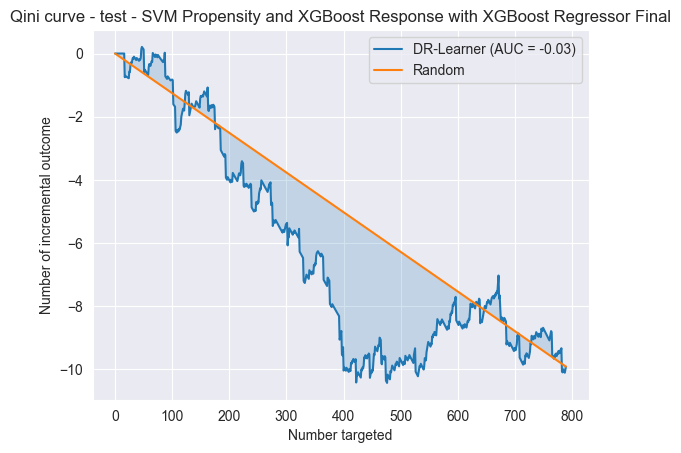

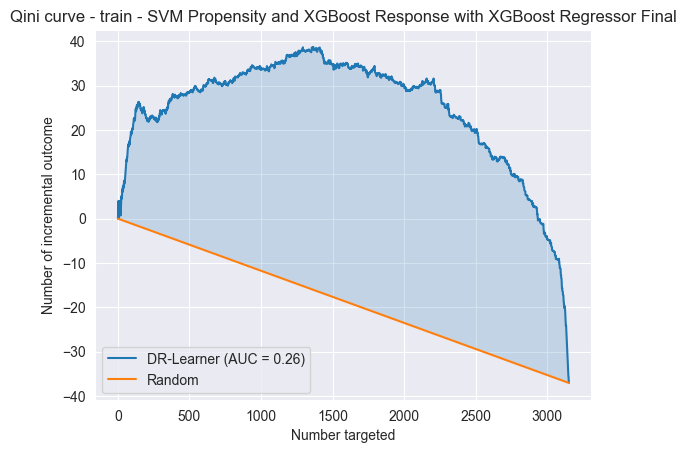

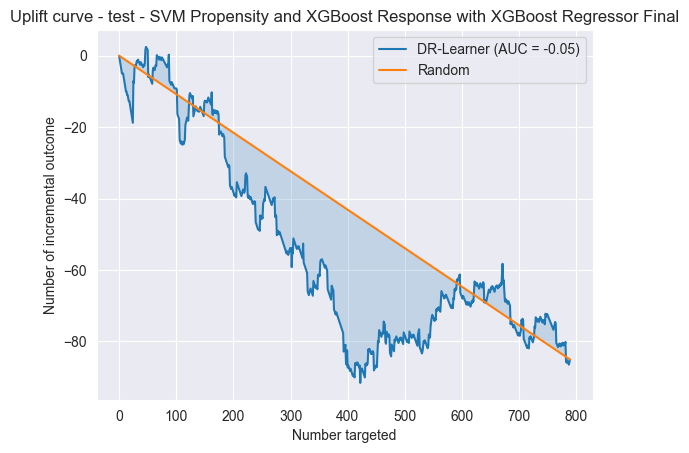

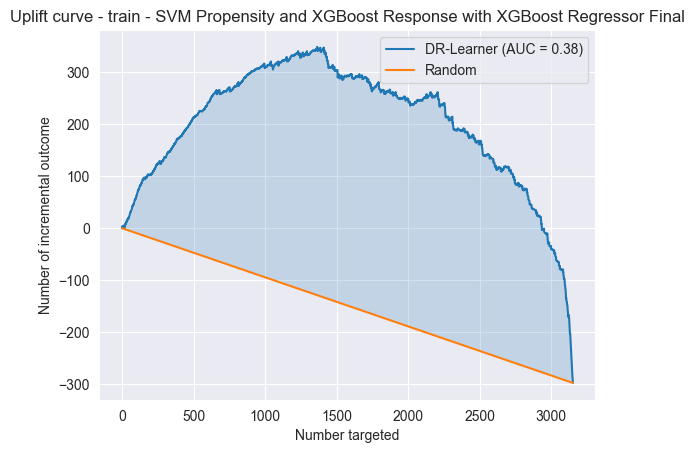

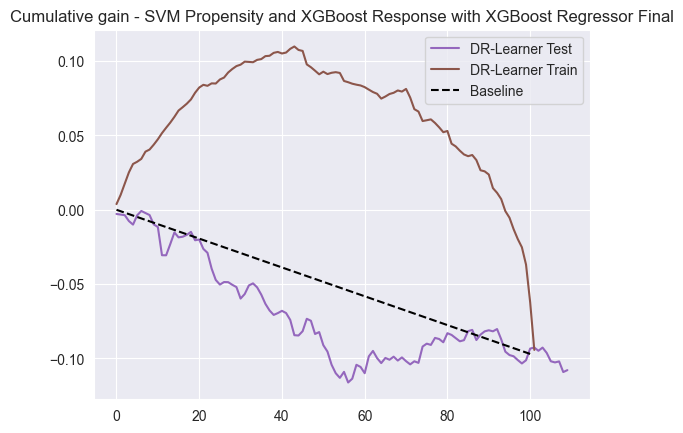

Iteration 2 for SVM Propensity and XGBoost Response with XGBoost Regressor Final


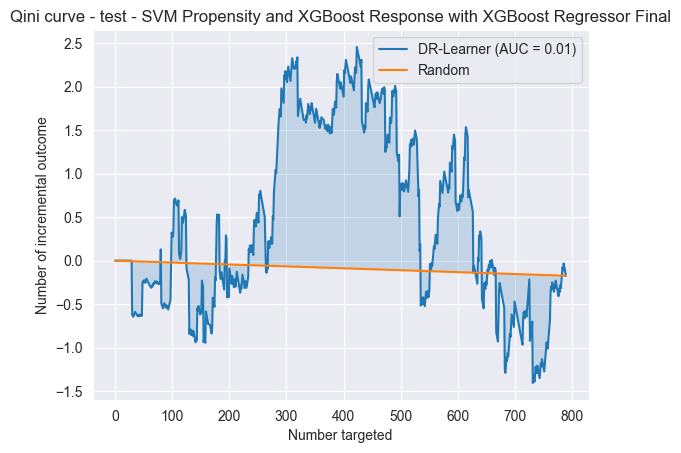

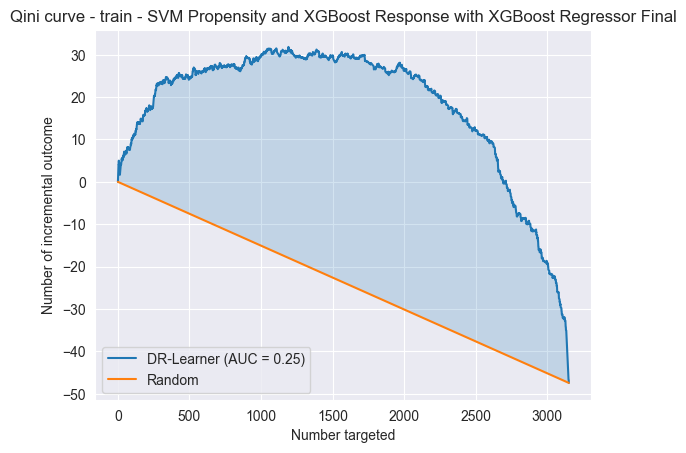

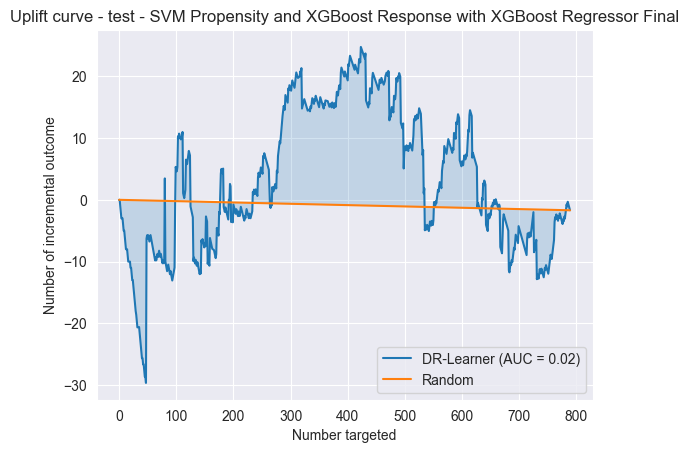

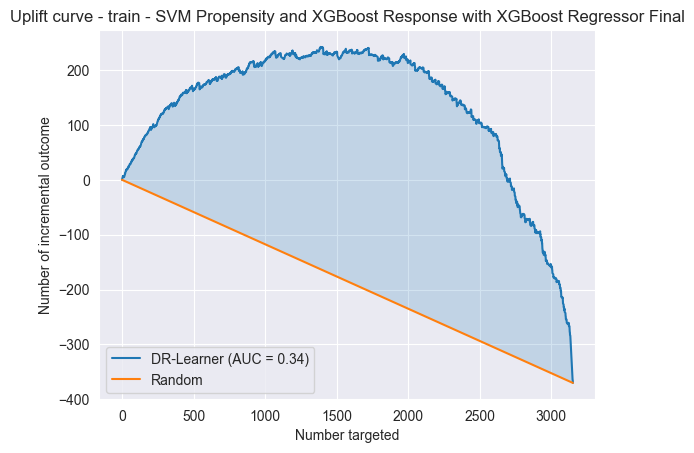

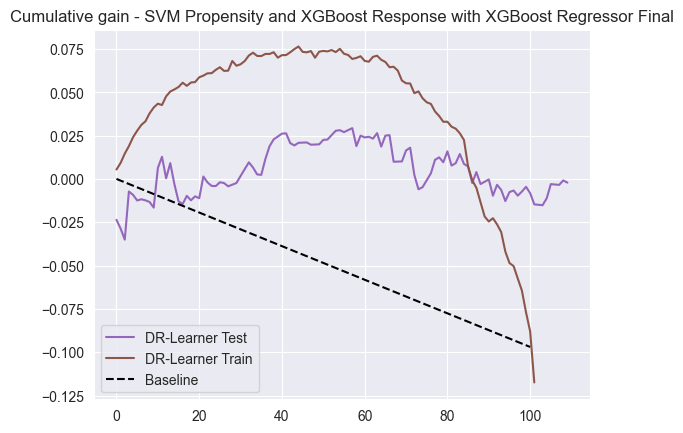

Iteration 3 for SVM Propensity and XGBoost Response with XGBoost Regressor Final


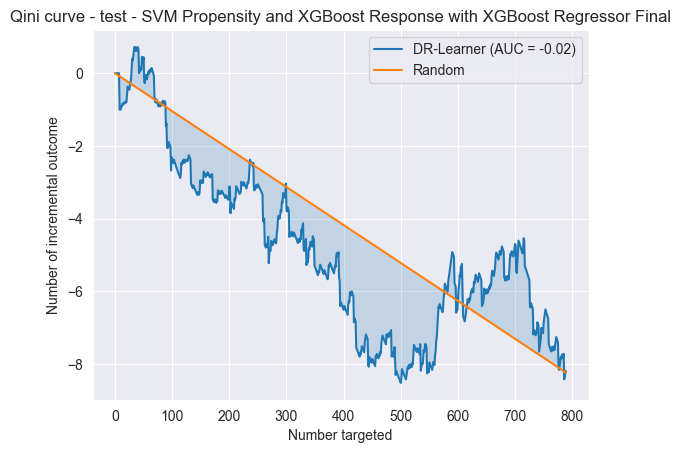

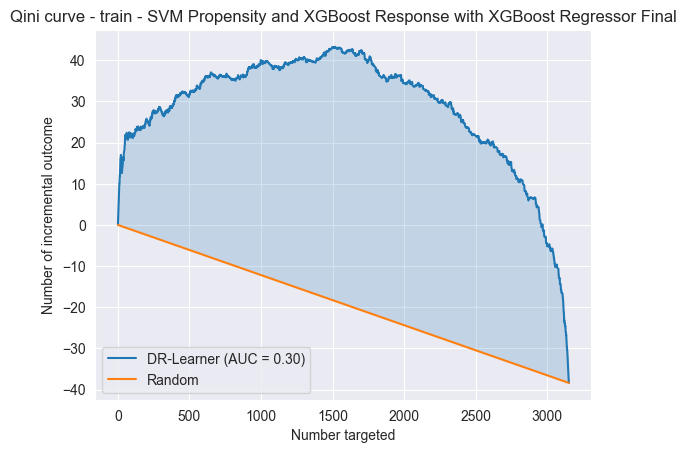

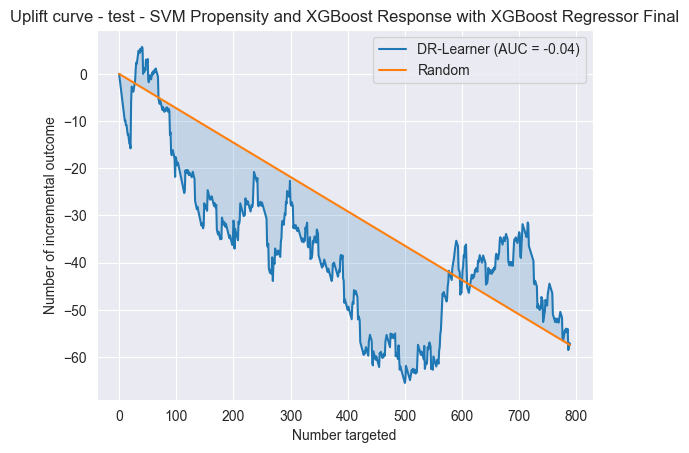

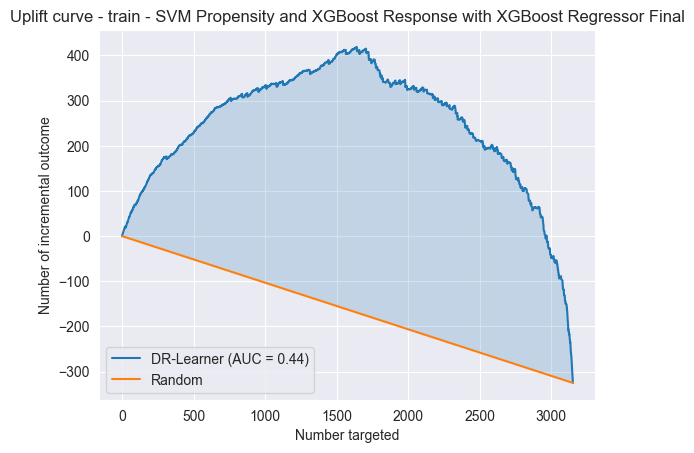

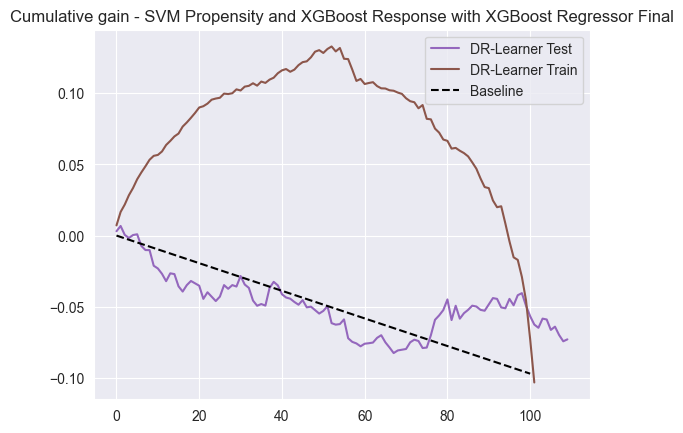

Iteration 4 for SVM Propensity and XGBoost Response with XGBoost Regressor Final


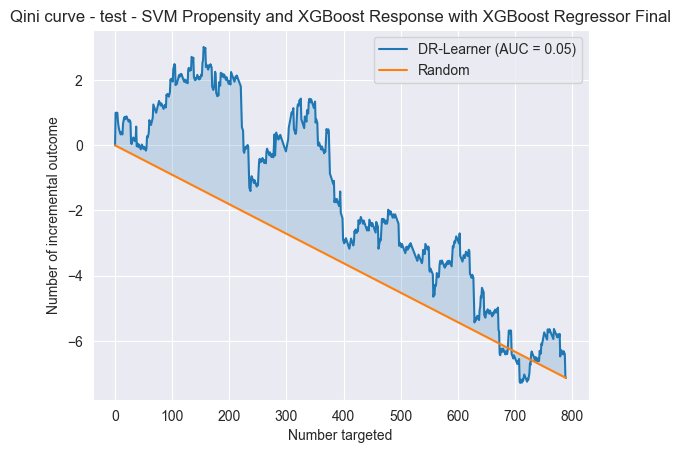

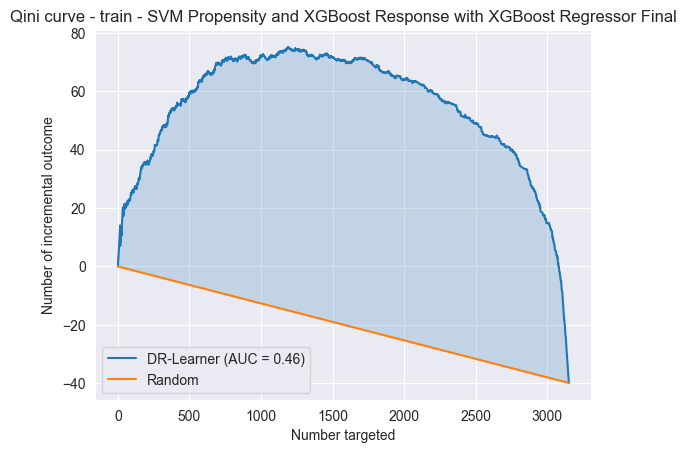

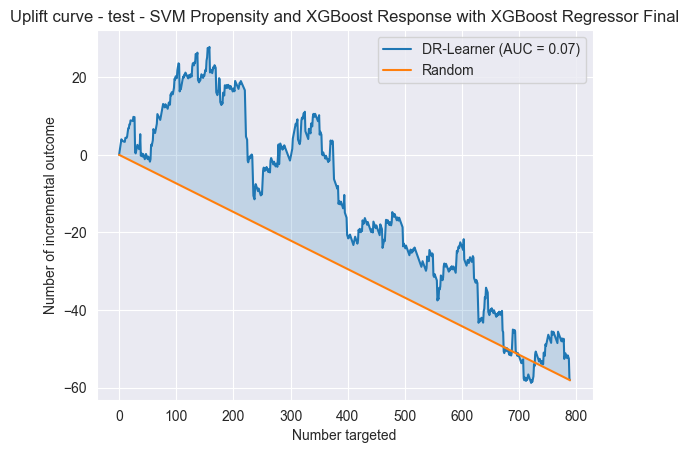

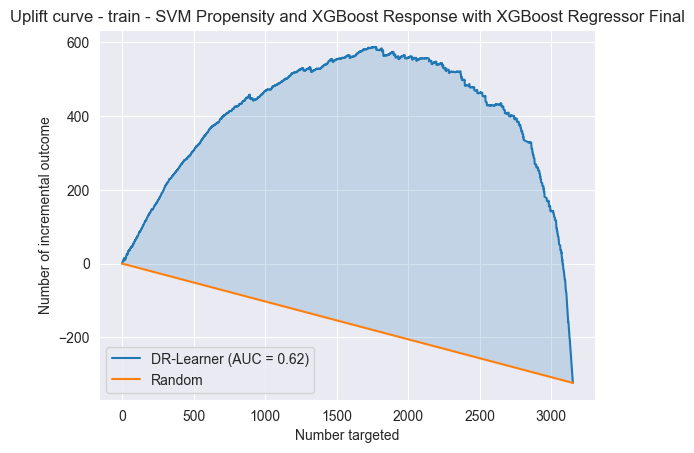

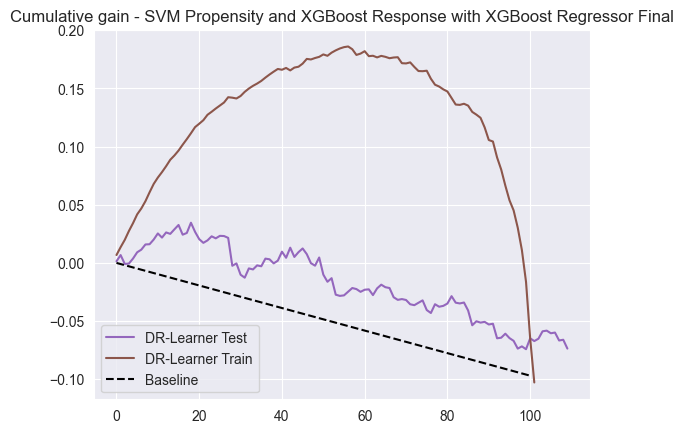

Iteration 5 for SVM Propensity and XGBoost Response with XGBoost Regressor Final


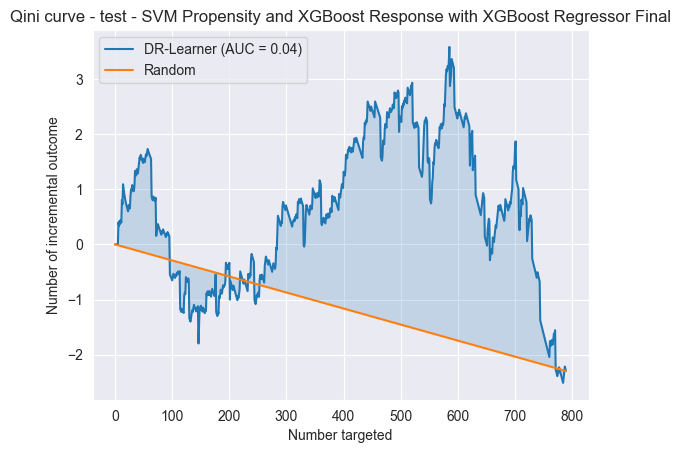

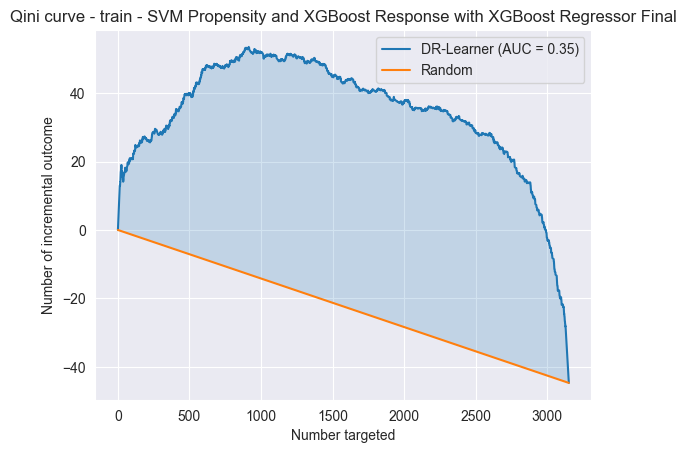

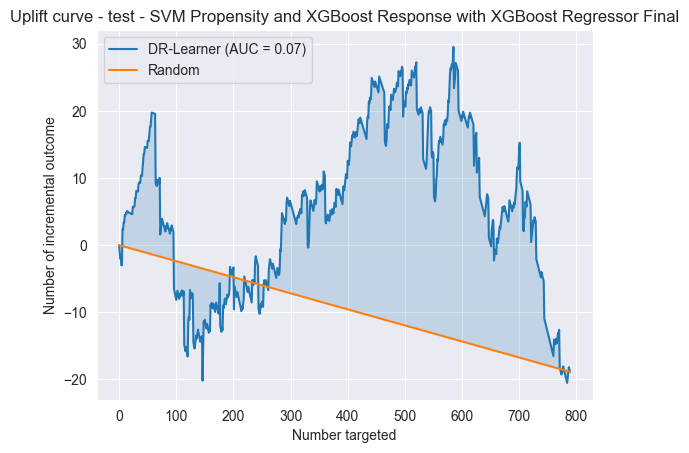

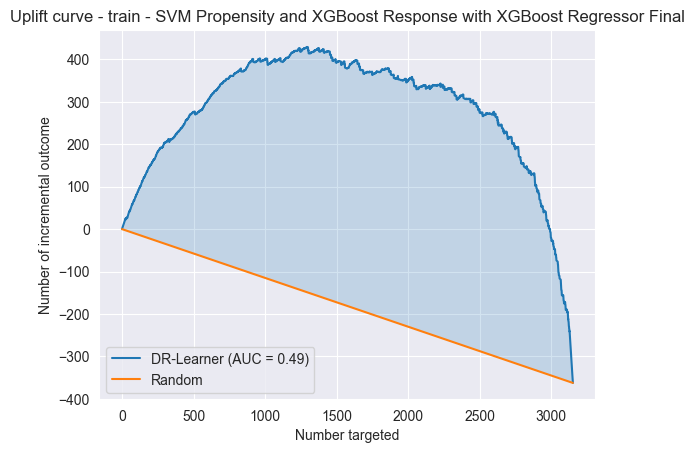

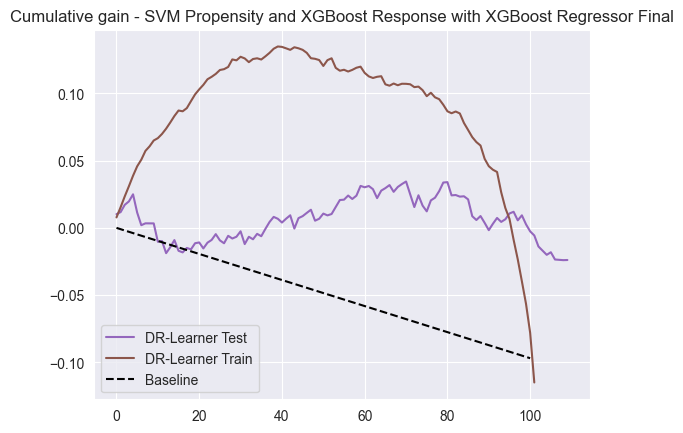

Iteration 6 for SVM Propensity and XGBoost Response with XGBoost Regressor Final


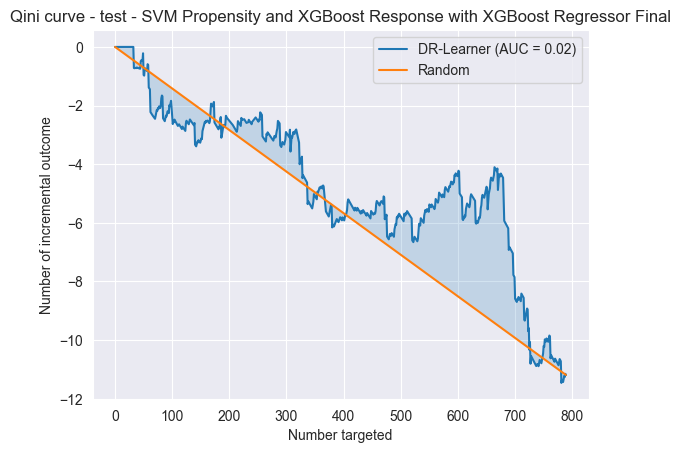

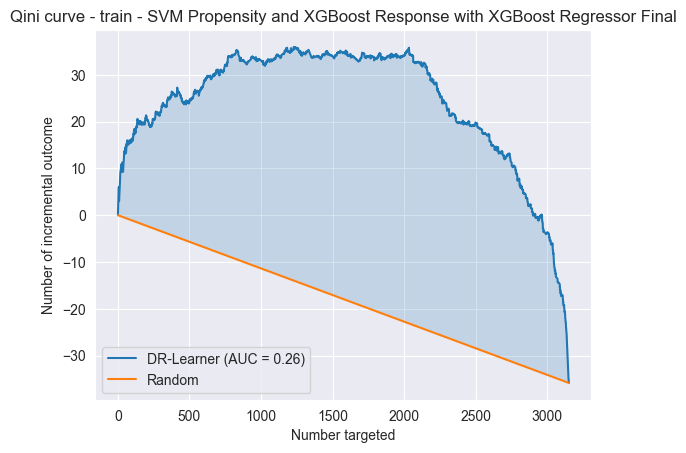

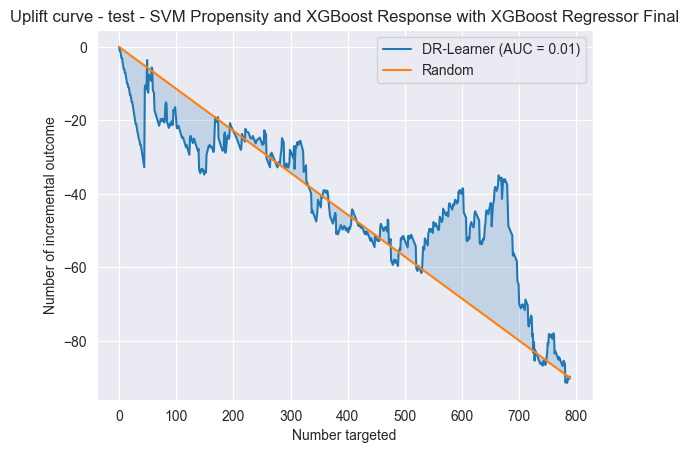

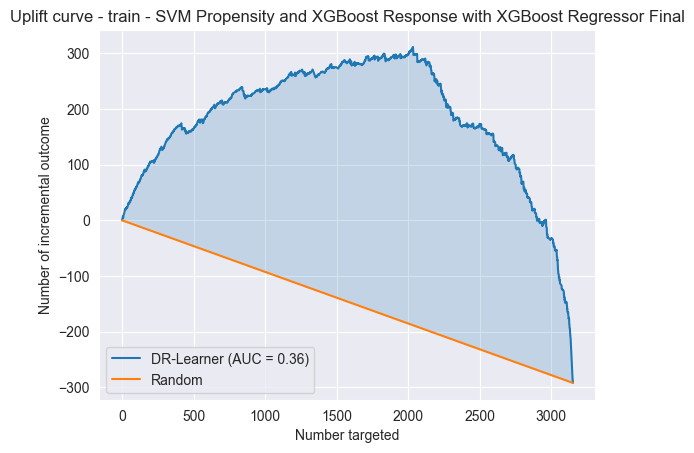

invalid value encountered in scalar divide


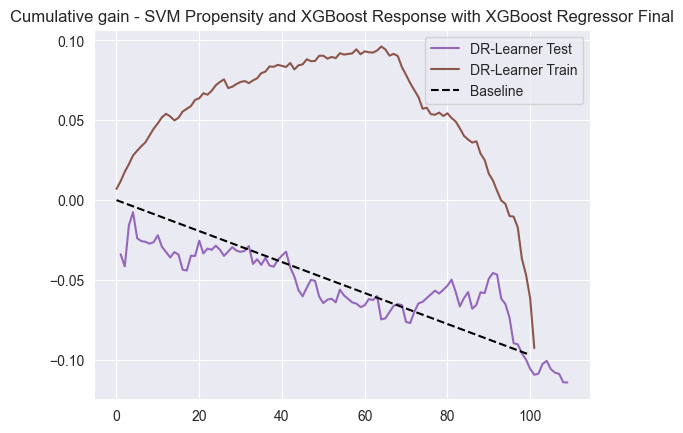

Iteration 7 for SVM Propensity and XGBoost Response with XGBoost Regressor Final


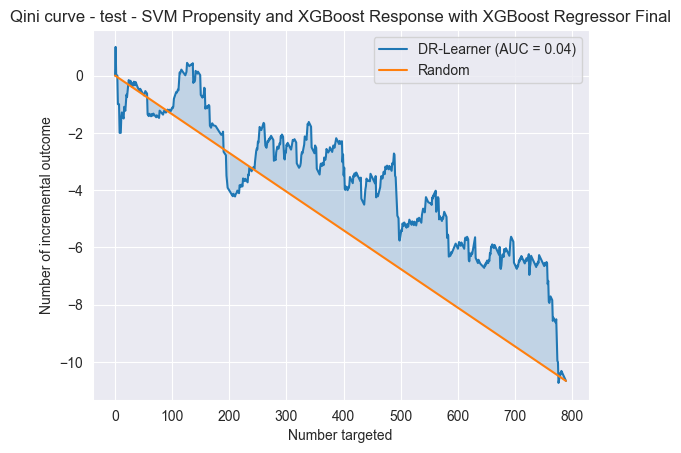

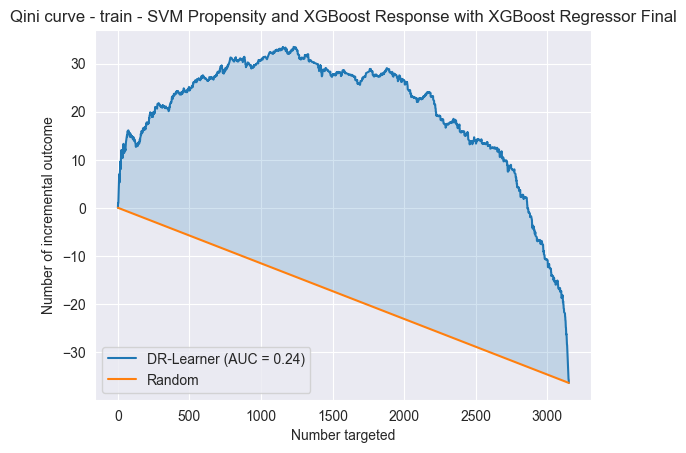

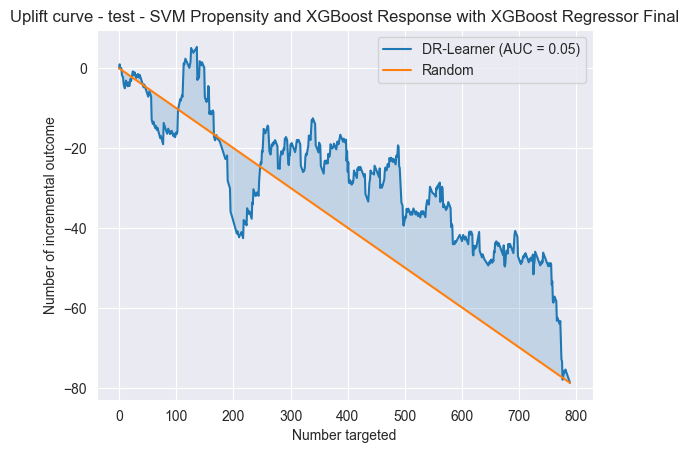

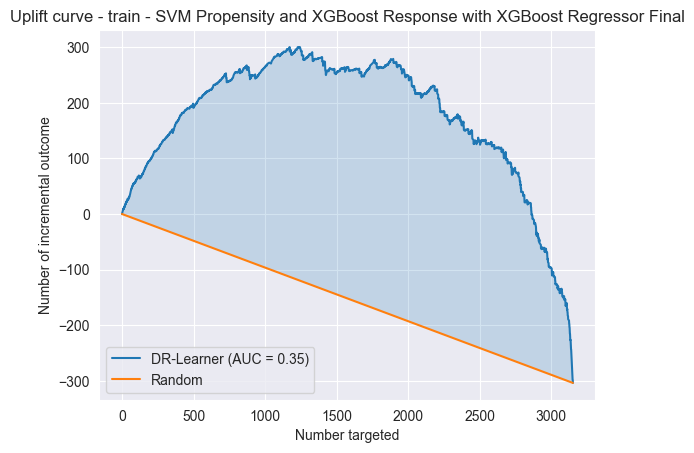

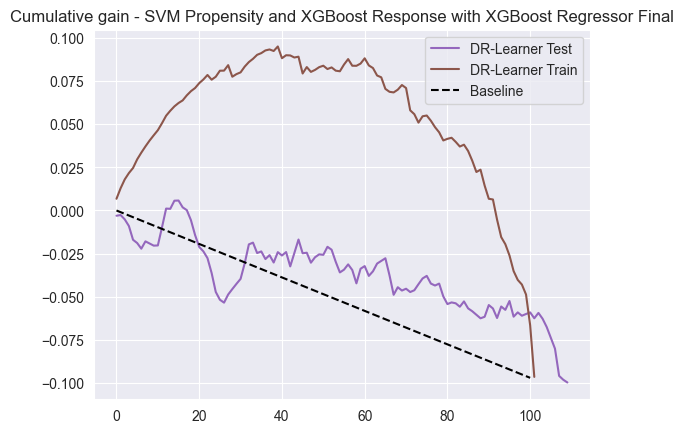

Iteration 8 for SVM Propensity and XGBoost Response with XGBoost Regressor Final


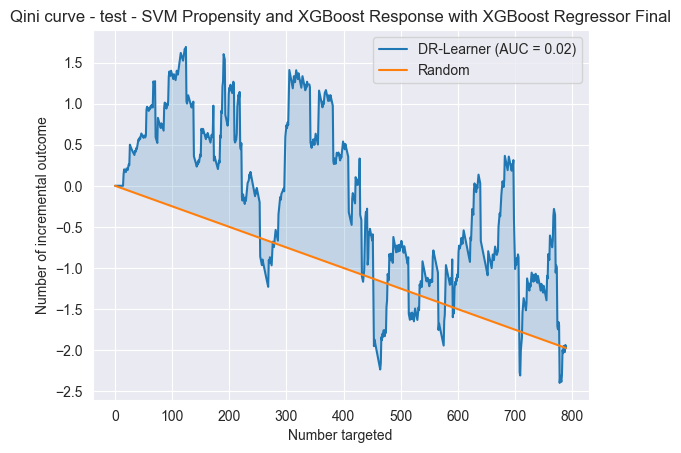

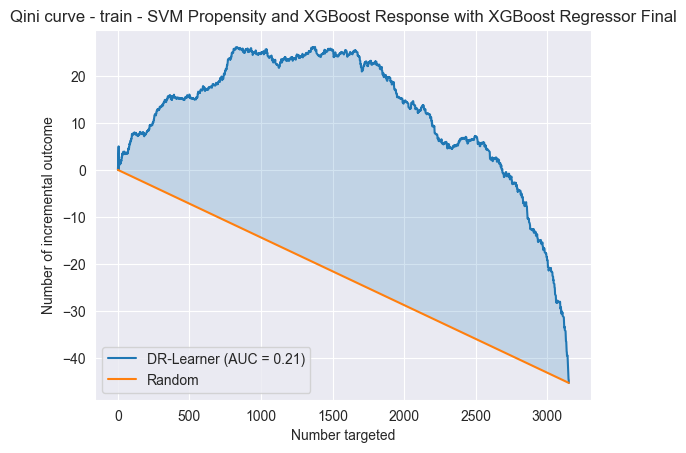

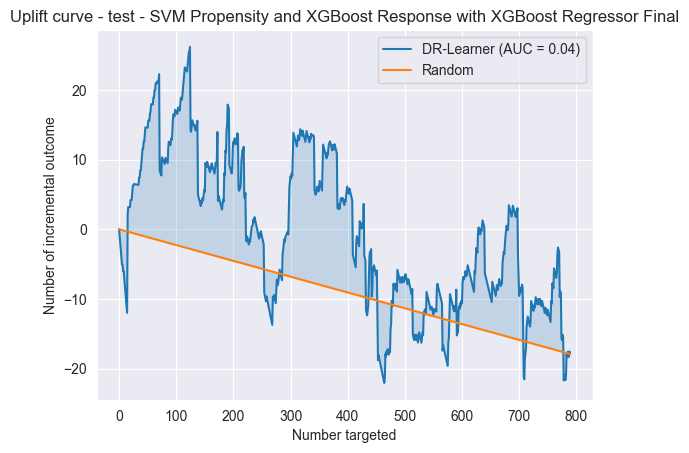

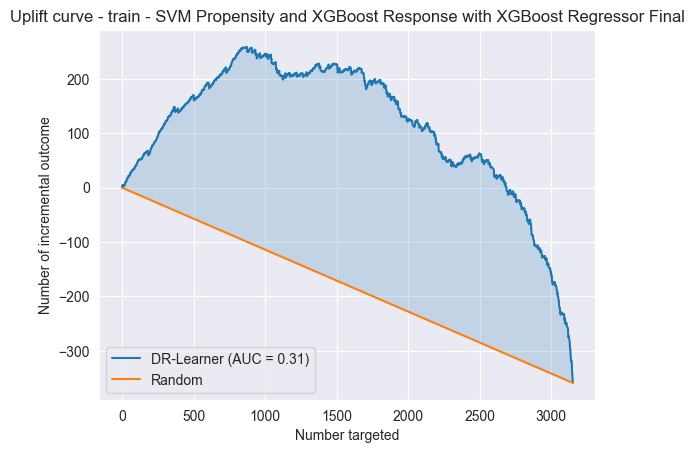

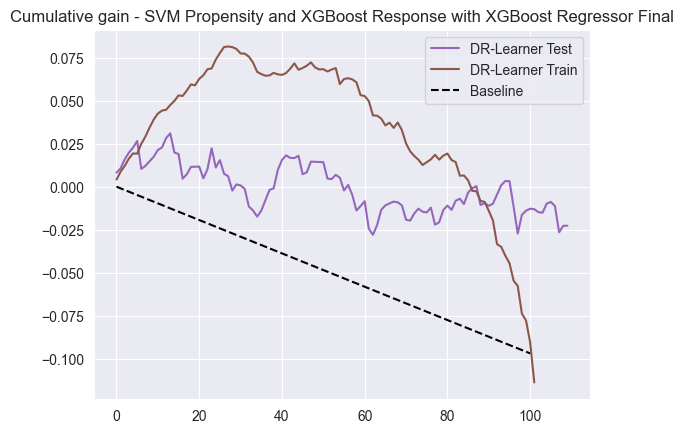

Iteration 9 for SVM Propensity and XGBoost Response with XGBoost Regressor Final


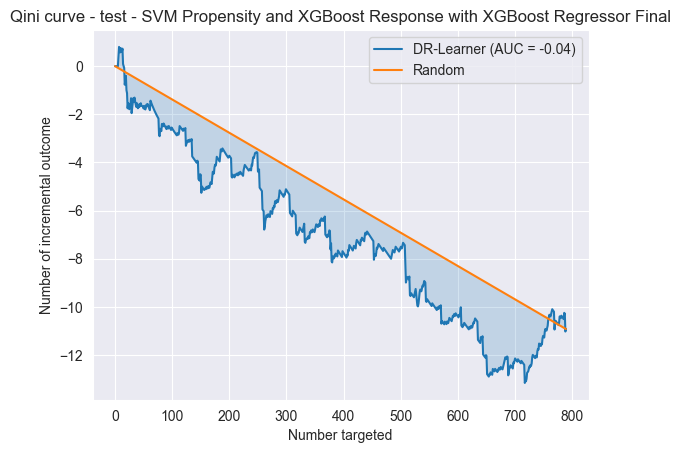

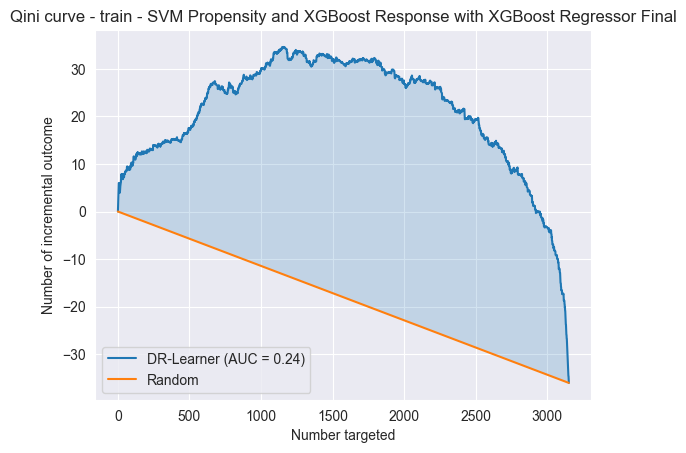

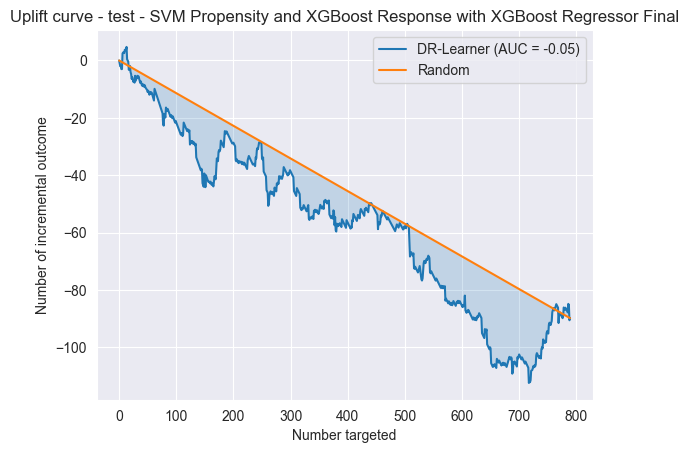

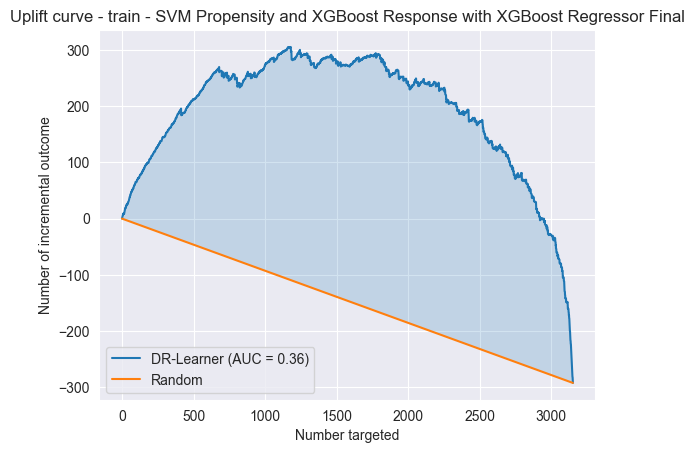

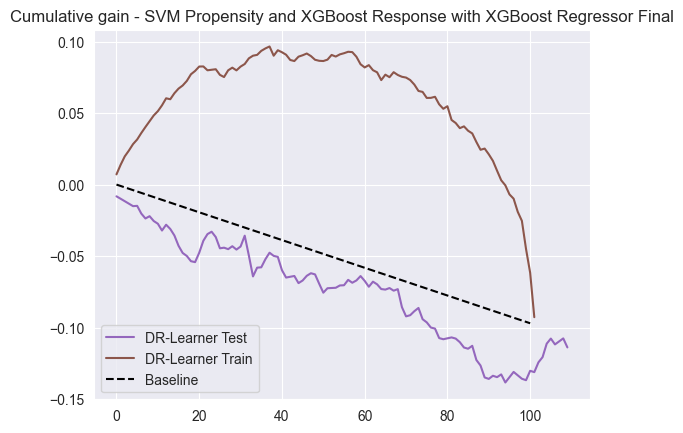

Results for SVM Propensity and XGBoost Response with XGBoost Regressor Final:
Average Train Qini AUC: 0.275965, Average Test Qini AUC: 0.016025
Average Train Uplift AUC: 0.396679, Average Test Uplift AUC: 0.021367

Iteration 0 for SVM Propensity and Logistic Regression Response with XGBoost Regressor Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


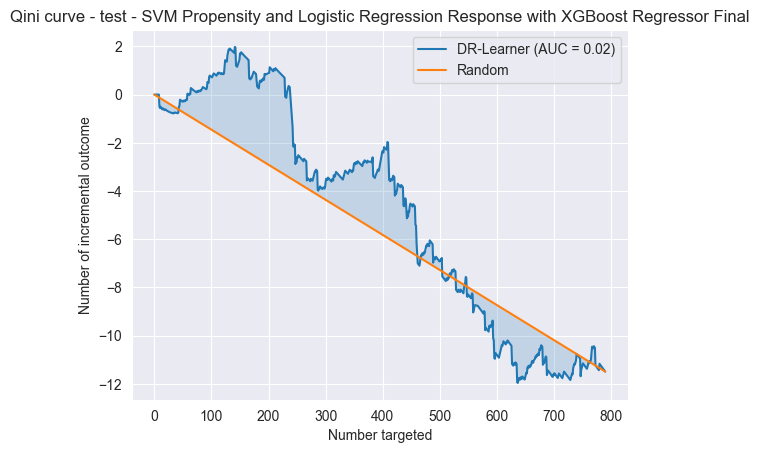

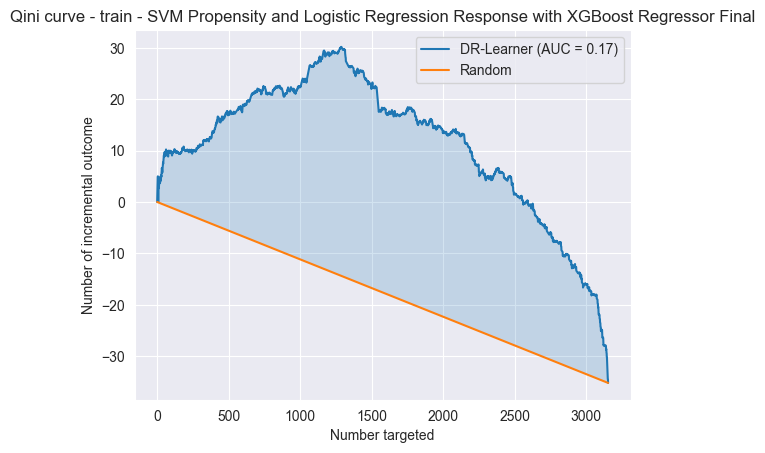

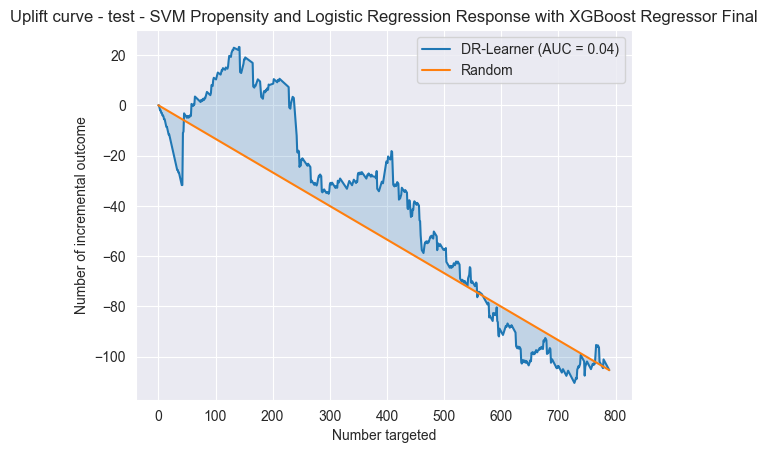

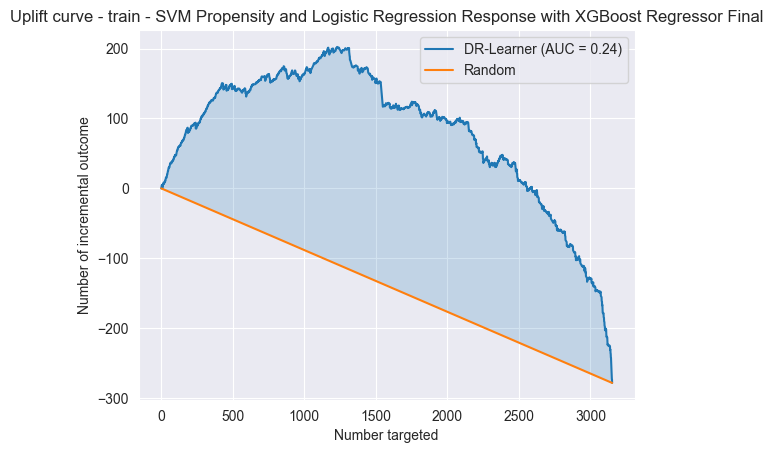

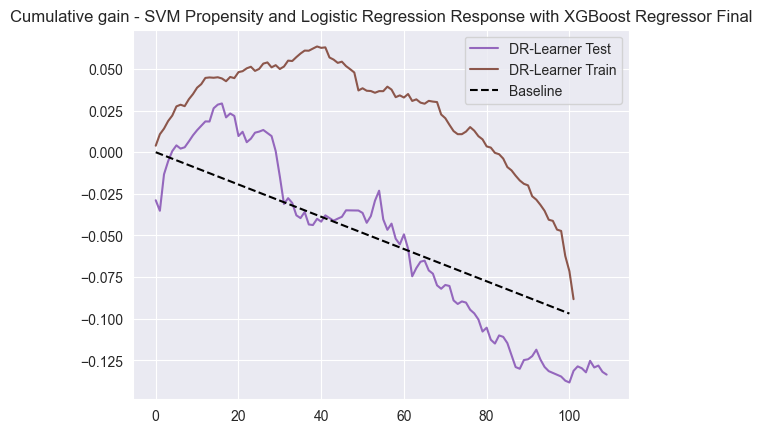

Iteration 1 for SVM Propensity and Logistic Regression Response with XGBoost Regressor Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


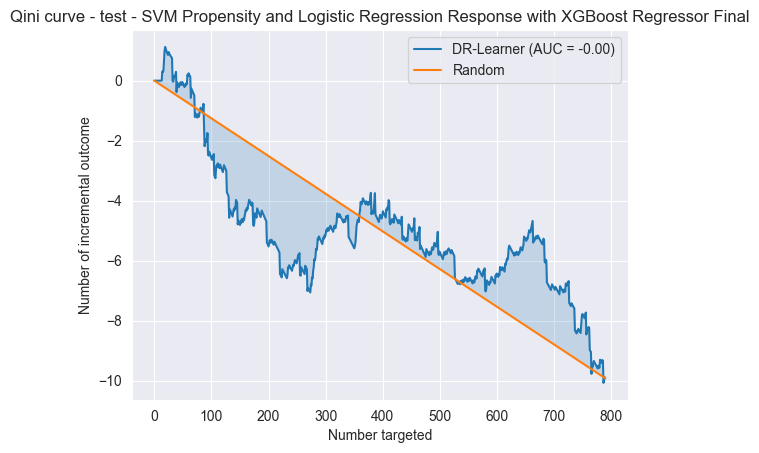

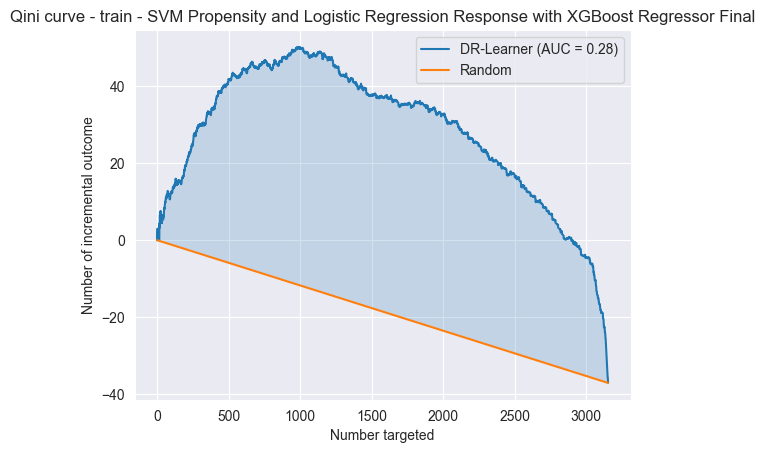

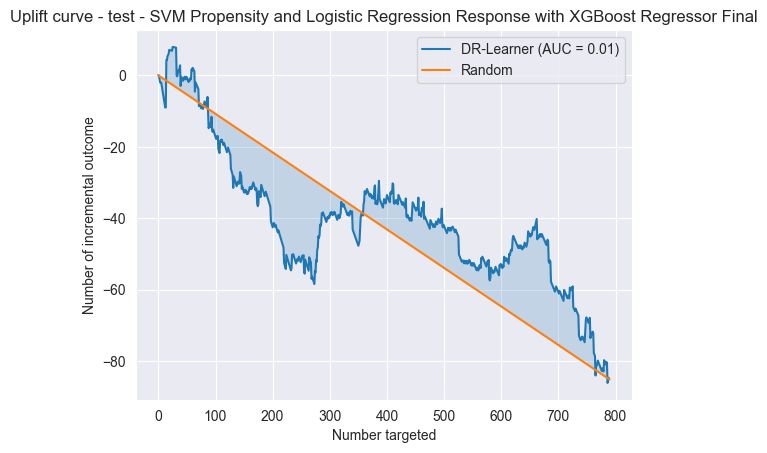

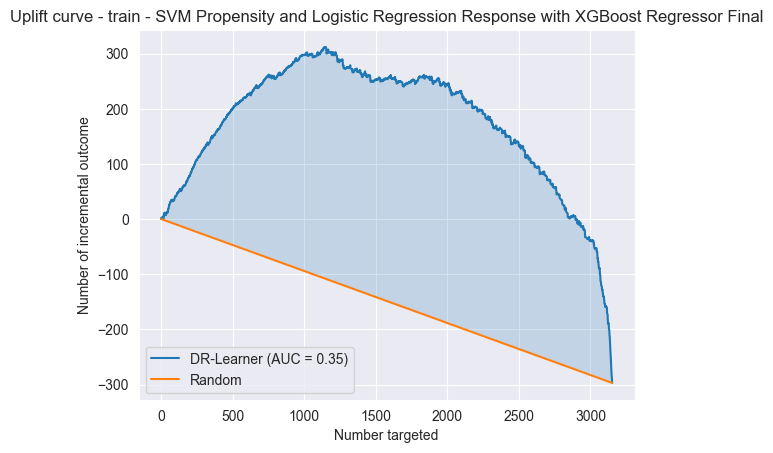

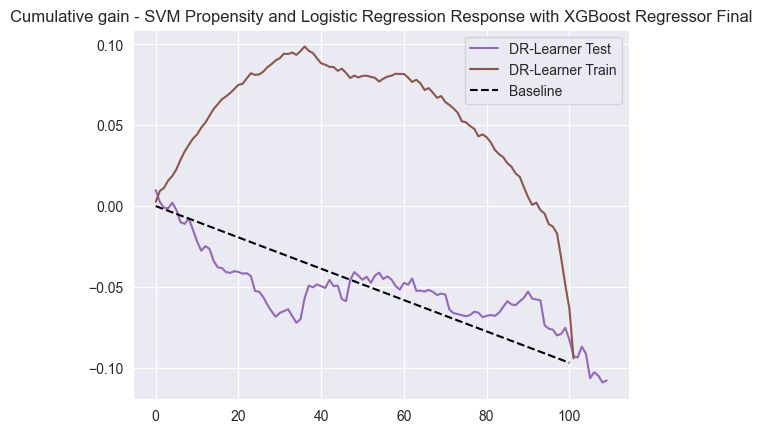

Iteration 2 for SVM Propensity and Logistic Regression Response with XGBoost Regressor Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


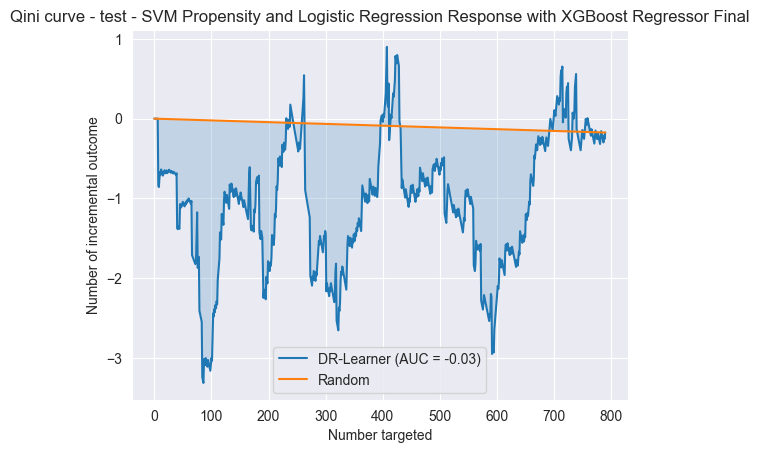

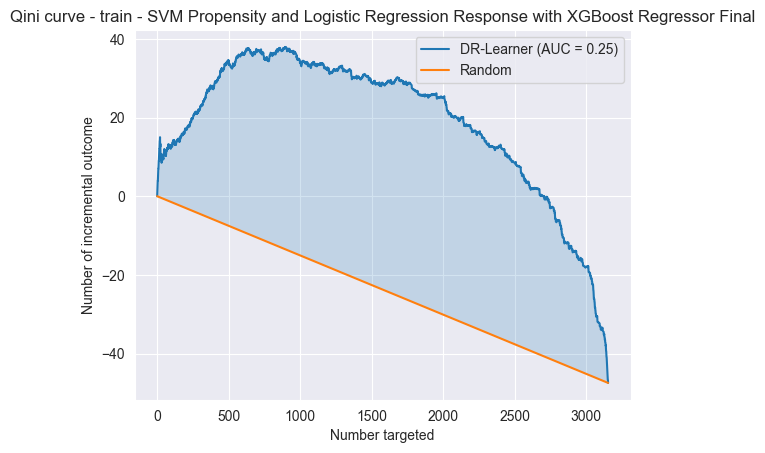

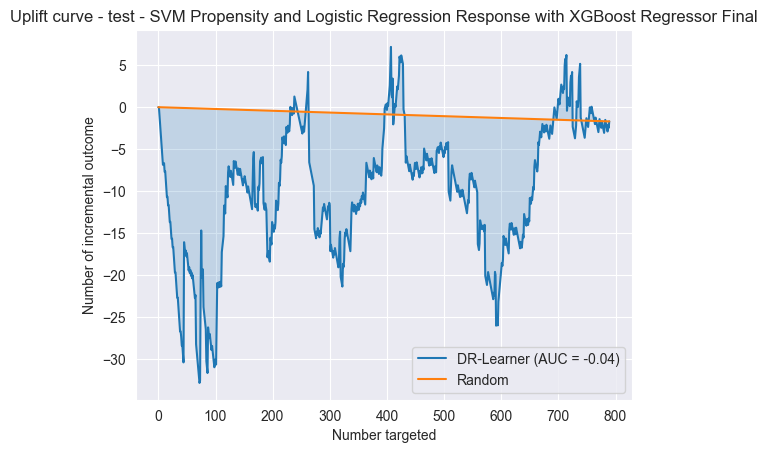

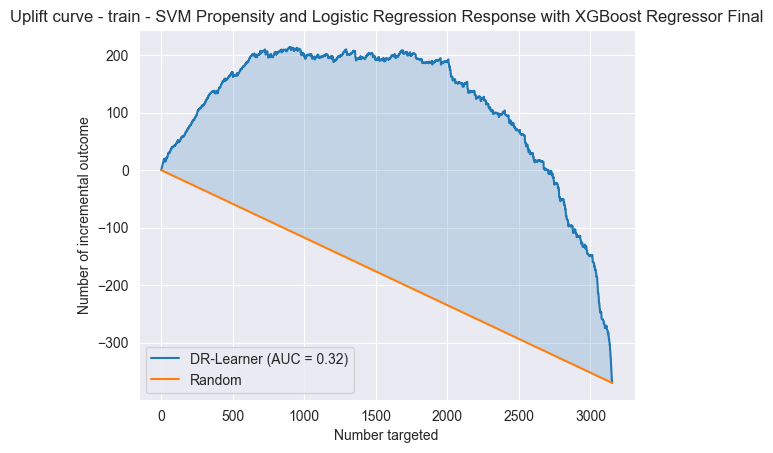

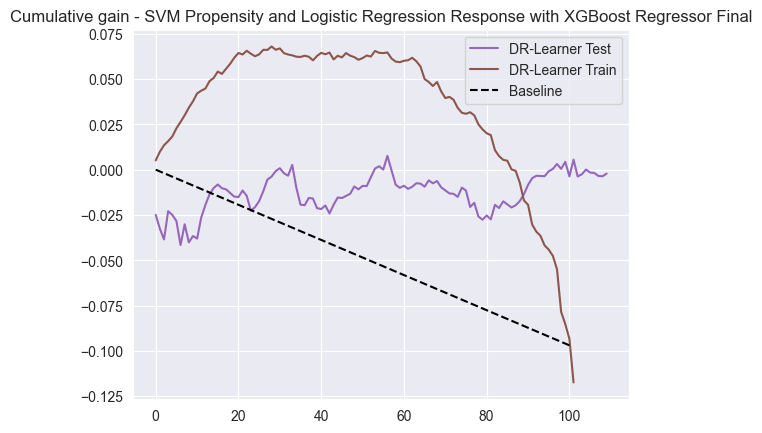

Iteration 3 for SVM Propensity and Logistic Regression Response with XGBoost Regressor Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


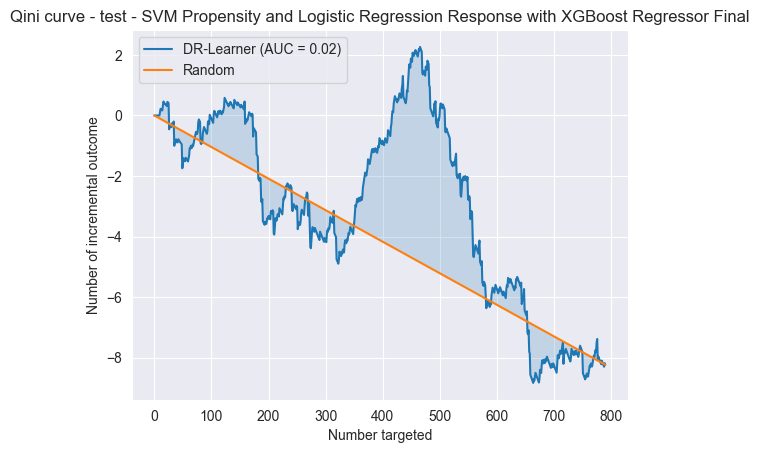

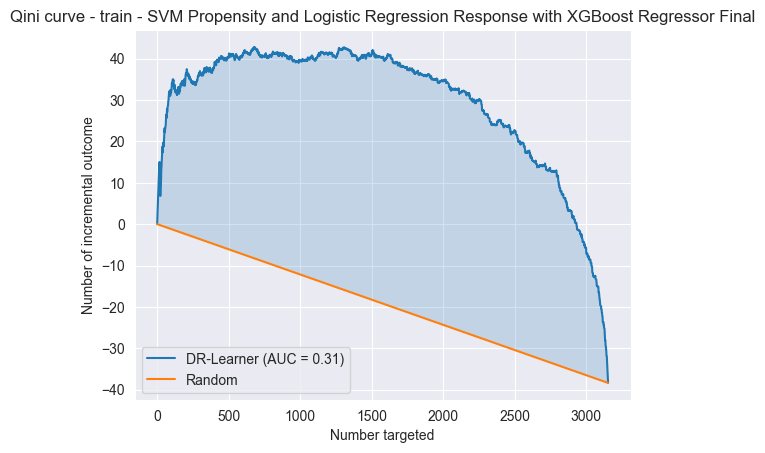

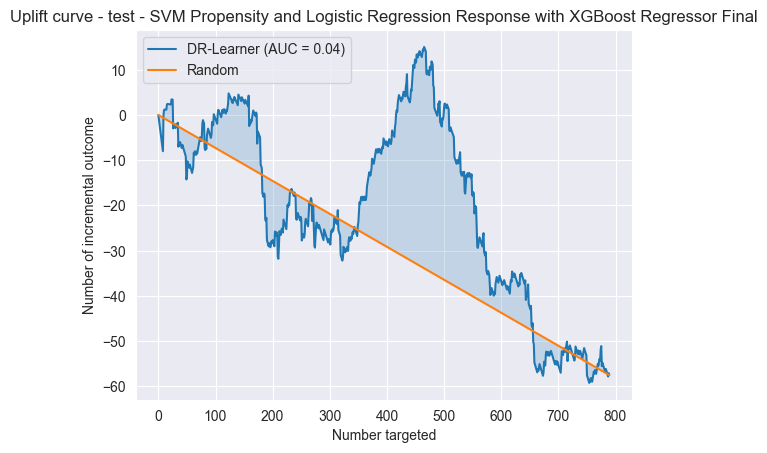

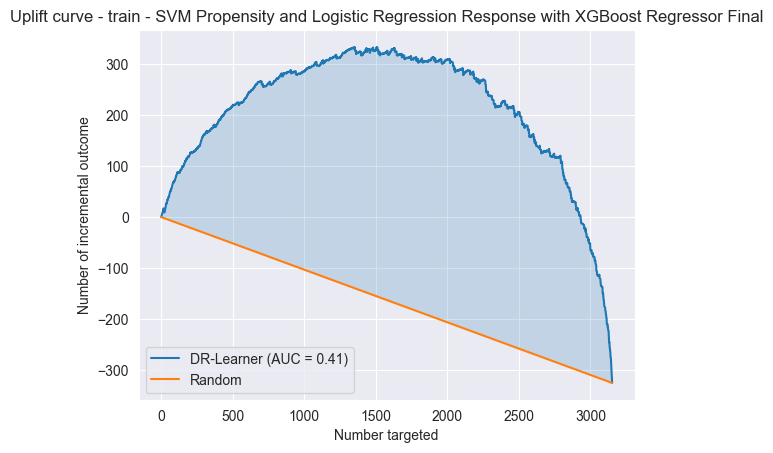

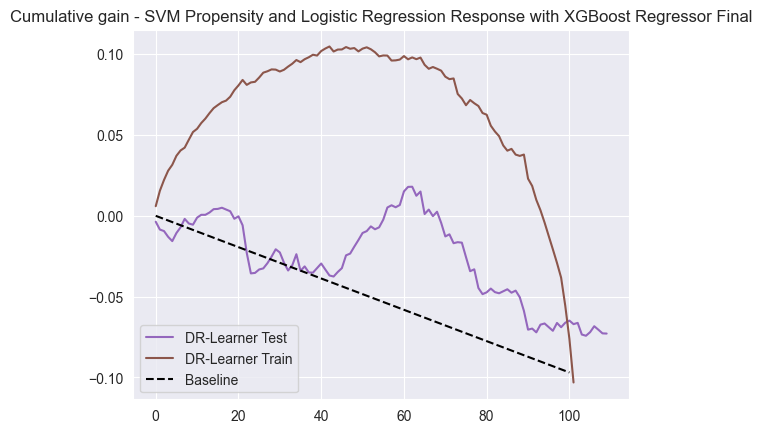

Iteration 4 for SVM Propensity and Logistic Regression Response with XGBoost Regressor Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


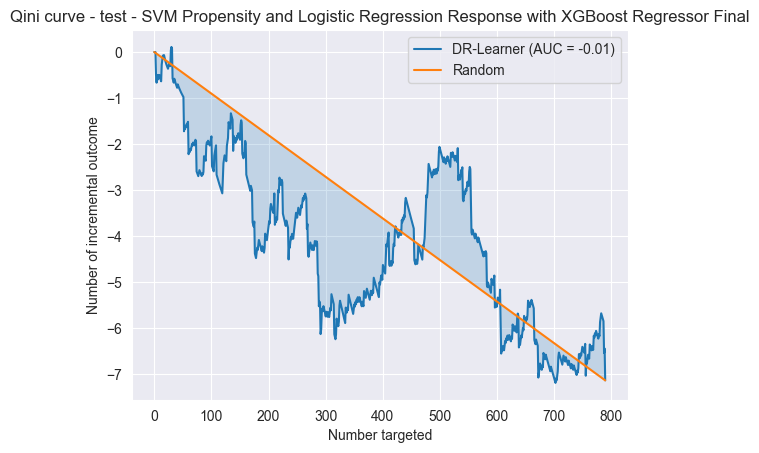

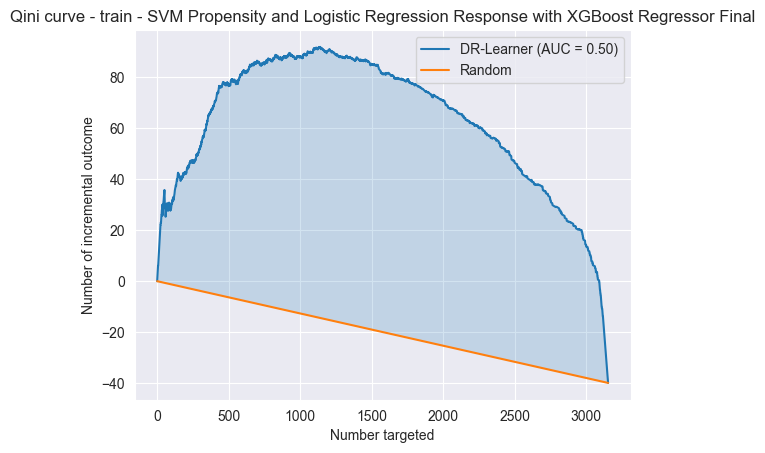

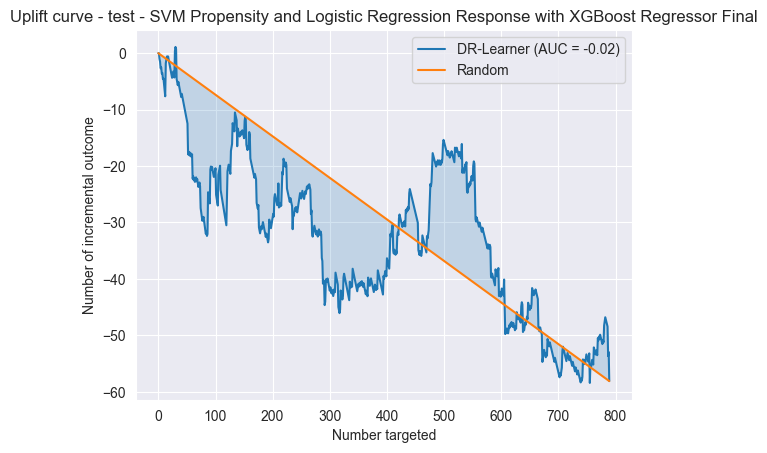

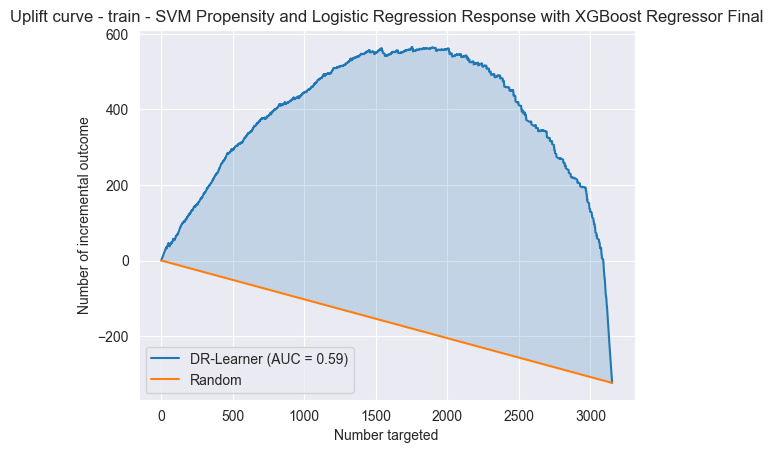

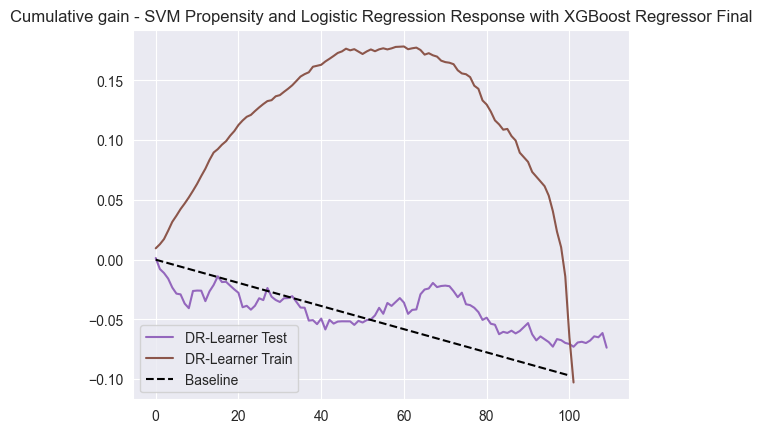

Iteration 5 for SVM Propensity and Logistic Regression Response with XGBoost Regressor Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


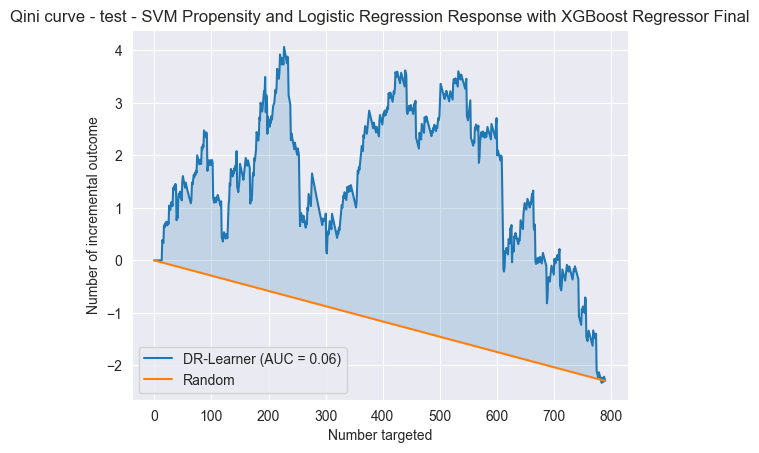

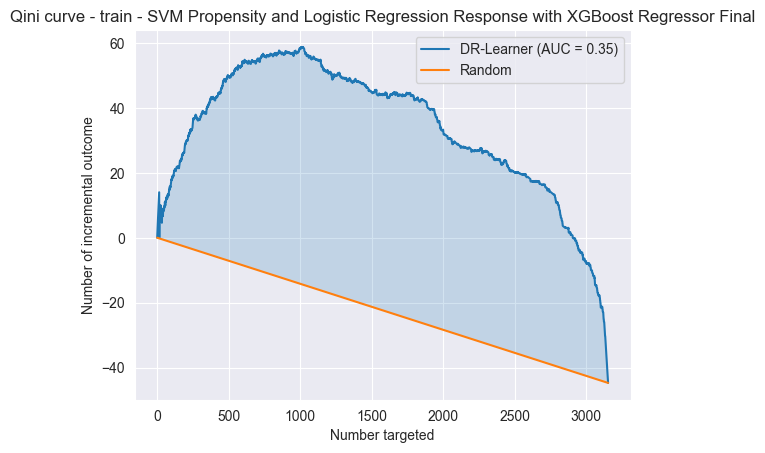

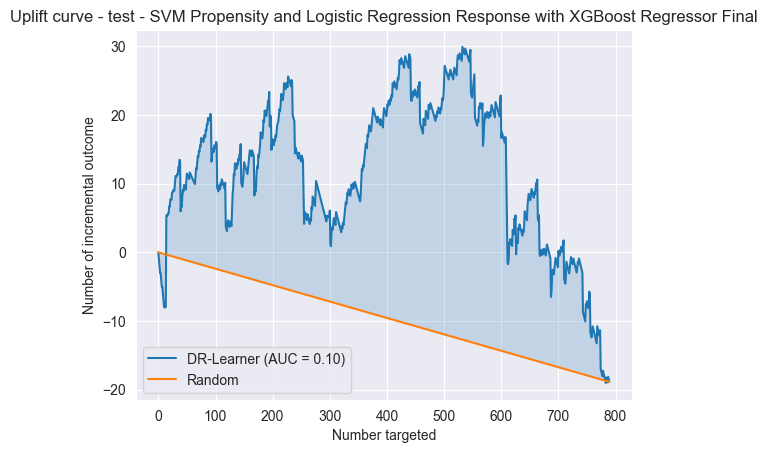

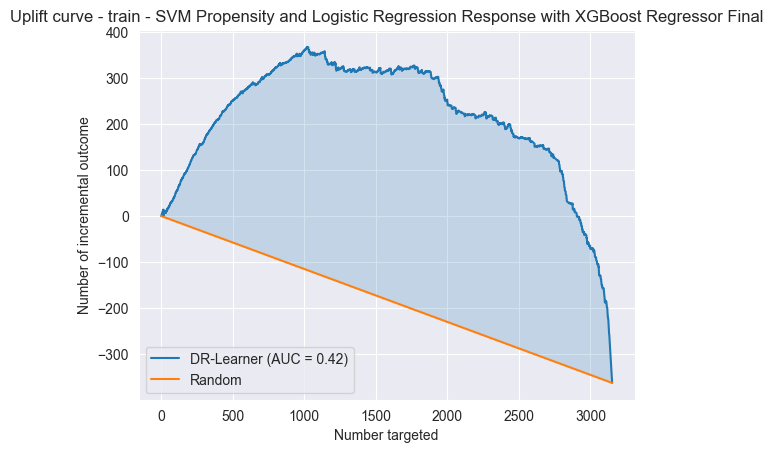

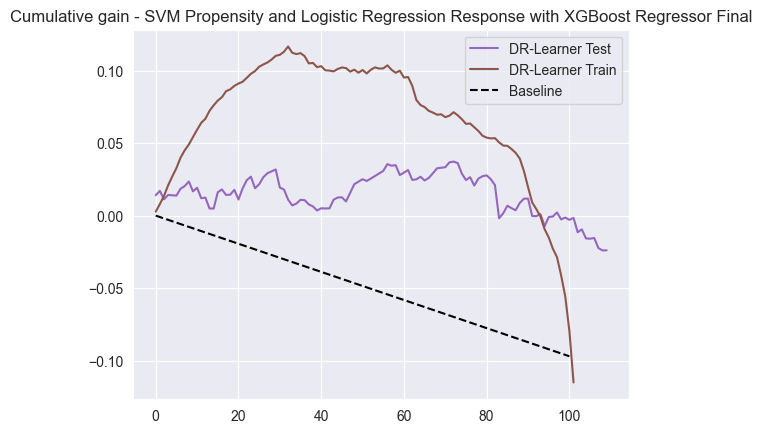

Iteration 6 for SVM Propensity and Logistic Regression Response with XGBoost Regressor Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


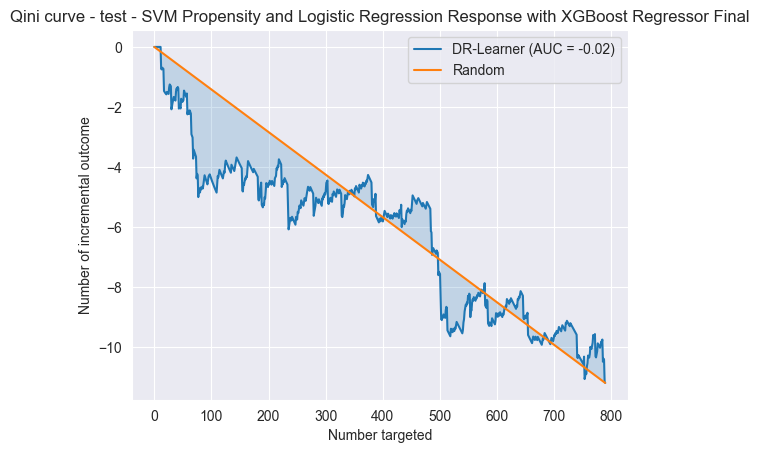

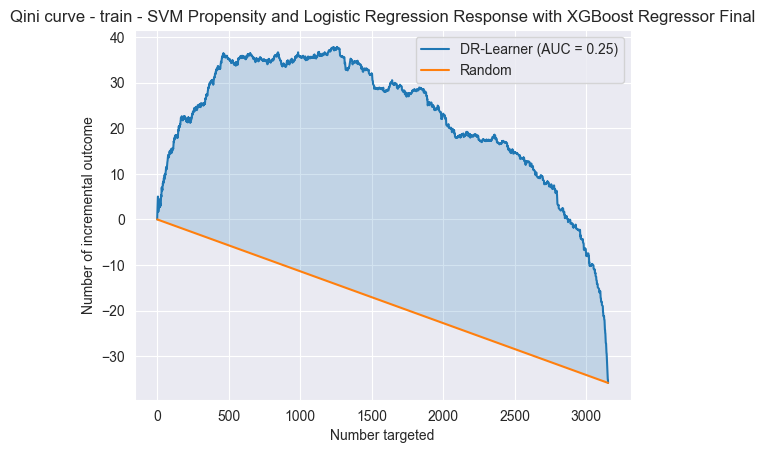

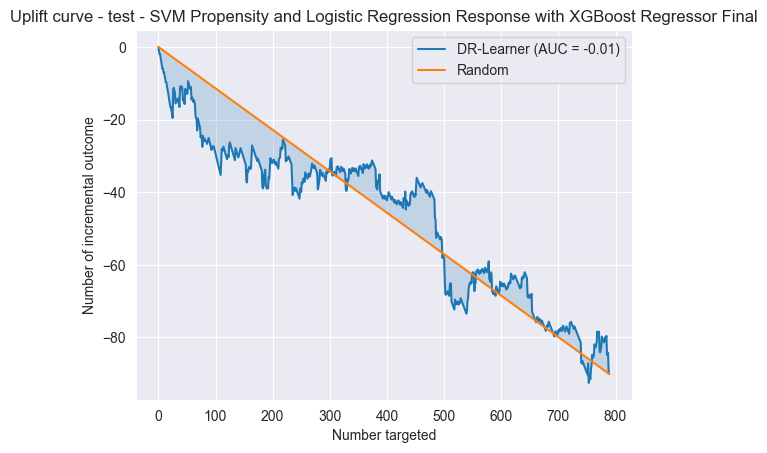

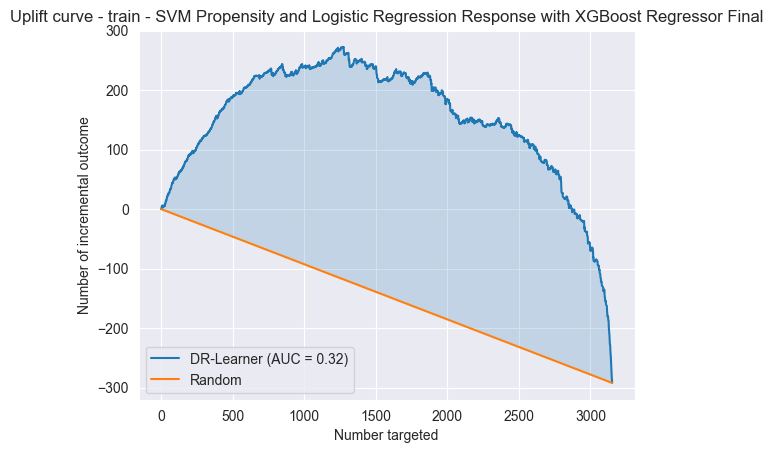

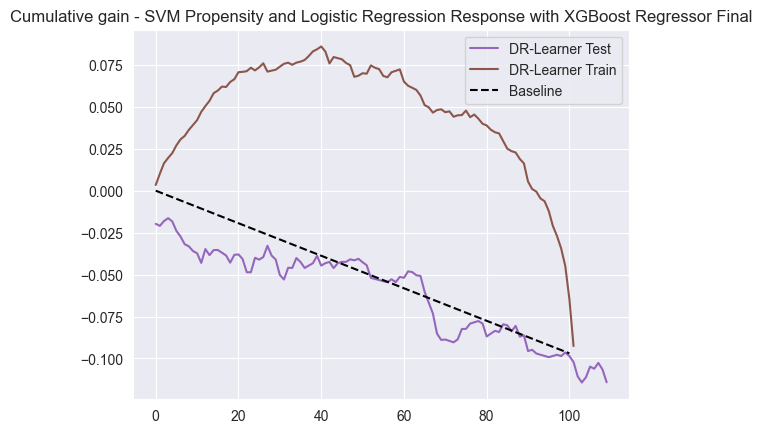

Iteration 7 for SVM Propensity and Logistic Regression Response with XGBoost Regressor Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


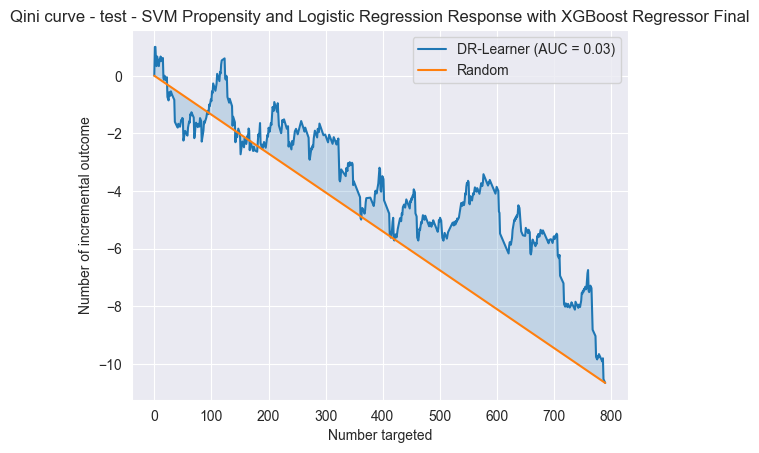

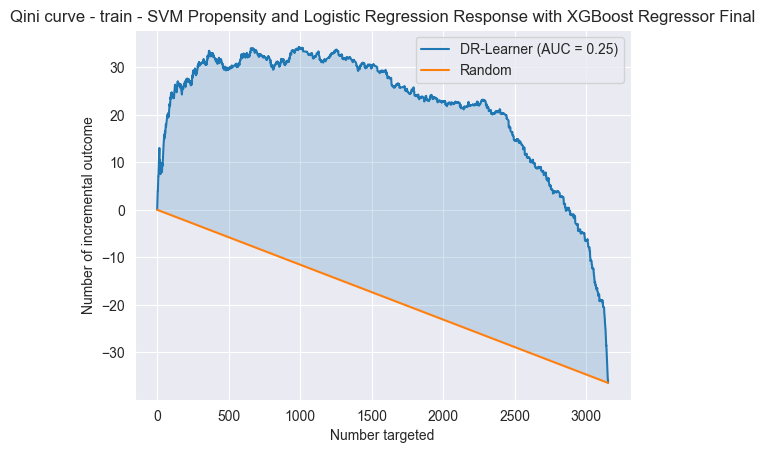

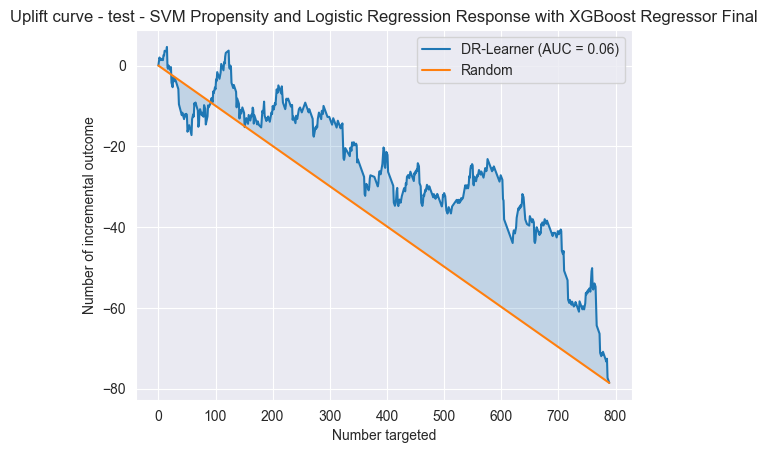

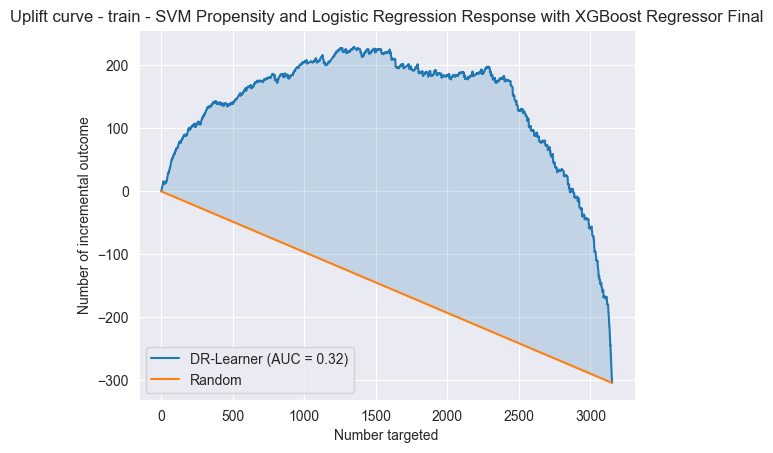

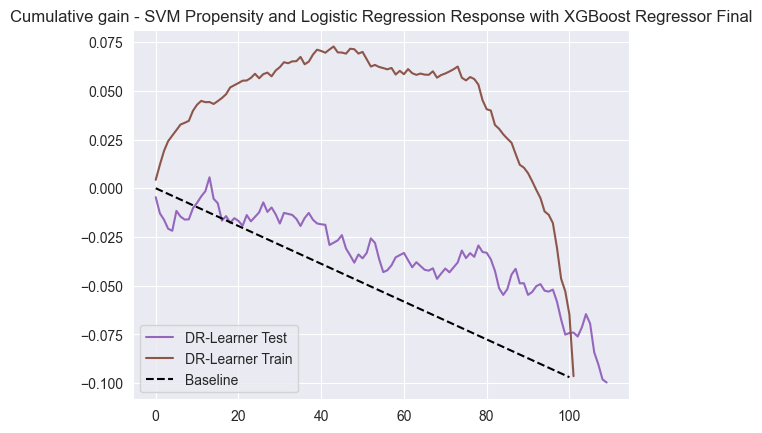

Iteration 8 for SVM Propensity and Logistic Regression Response with XGBoost Regressor Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


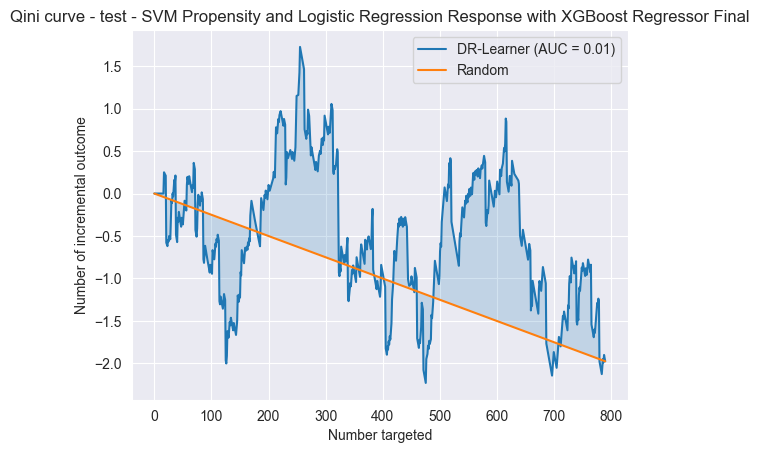

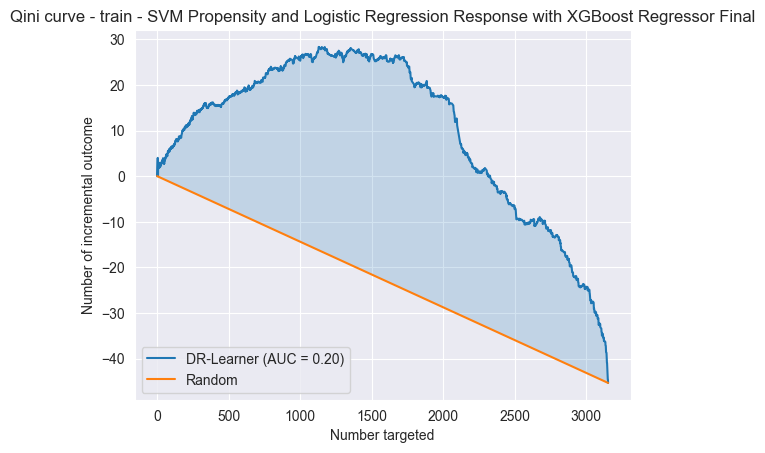

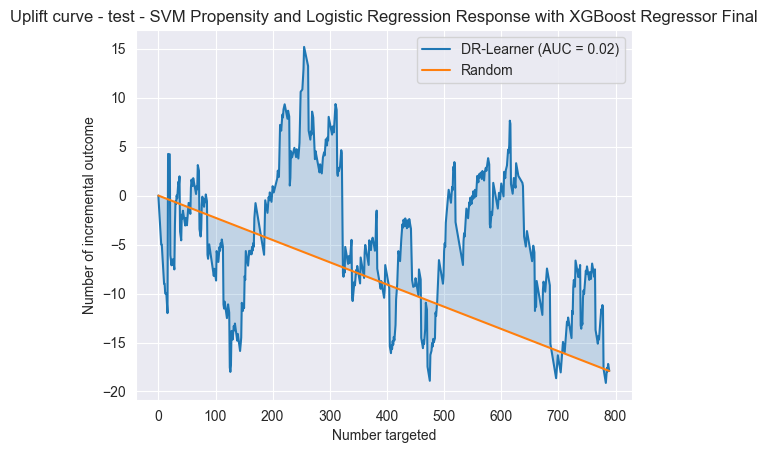

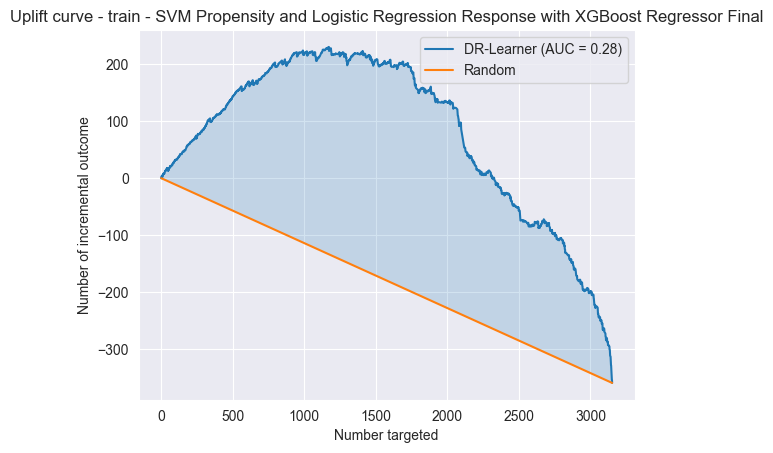

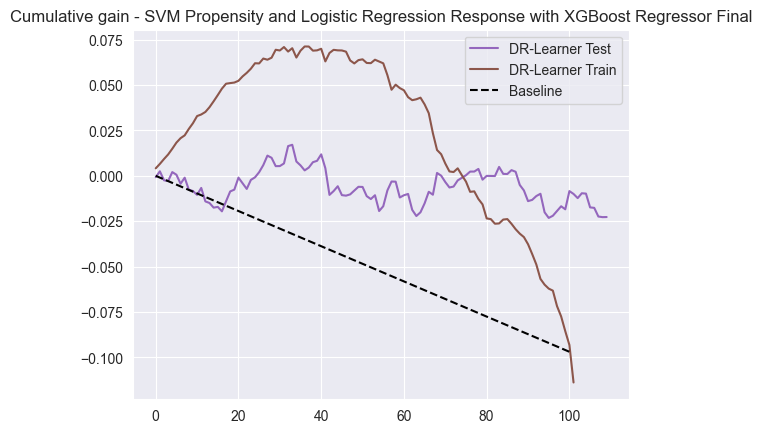

Iteration 9 for SVM Propensity and Logistic Regression Response with XGBoost Regressor Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


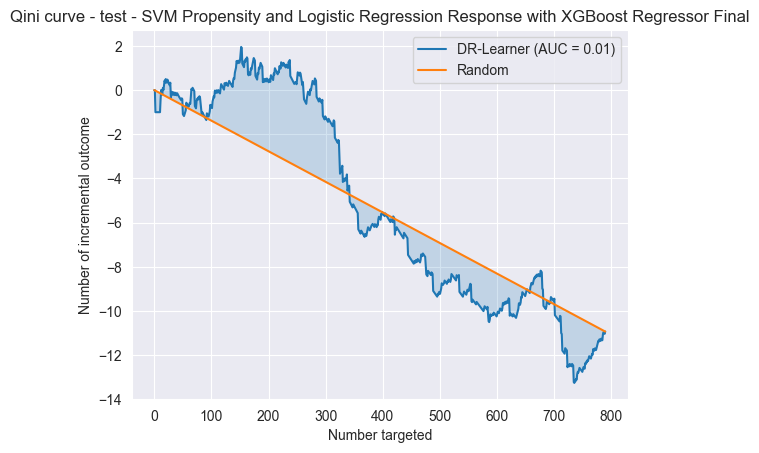

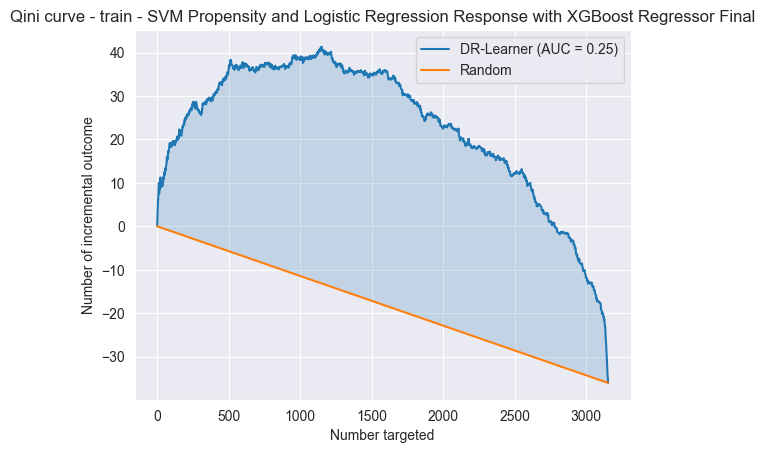

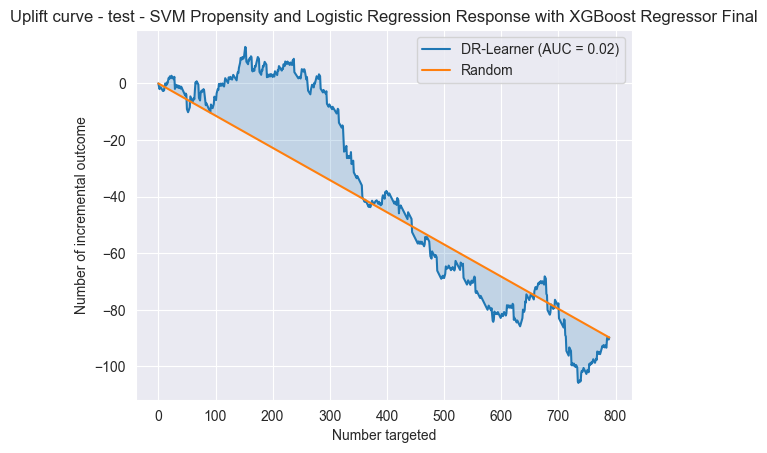

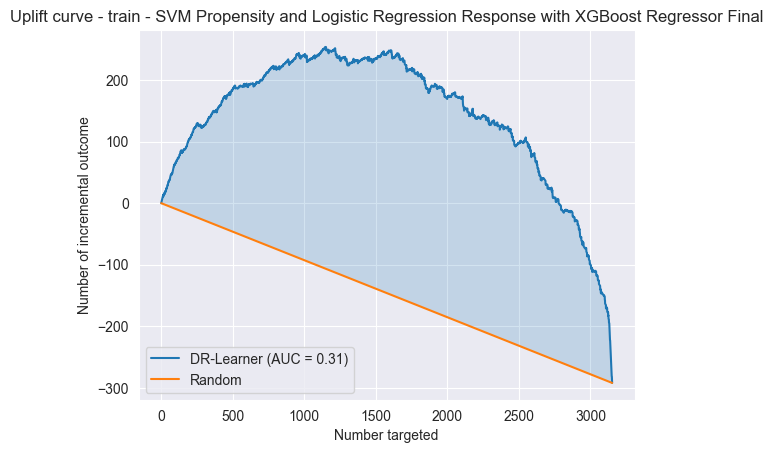

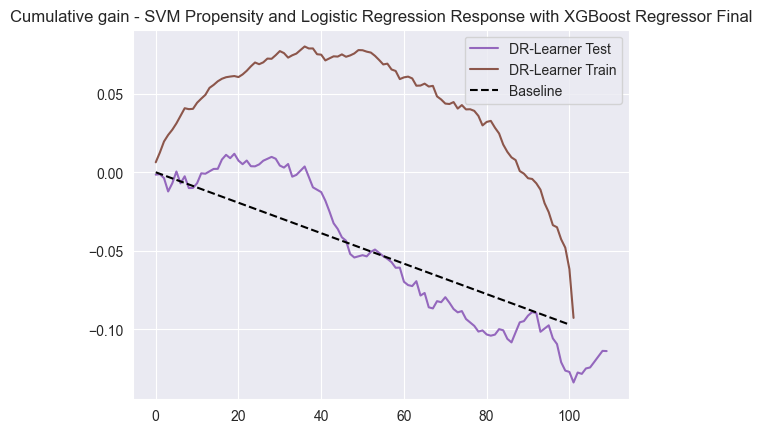

Results for SVM Propensity and Logistic Regression Response with XGBoost Regressor Final:
Average Train Qini AUC: 0.281178, Average Test Qini AUC: 0.010721
Average Train Uplift AUC: 0.355219, Average Test Uplift AUC: 0.022426

Iteration 0 for SVM Propensity and Gradient Boosting Response with XGBoost Regressor Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


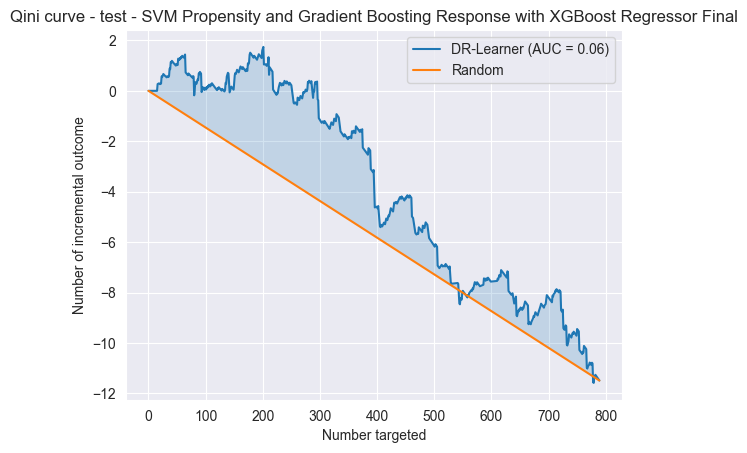

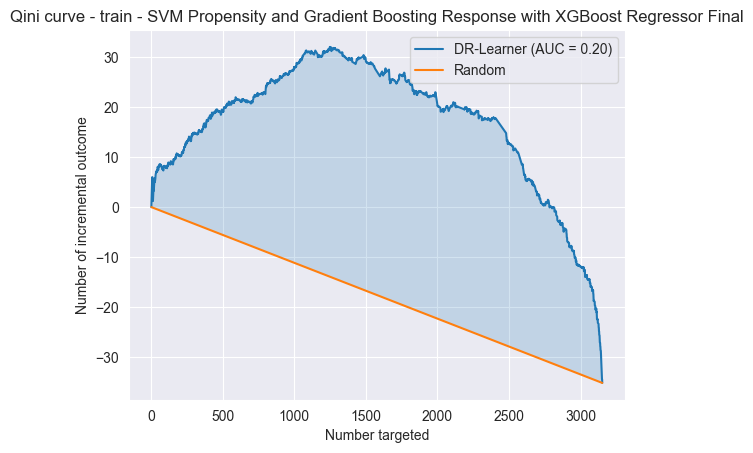

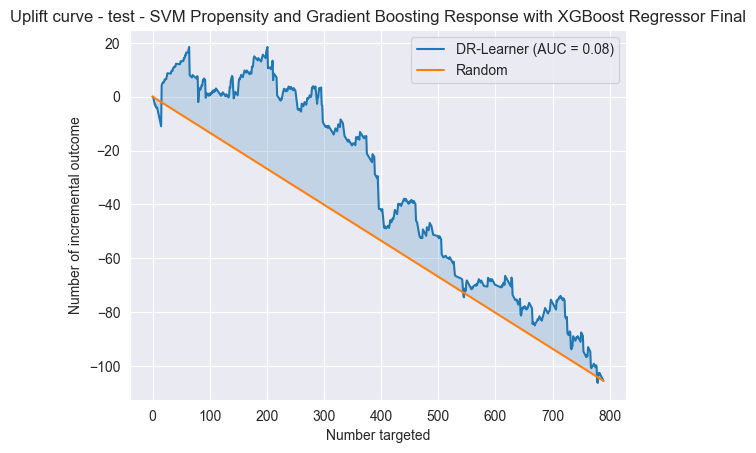

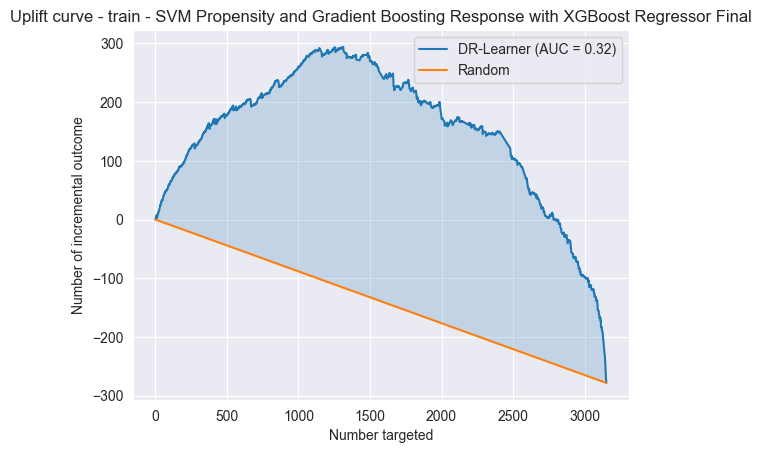

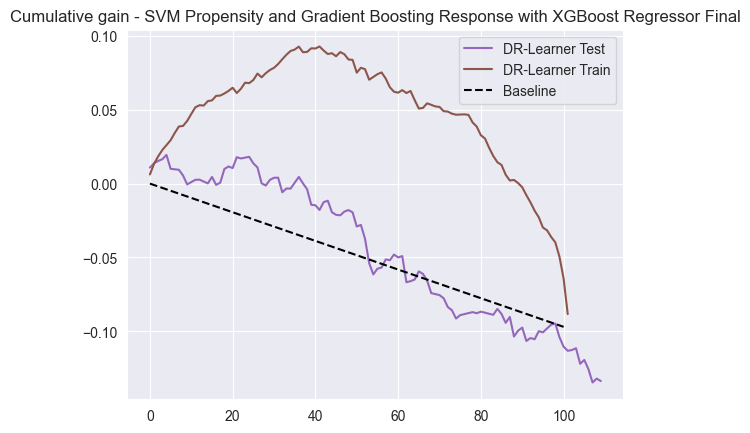

Iteration 1 for SVM Propensity and Gradient Boosting Response with XGBoost Regressor Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


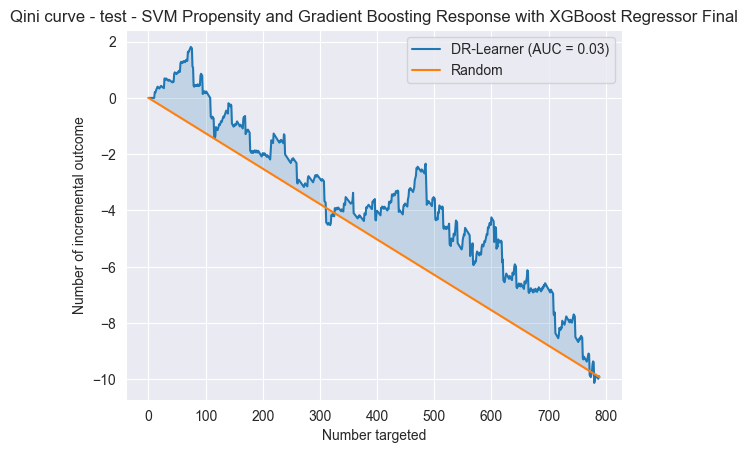

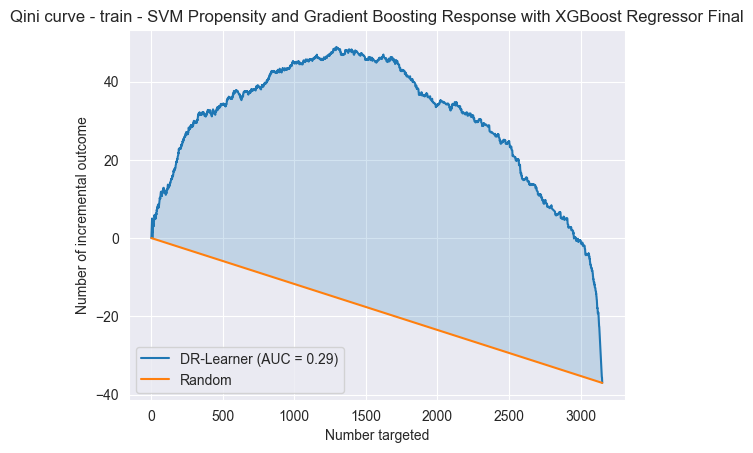

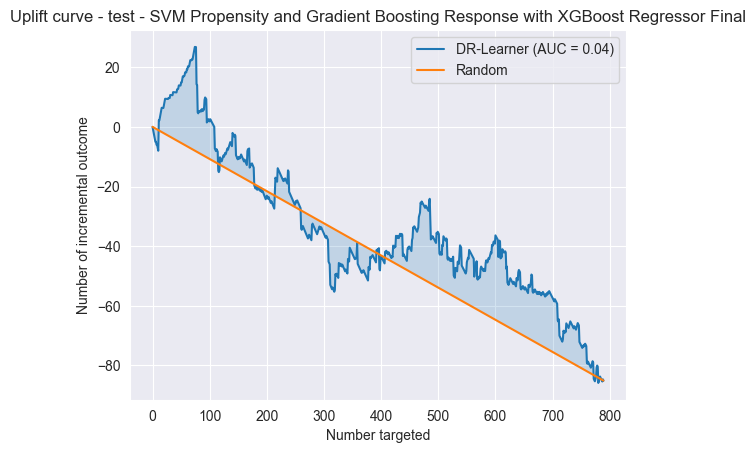

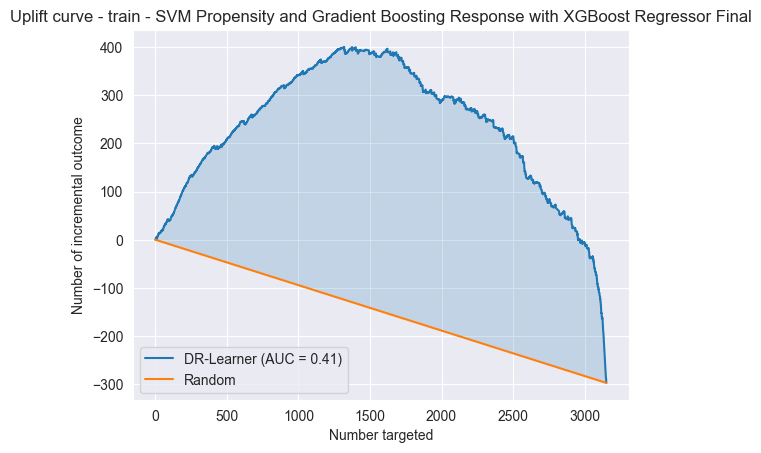

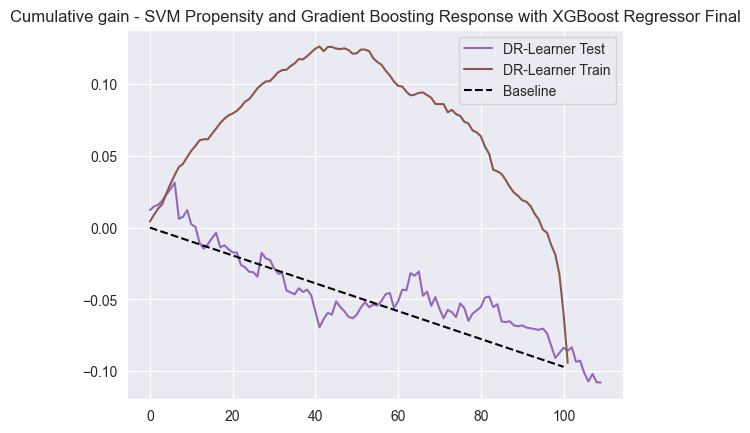

Iteration 2 for SVM Propensity and Gradient Boosting Response with XGBoost Regressor Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


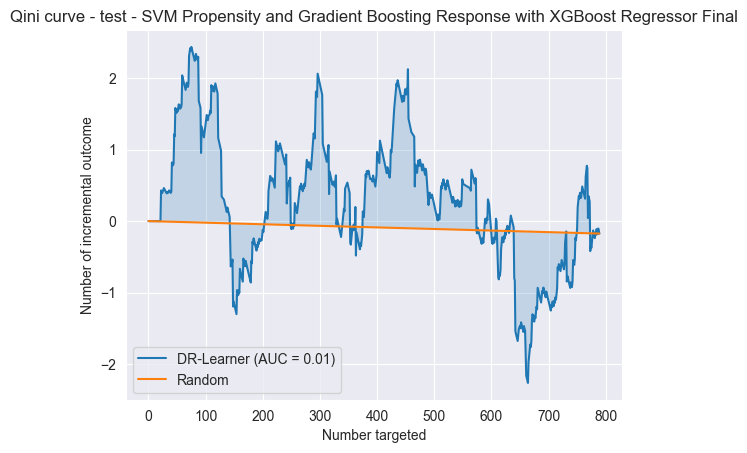

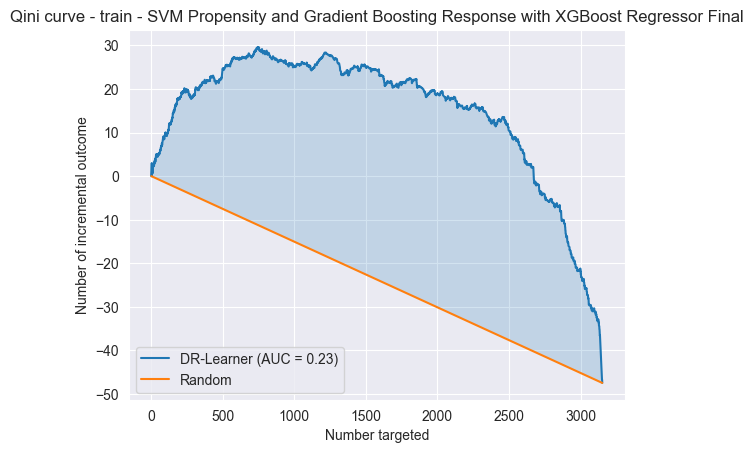

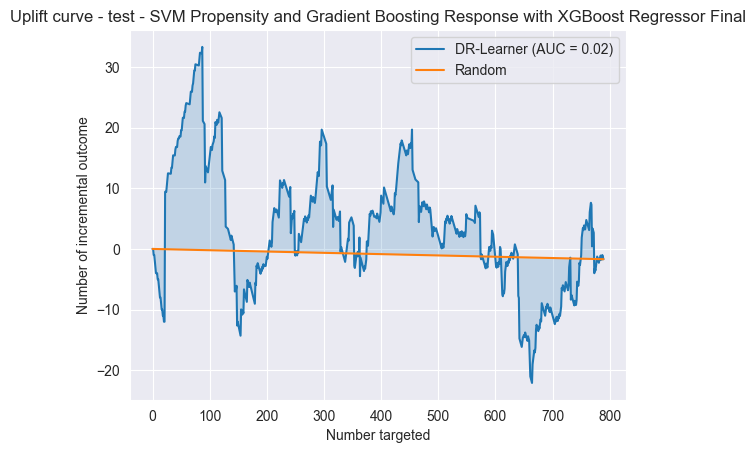

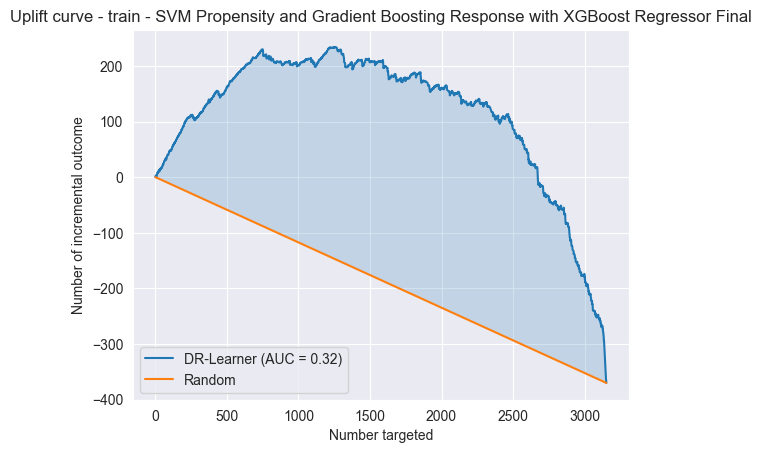

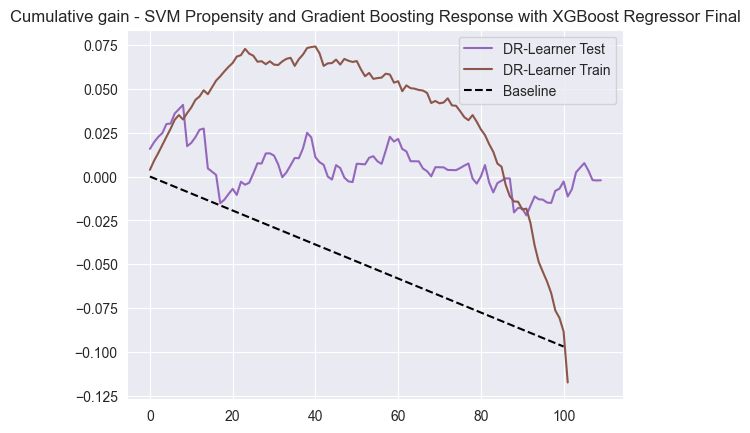

Iteration 3 for SVM Propensity and Gradient Boosting Response with XGBoost Regressor Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


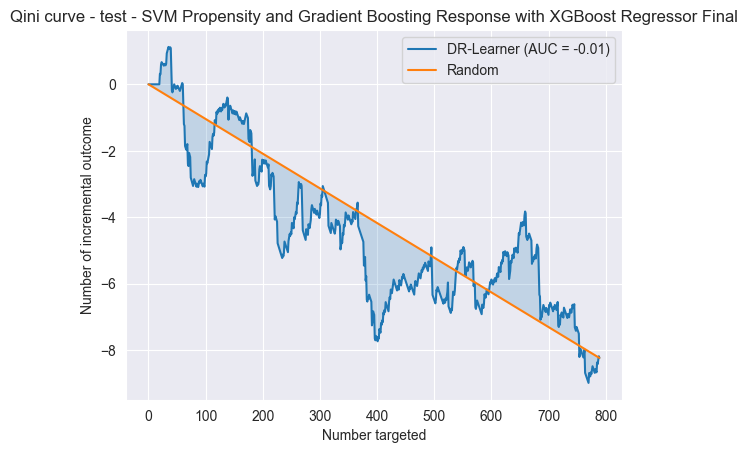

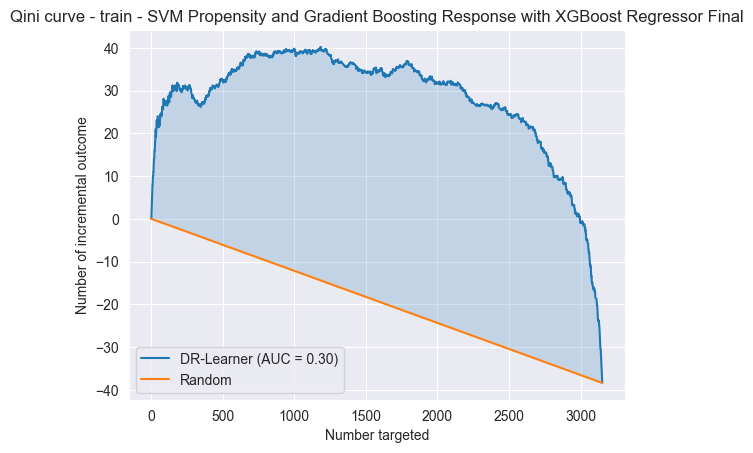

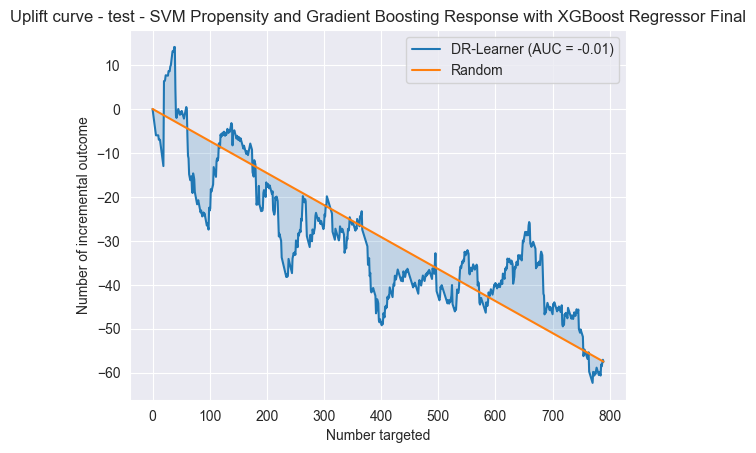

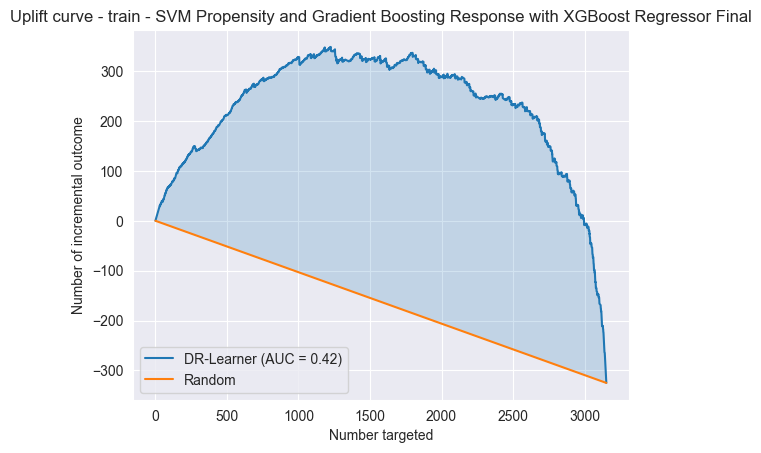

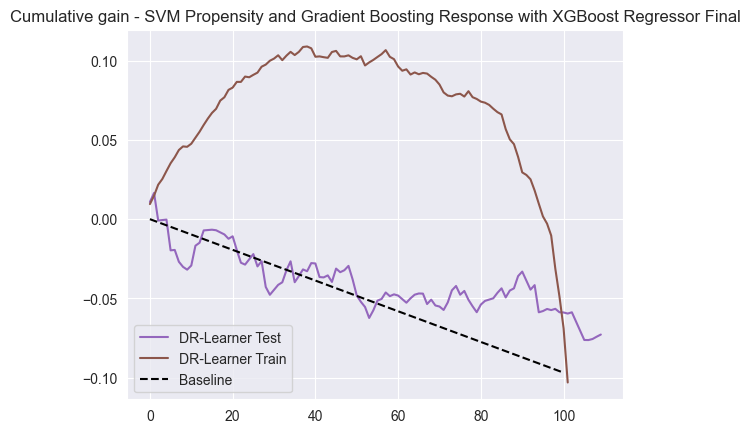

Iteration 4 for SVM Propensity and Gradient Boosting Response with XGBoost Regressor Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


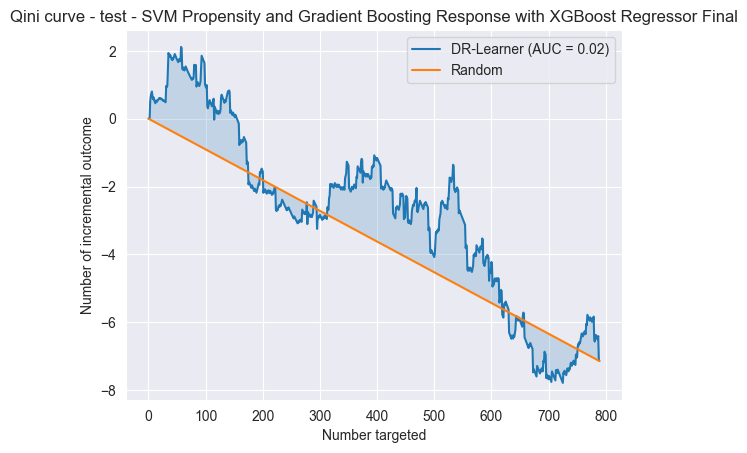

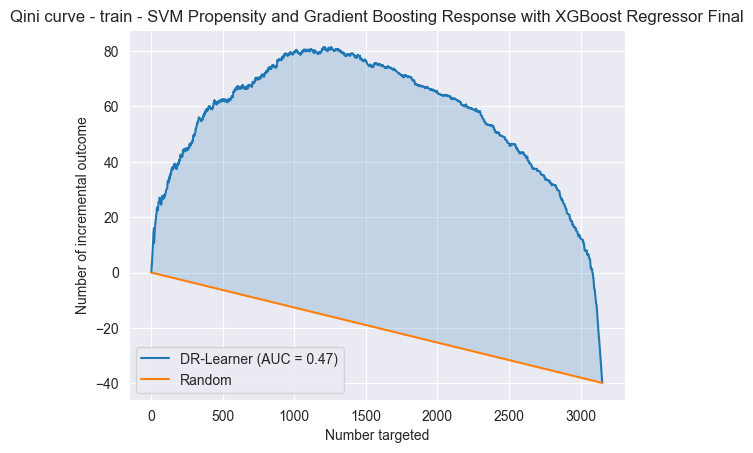

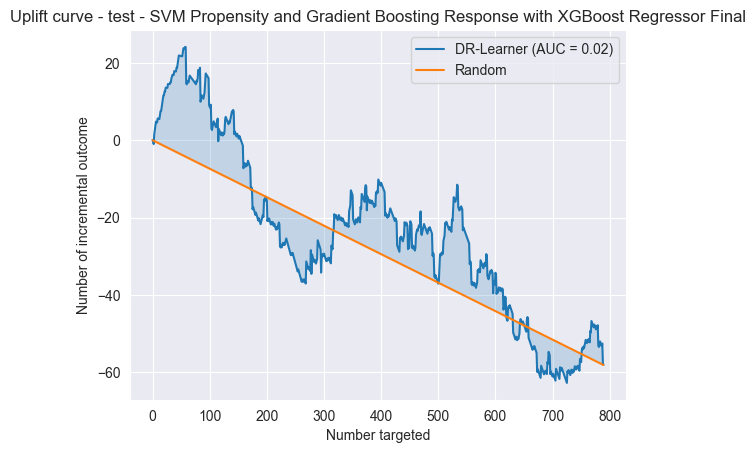

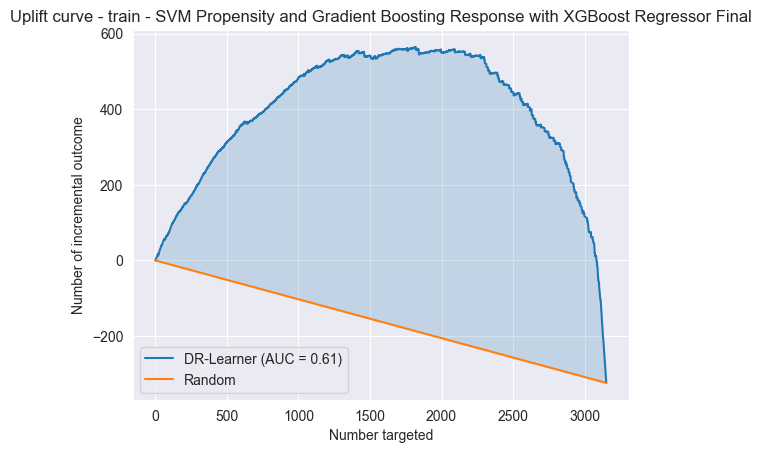

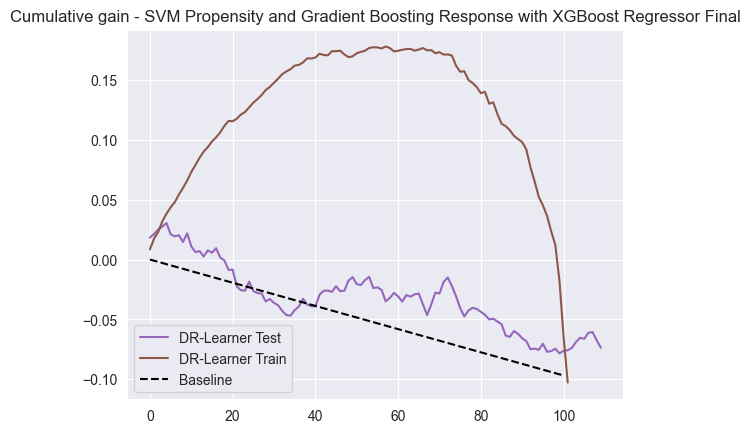

Iteration 5 for SVM Propensity and Gradient Boosting Response with XGBoost Regressor Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


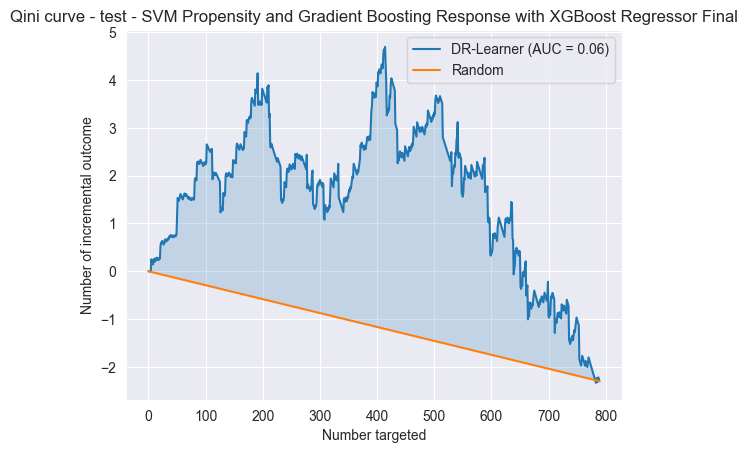

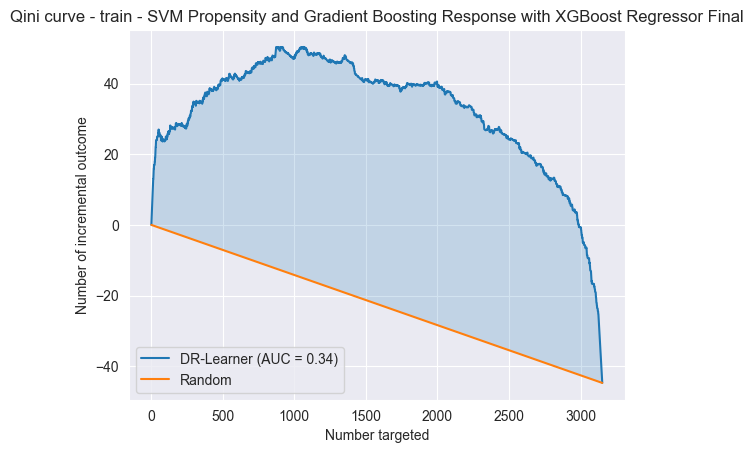

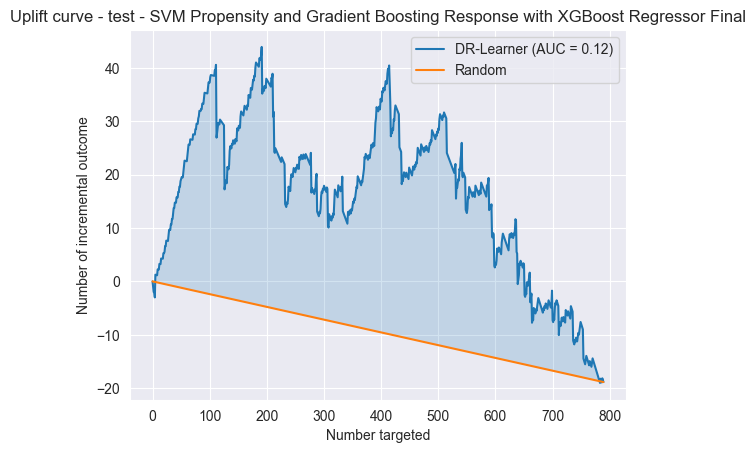

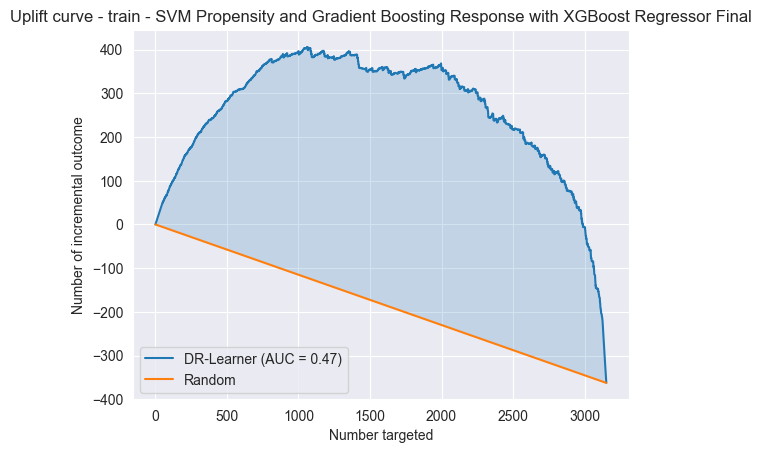

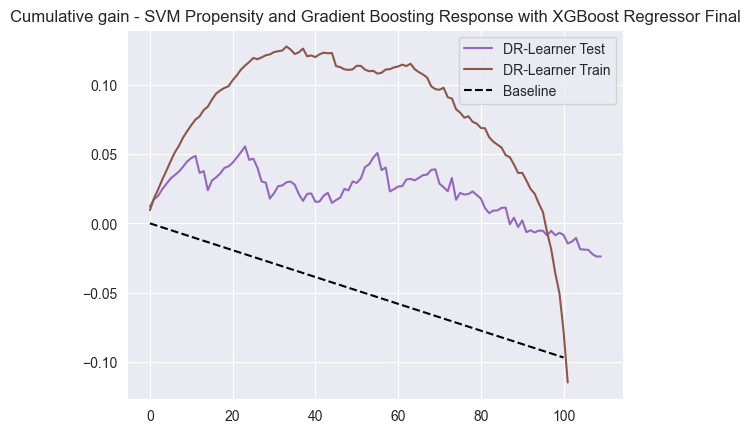

Iteration 6 for SVM Propensity and Gradient Boosting Response with XGBoost Regressor Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


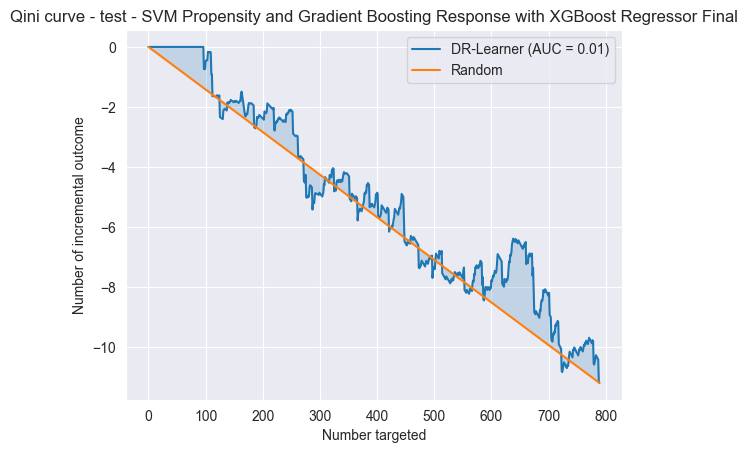

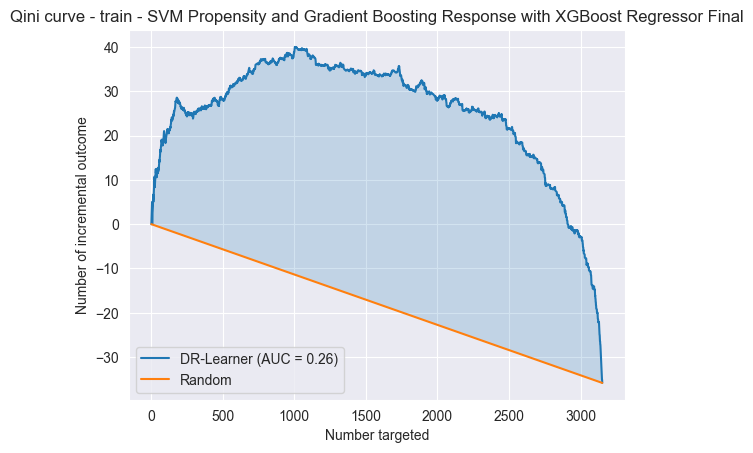

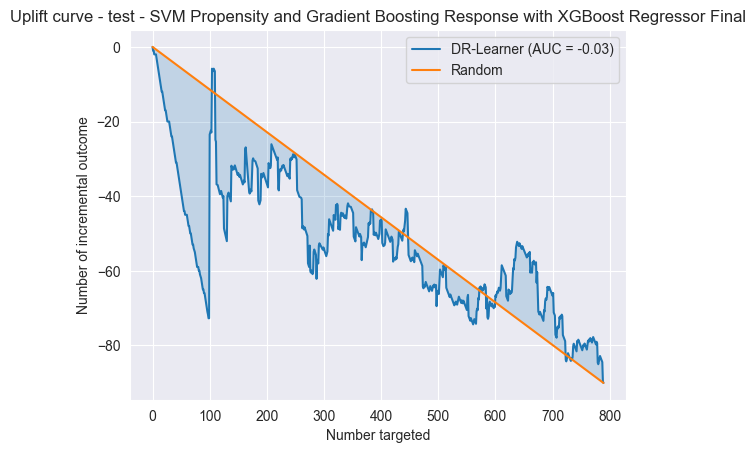

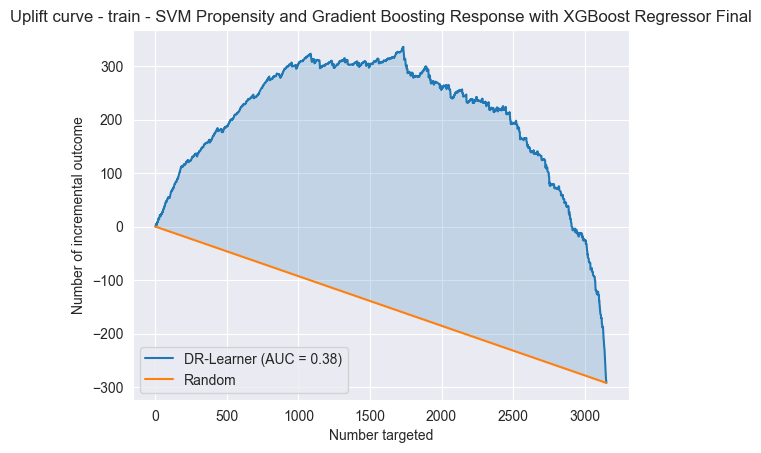

invalid value encountered in scalar divide


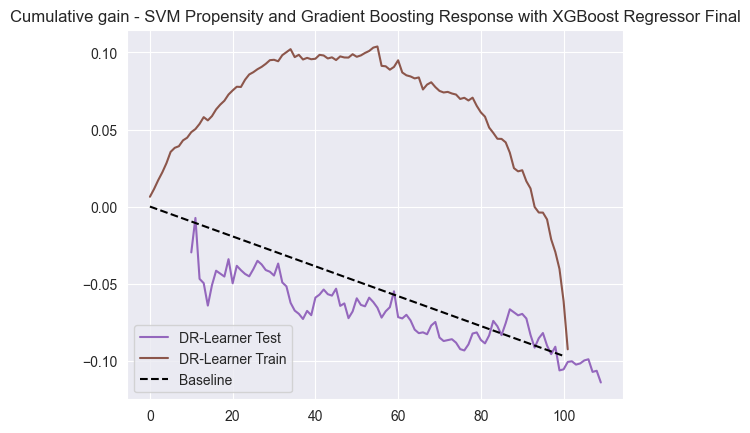

Iteration 7 for SVM Propensity and Gradient Boosting Response with XGBoost Regressor Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


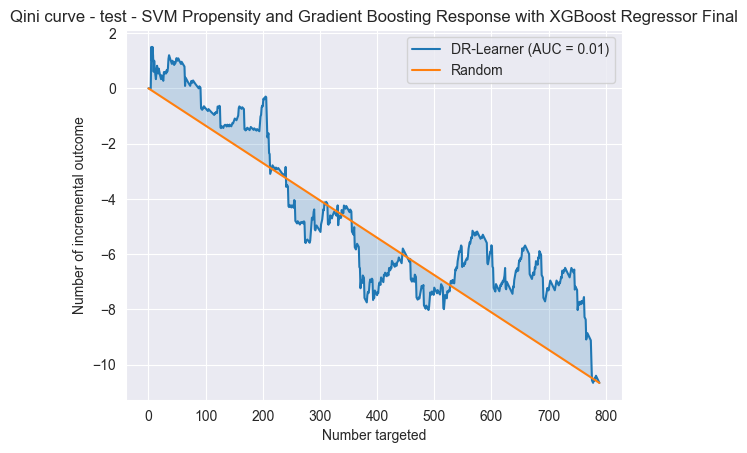

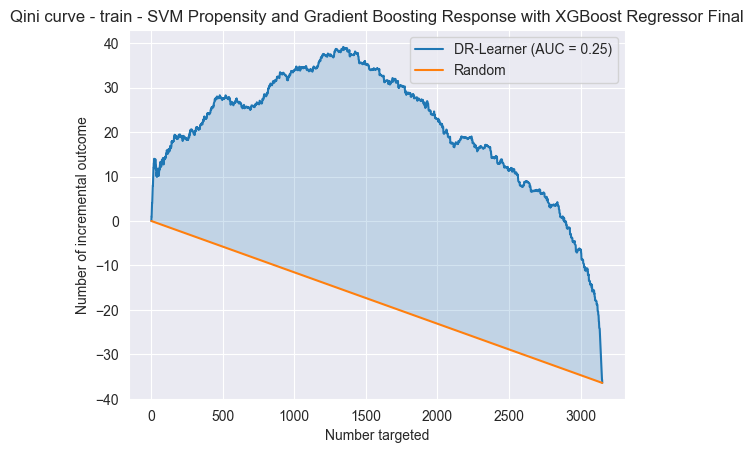

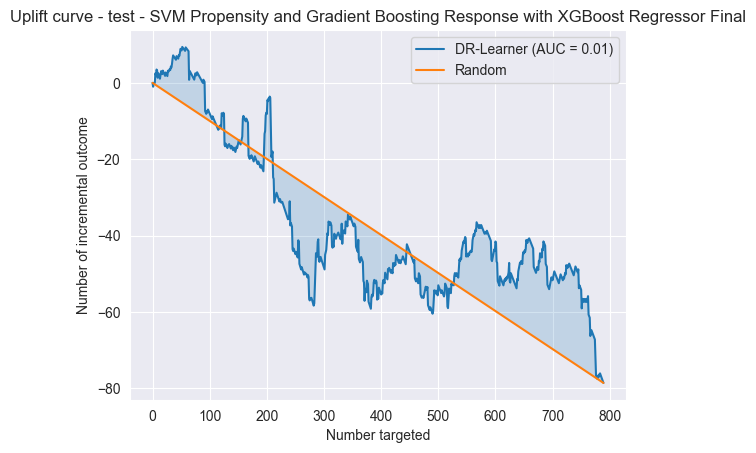

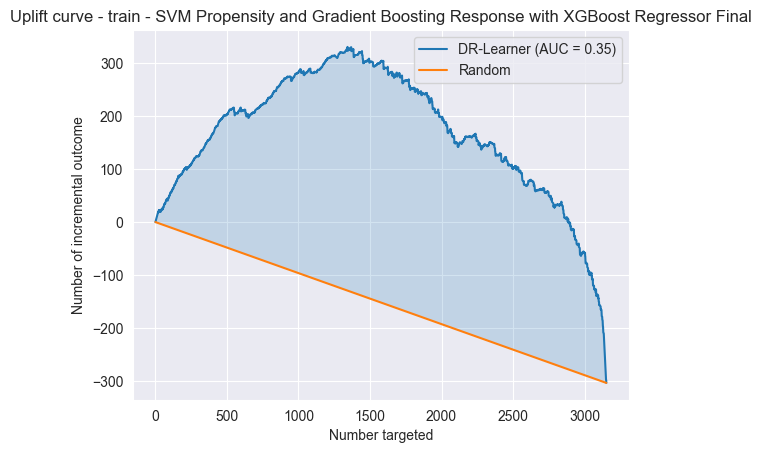

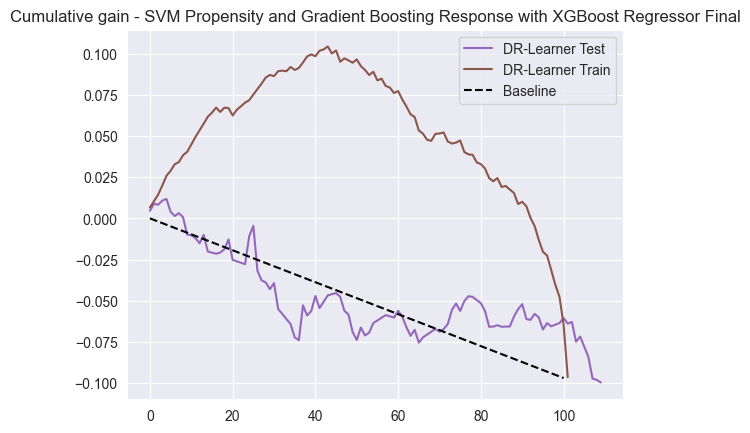

Iteration 8 for SVM Propensity and Gradient Boosting Response with XGBoost Regressor Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


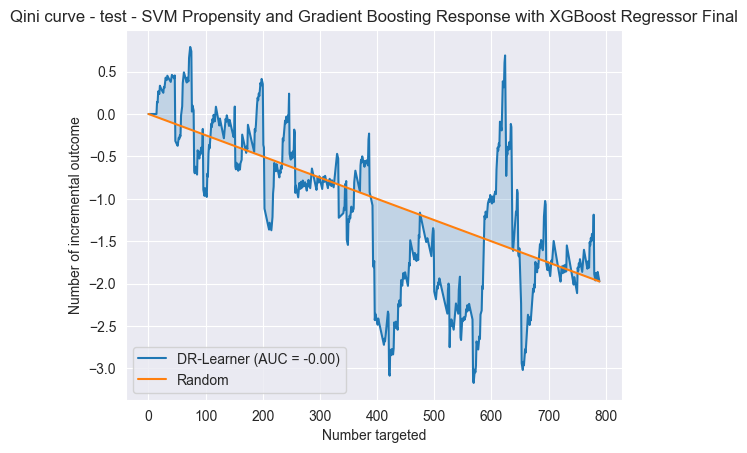

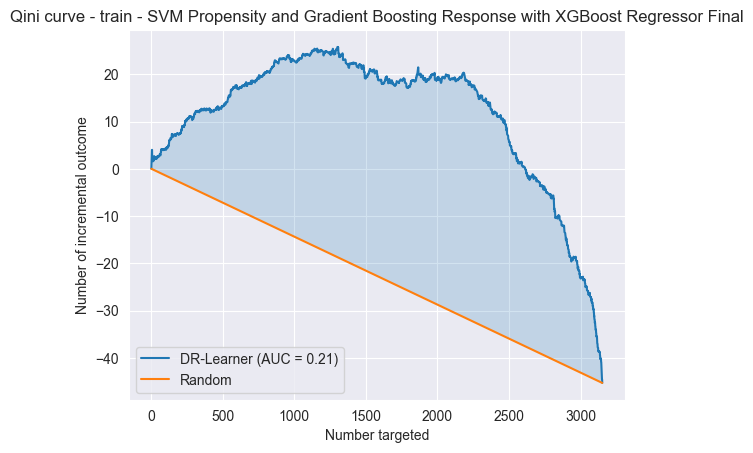

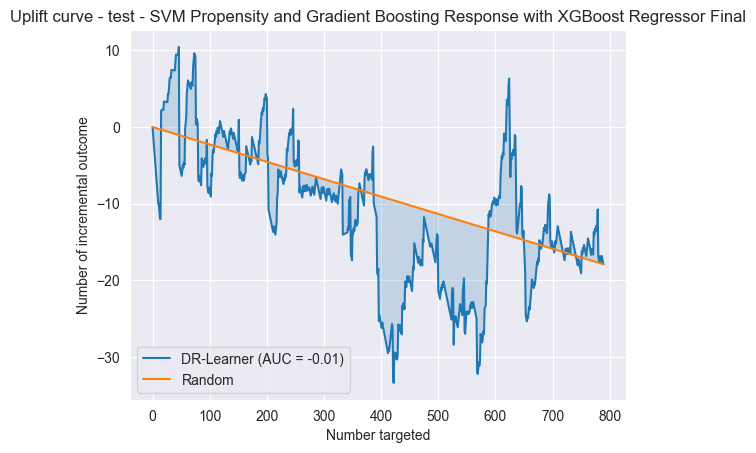

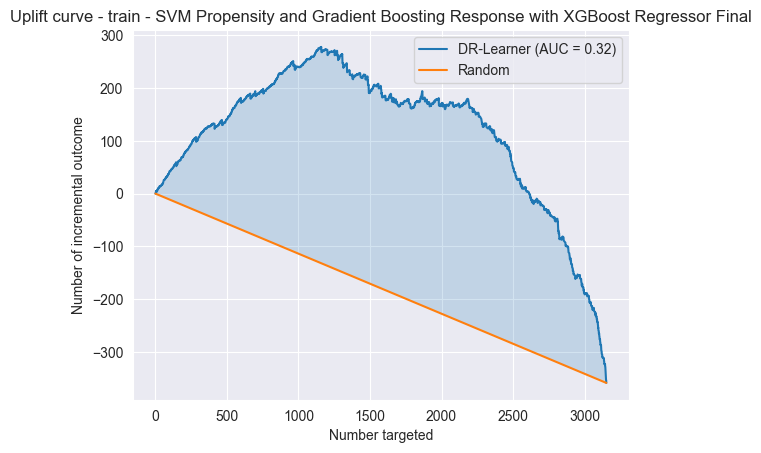

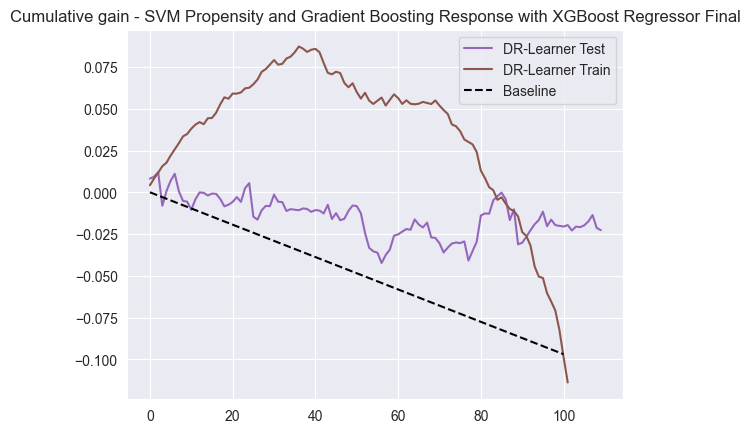

Iteration 9 for SVM Propensity and Gradient Boosting Response with XGBoost Regressor Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


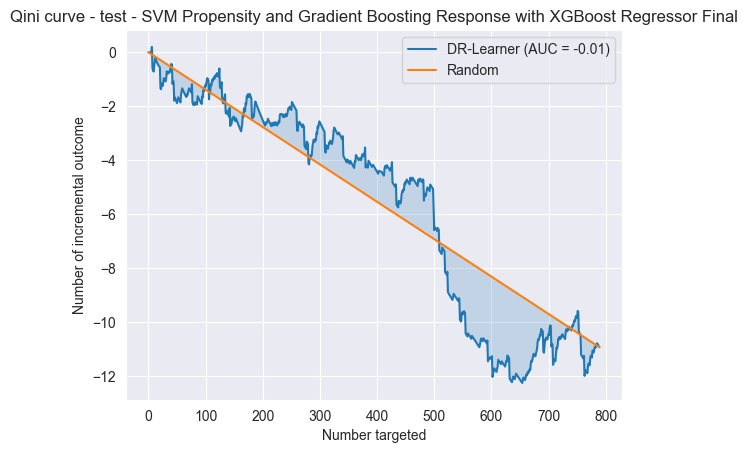

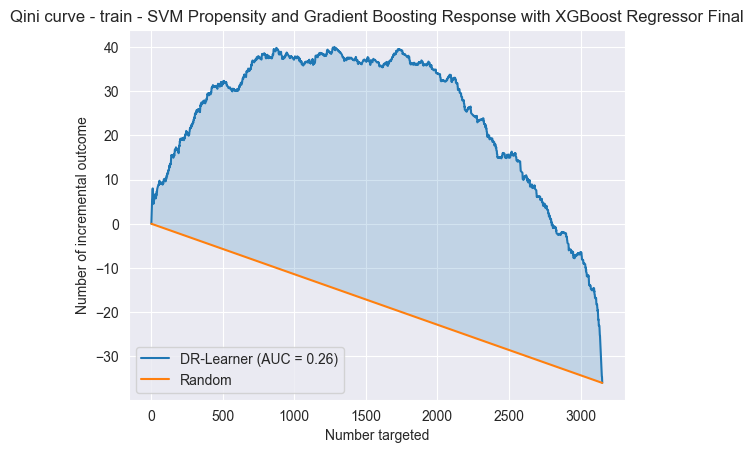

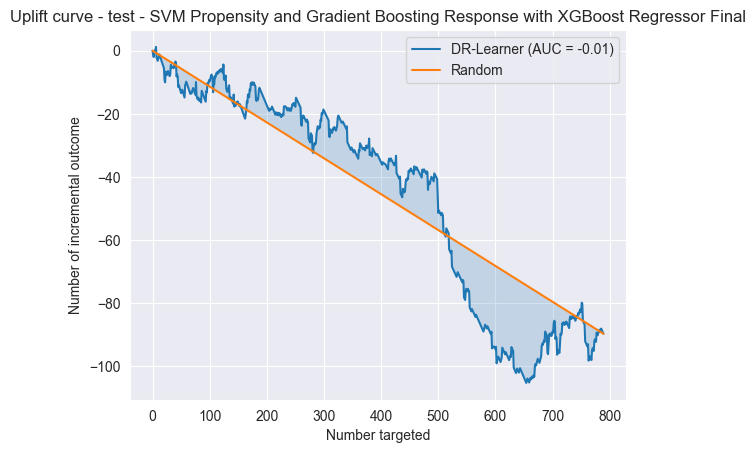

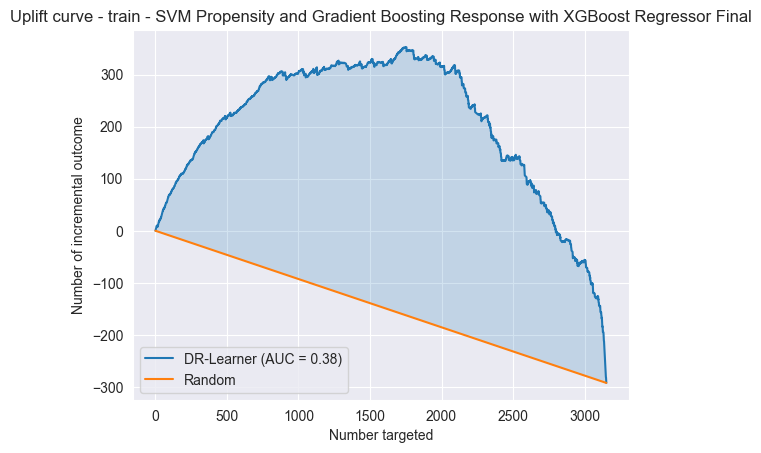

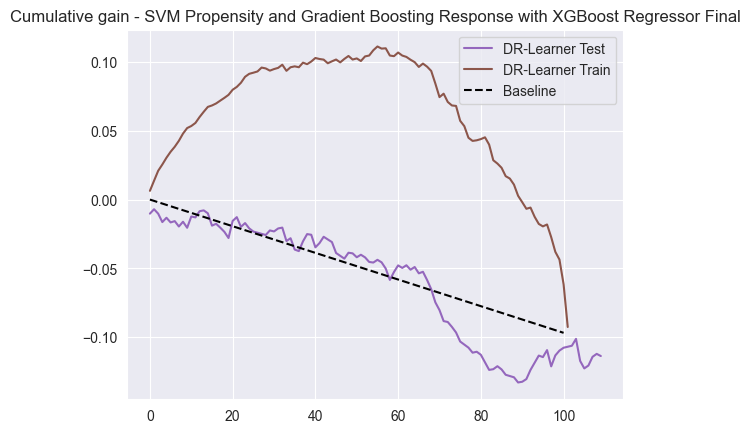

Results for SVM Propensity and Gradient Boosting Response with XGBoost Regressor Final:
Average Train Qini AUC: 0.281015, Average Test Qini AUC: 0.019345
Average Train Uplift AUC: 0.397081, Average Test Uplift AUC: 0.023251

Iteration 0 for Logistic Regression Propensity and Logistic Regression Response with Linear Regression Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


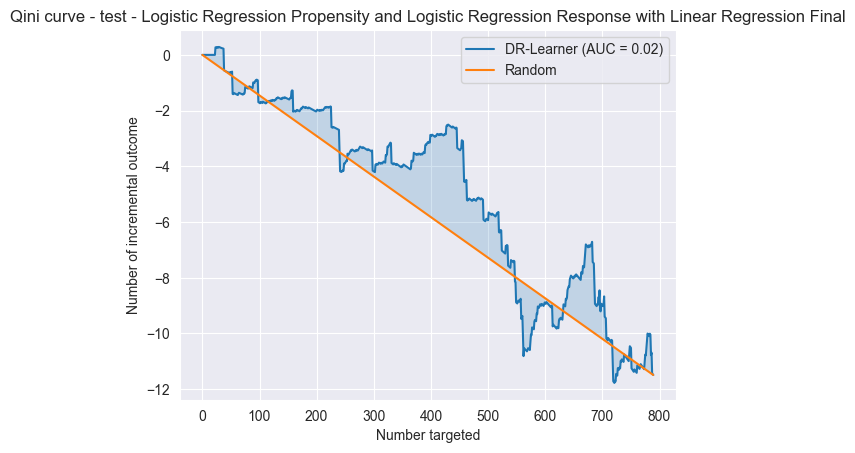

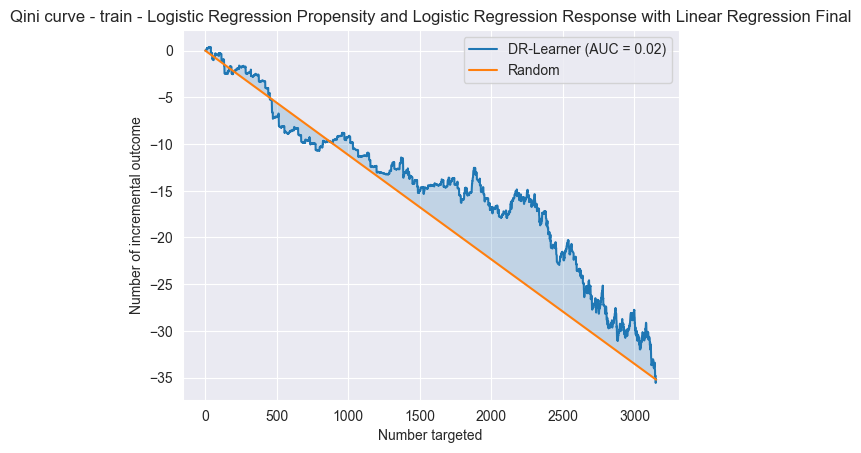

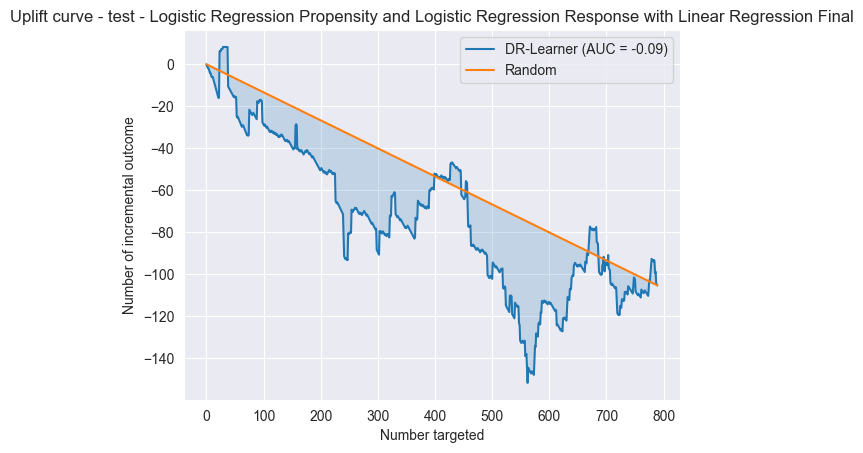

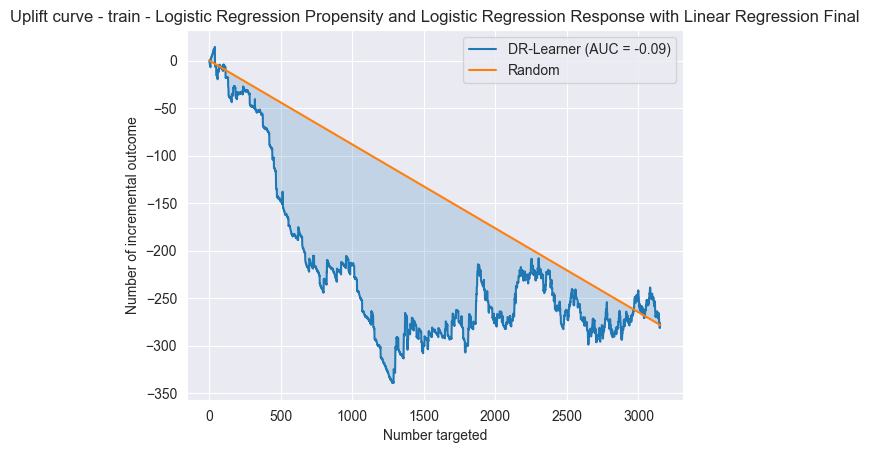

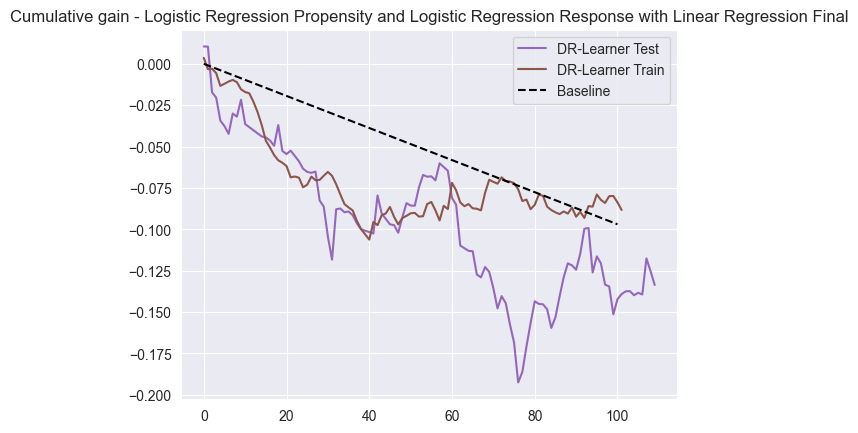

Iteration 1 for Logistic Regression Propensity and Logistic Regression Response with Linear Regression Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


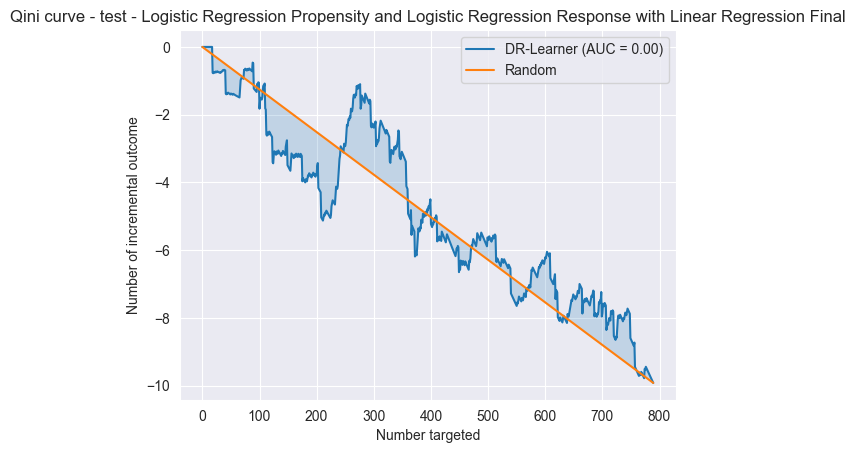

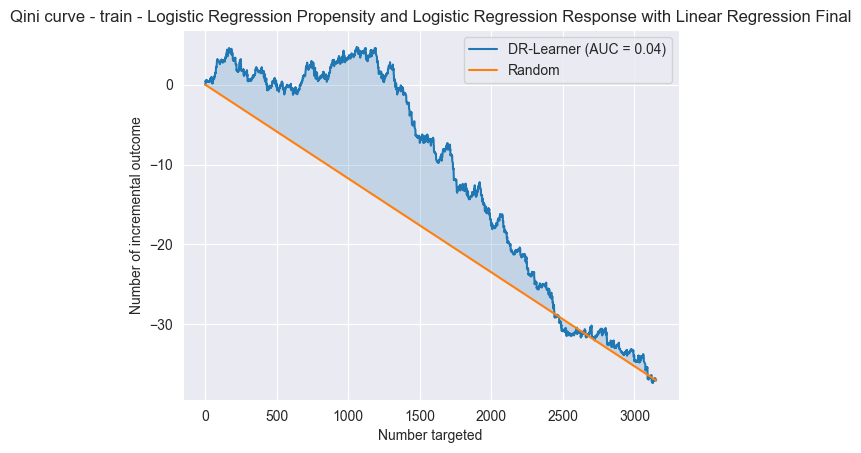

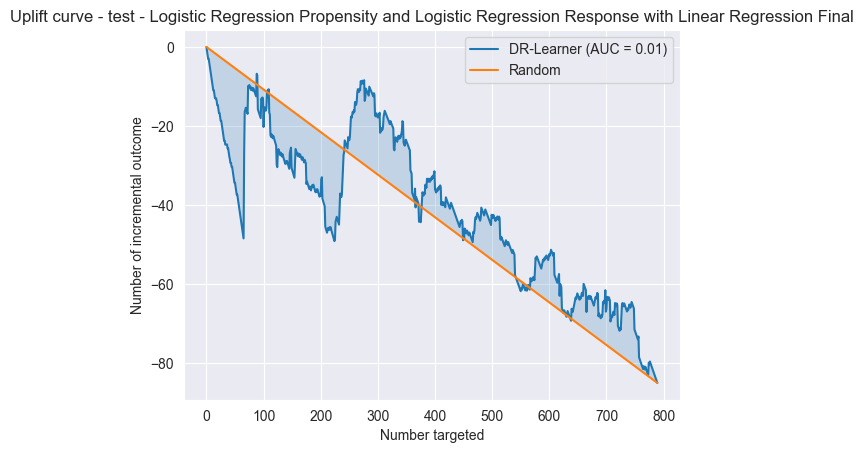

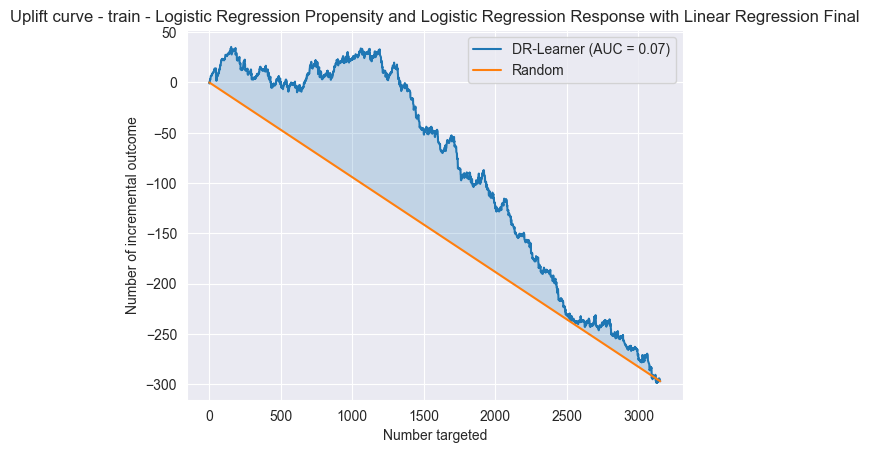

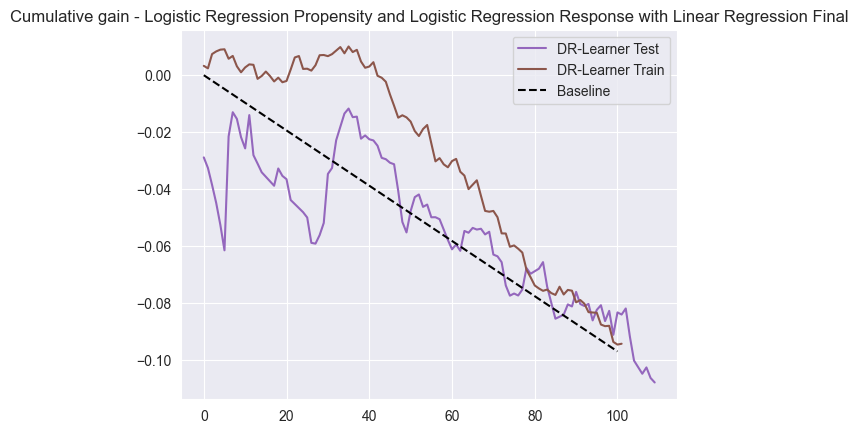

Iteration 2 for Logistic Regression Propensity and Logistic Regression Response with Linear Regression Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


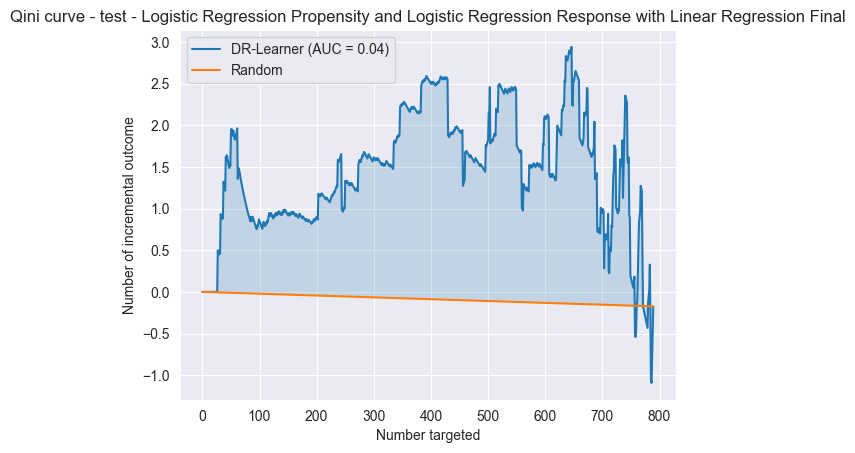

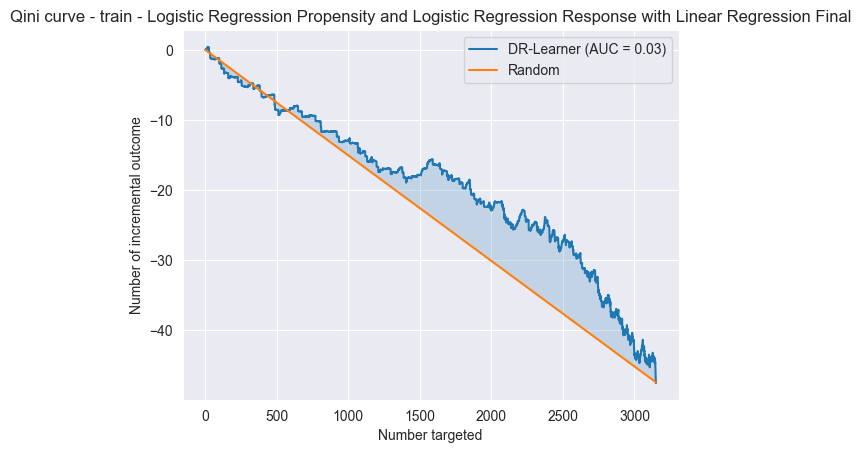

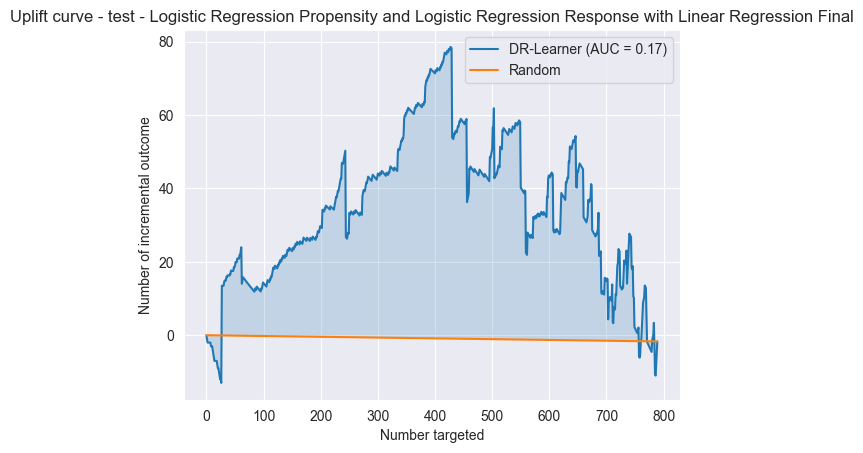

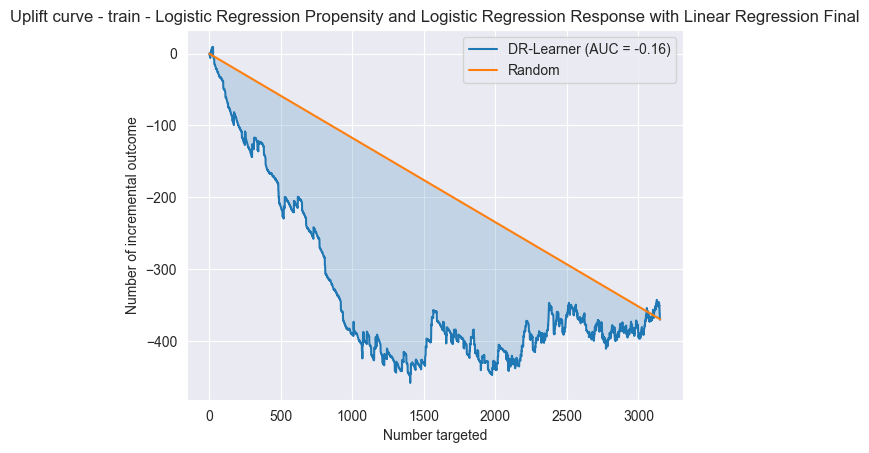

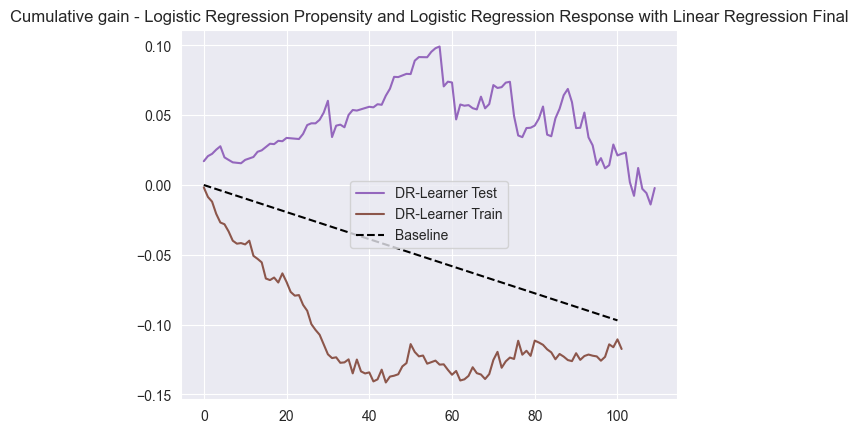

Iteration 3 for Logistic Regression Propensity and Logistic Regression Response with Linear Regression Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


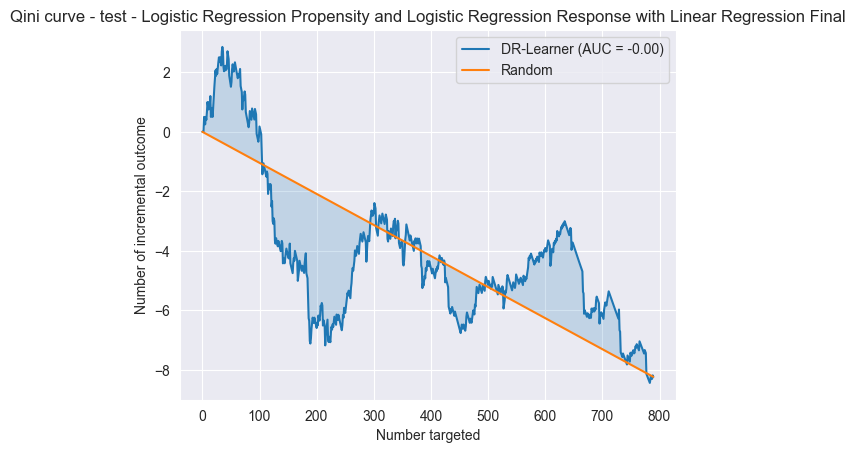

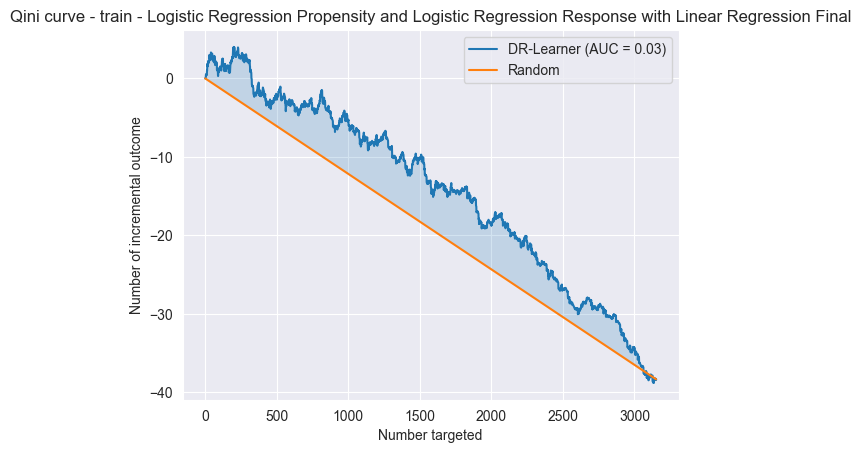

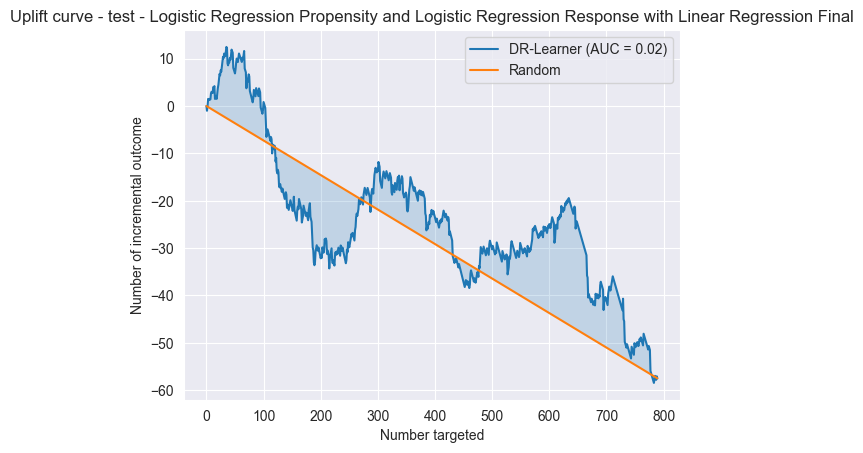

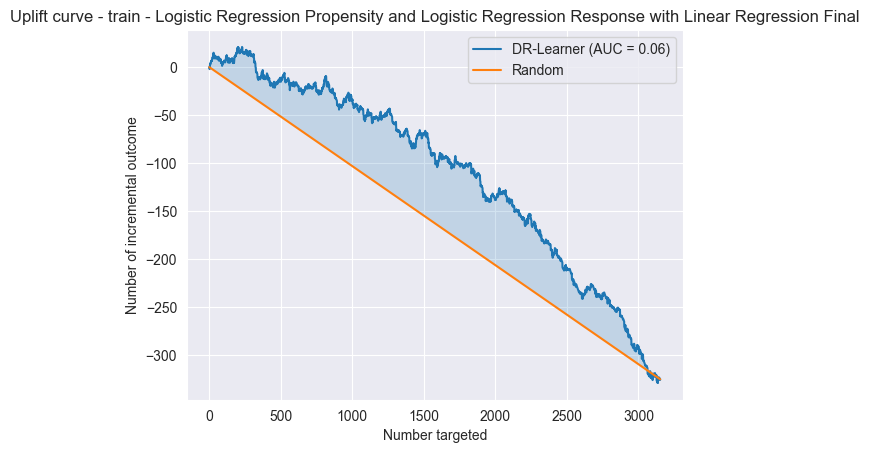

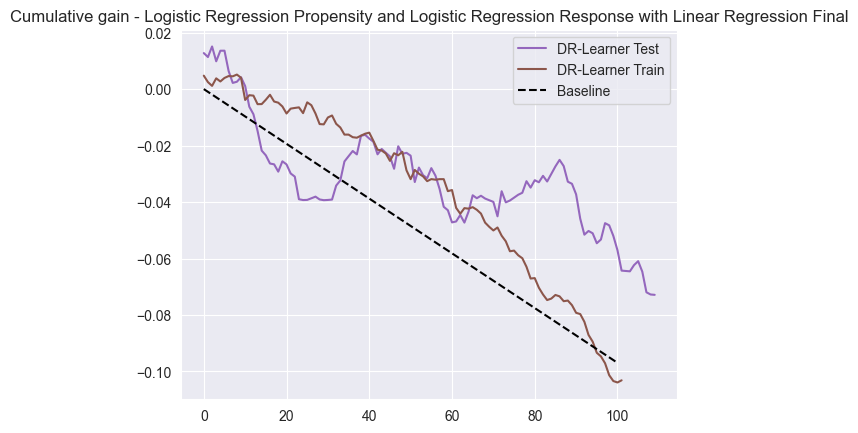

Iteration 4 for Logistic Regression Propensity and Logistic Regression Response with Linear Regression Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


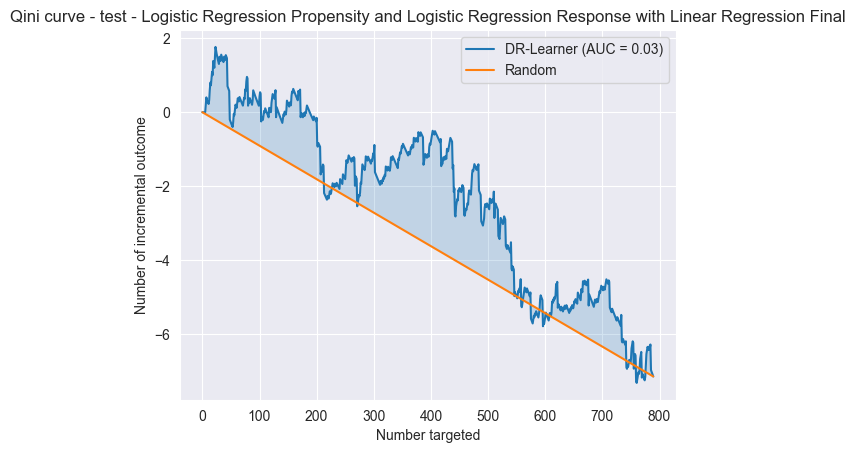

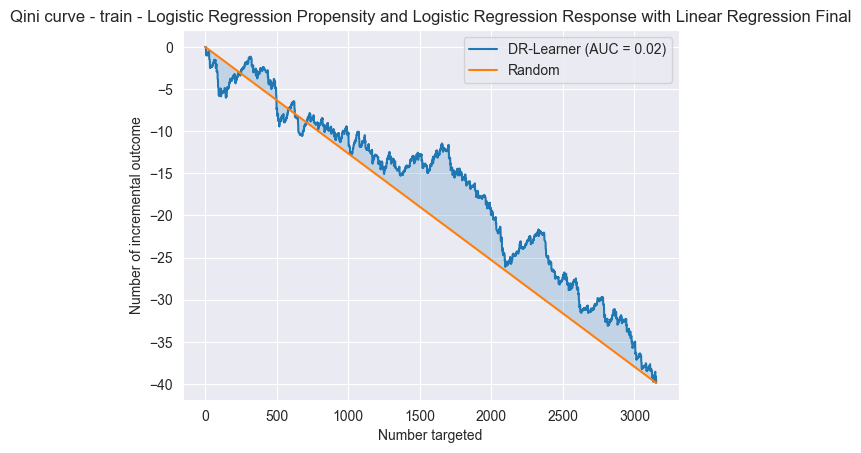

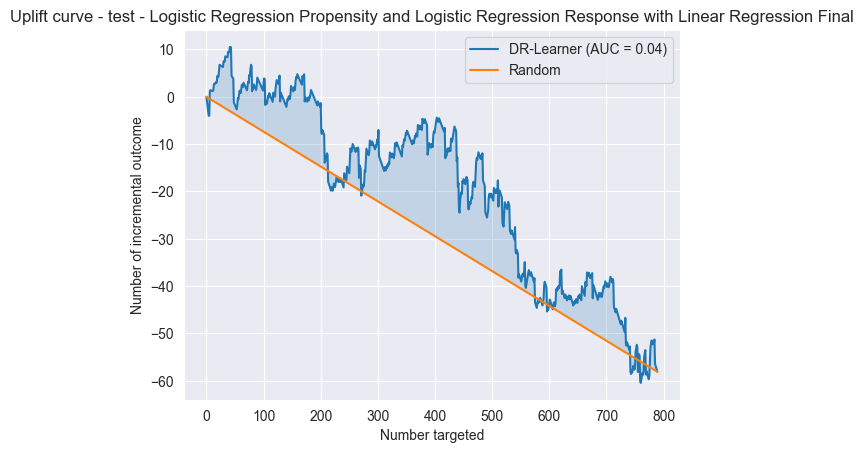

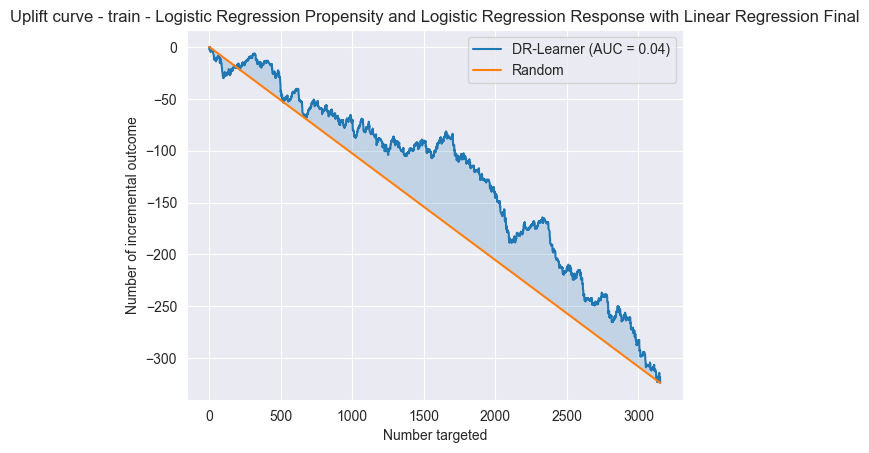

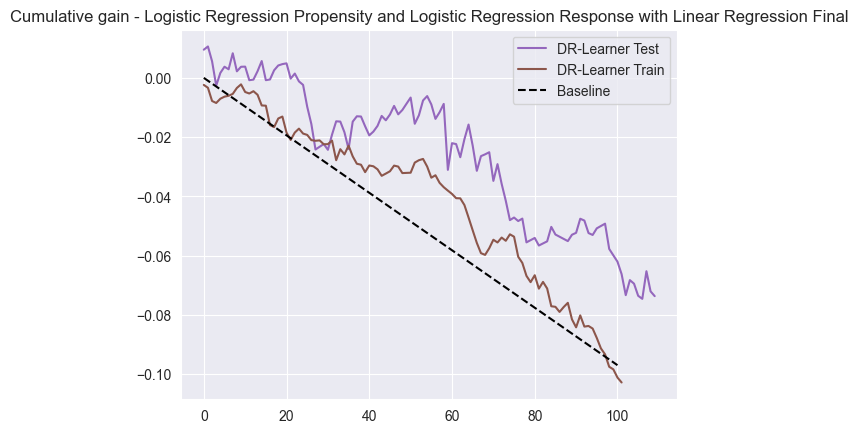

Iteration 5 for Logistic Regression Propensity and Logistic Regression Response with Linear Regression Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


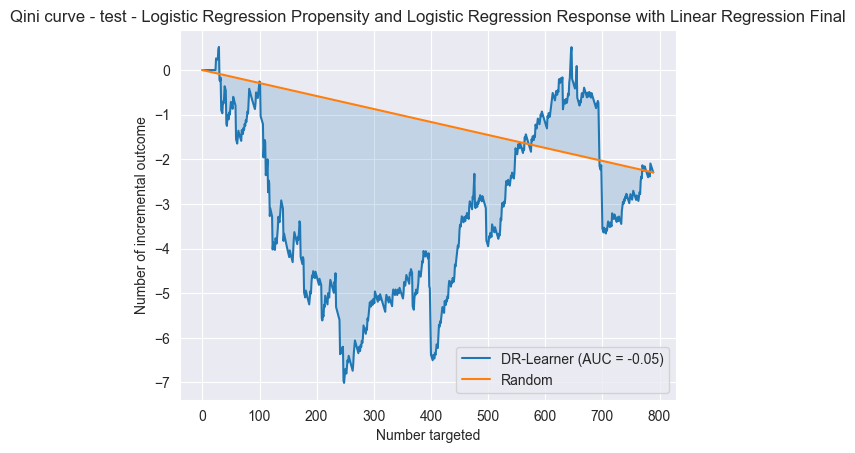

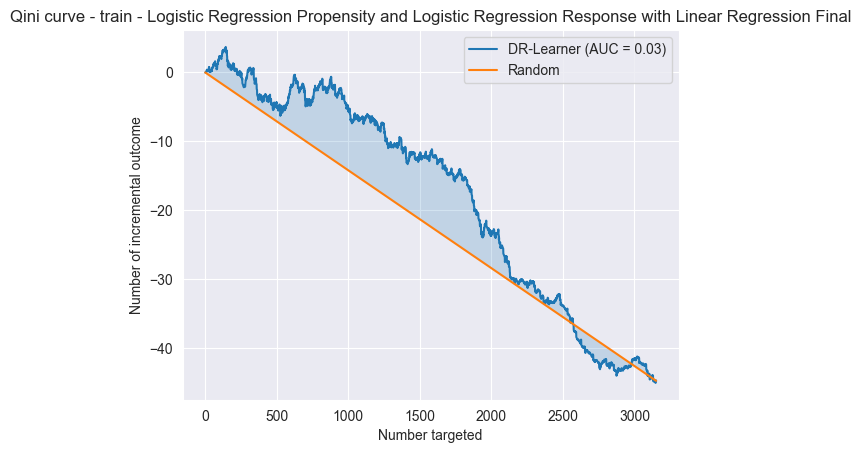

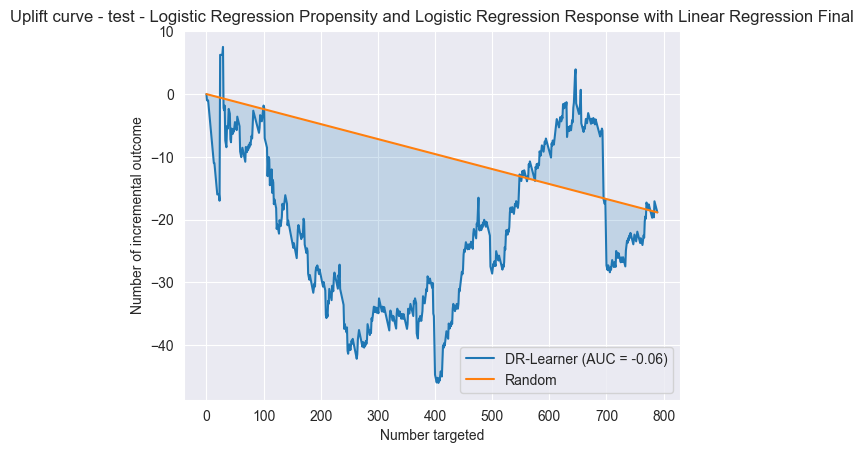

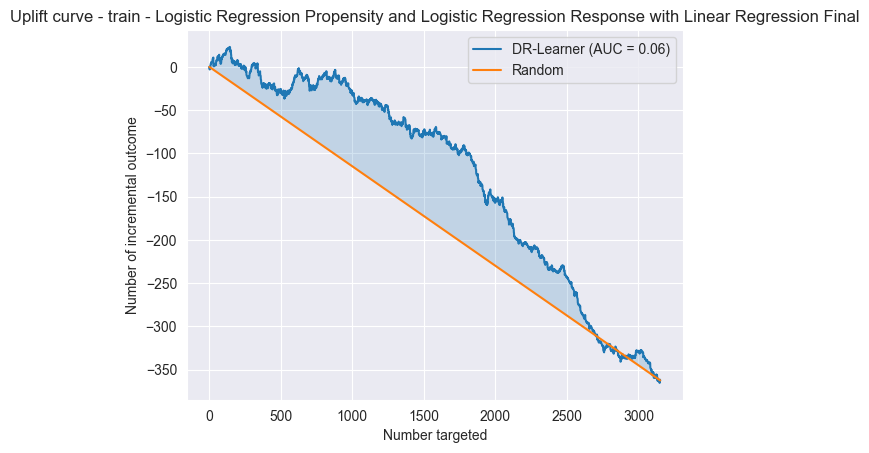

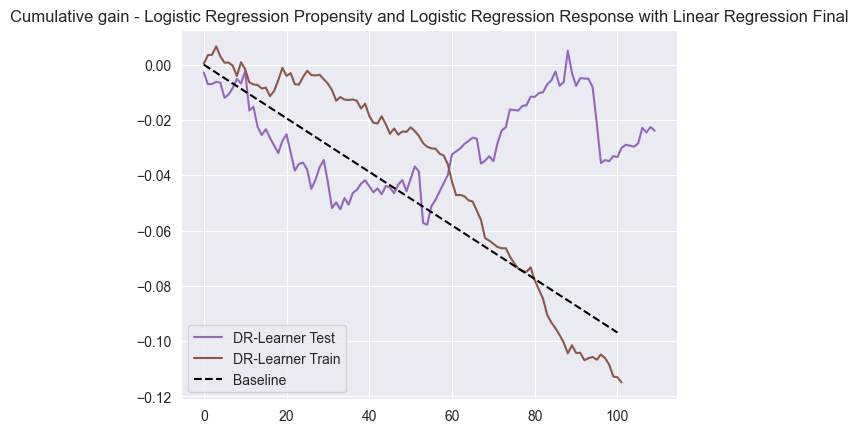

Iteration 6 for Logistic Regression Propensity and Logistic Regression Response with Linear Regression Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


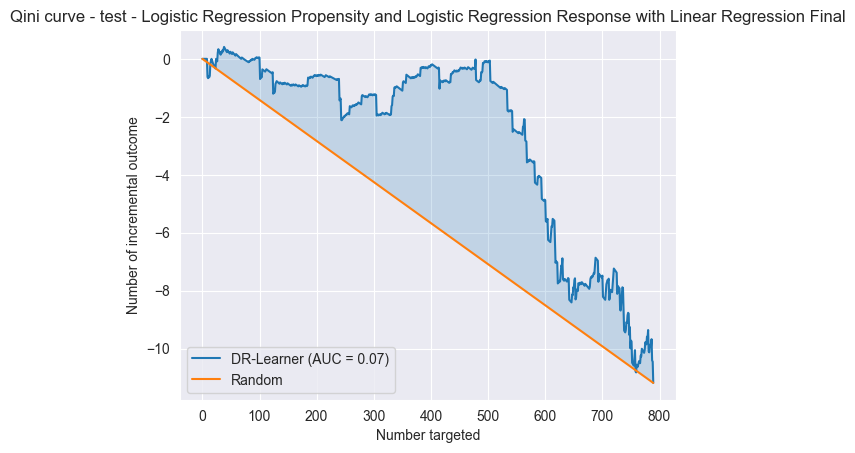

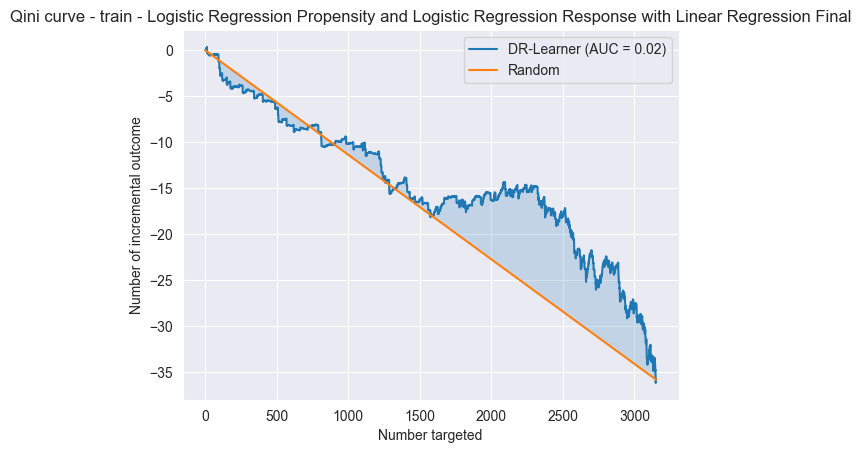

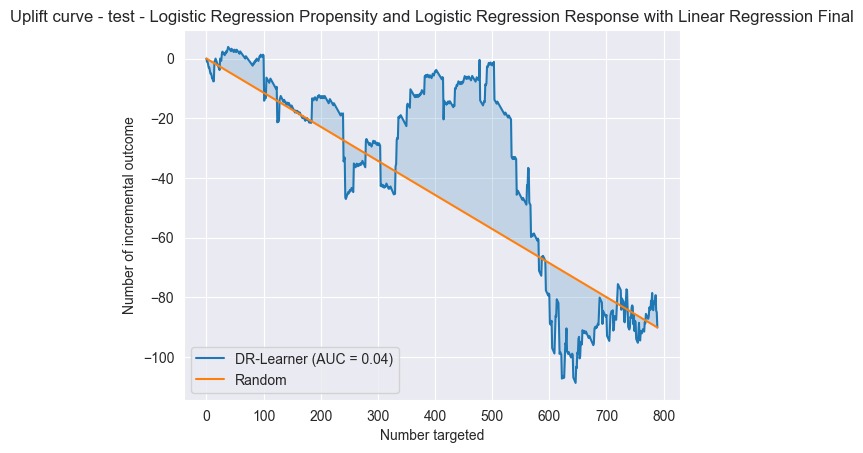

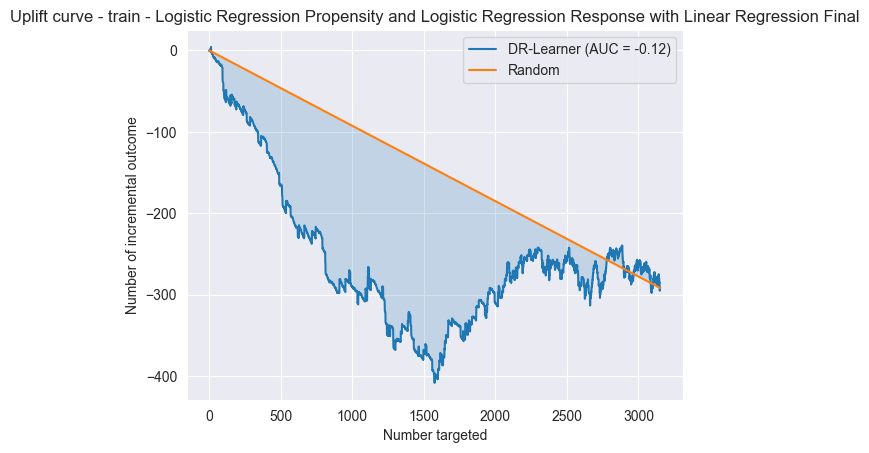

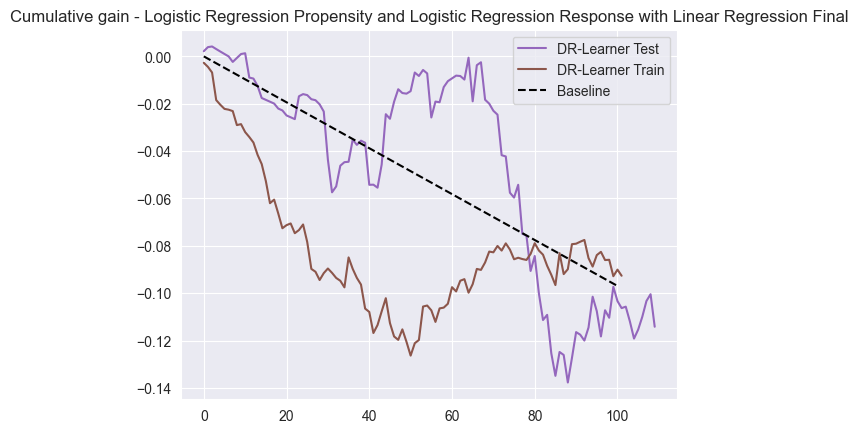

Iteration 7 for Logistic Regression Propensity and Logistic Regression Response with Linear Regression Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


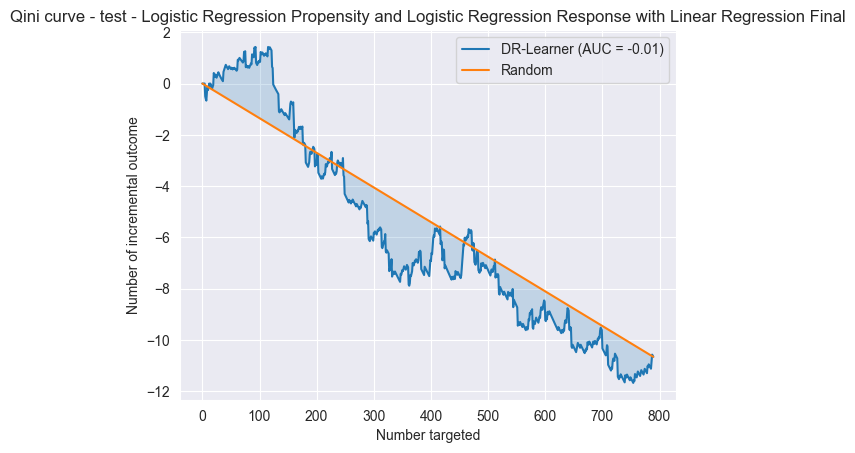

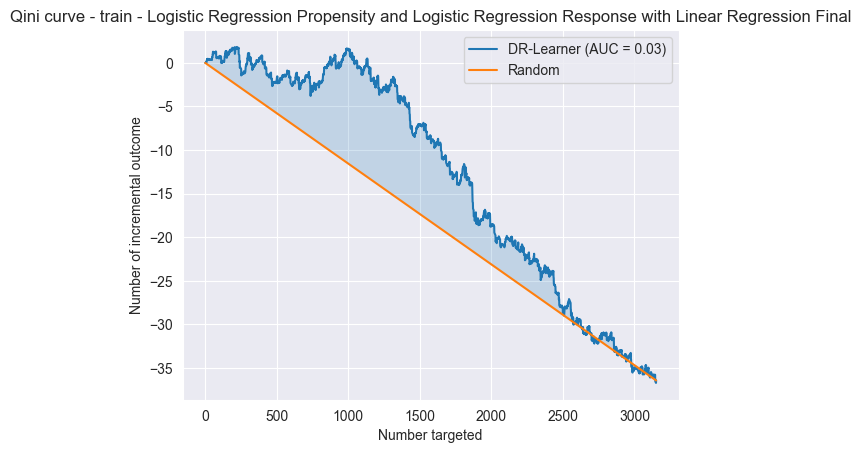

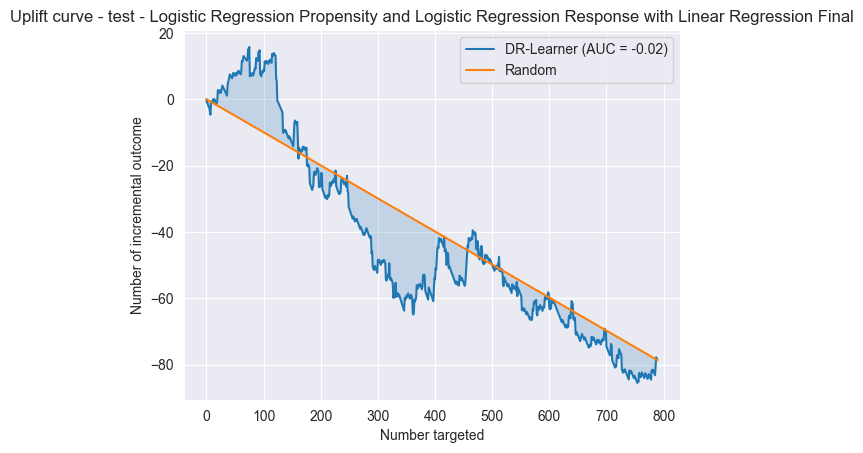

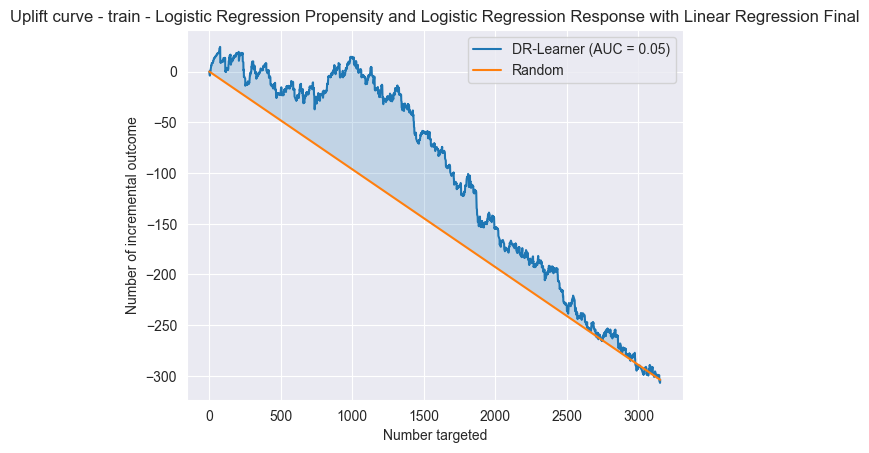

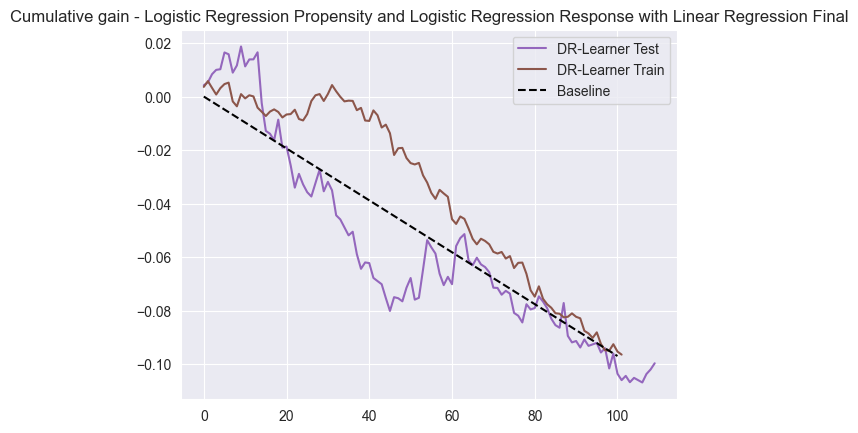

Iteration 8 for Logistic Regression Propensity and Logistic Regression Response with Linear Regression Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


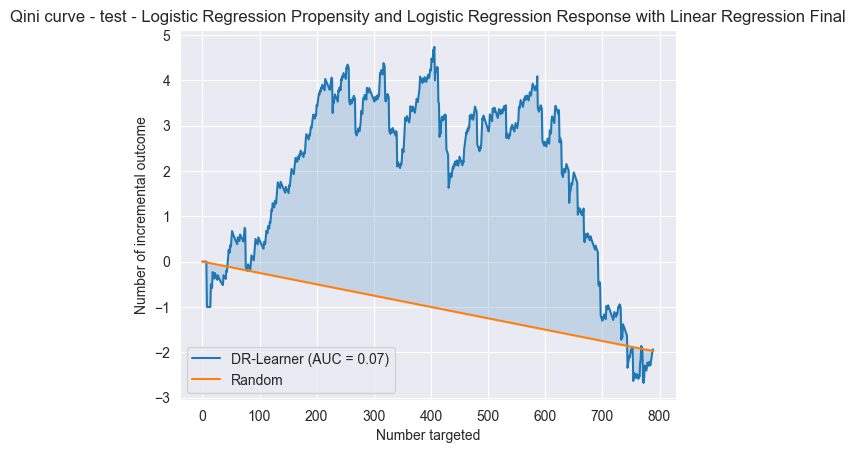

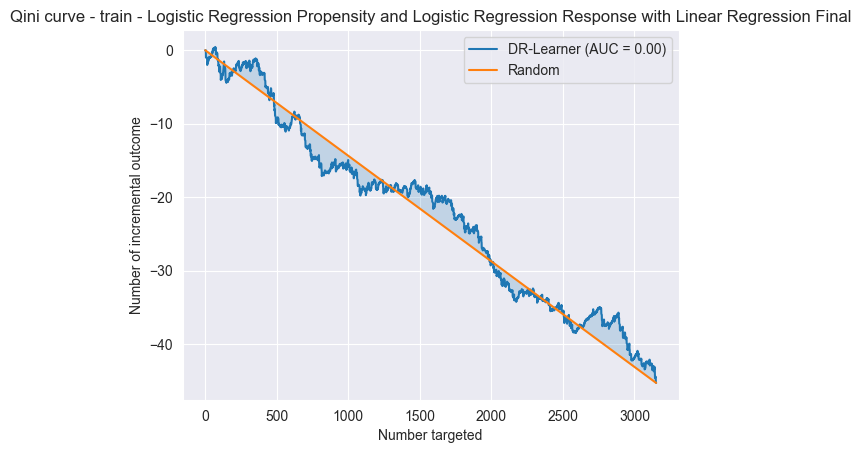

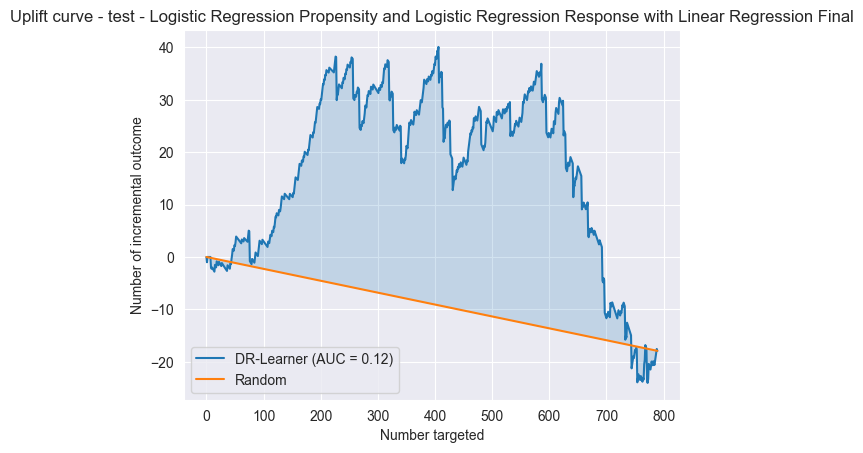

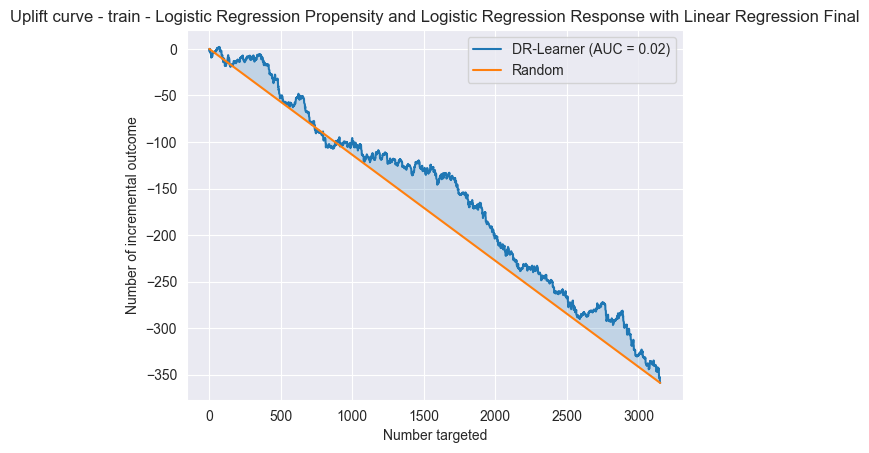

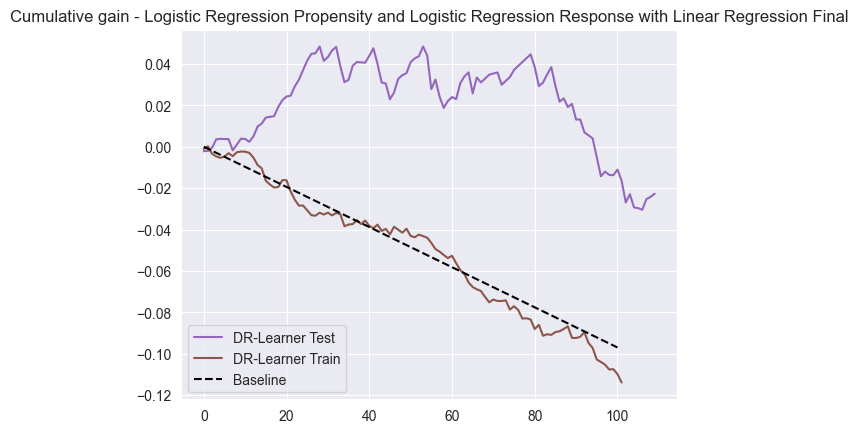

Iteration 9 for Logistic Regression Propensity and Logistic Regression Response with Linear Regression Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


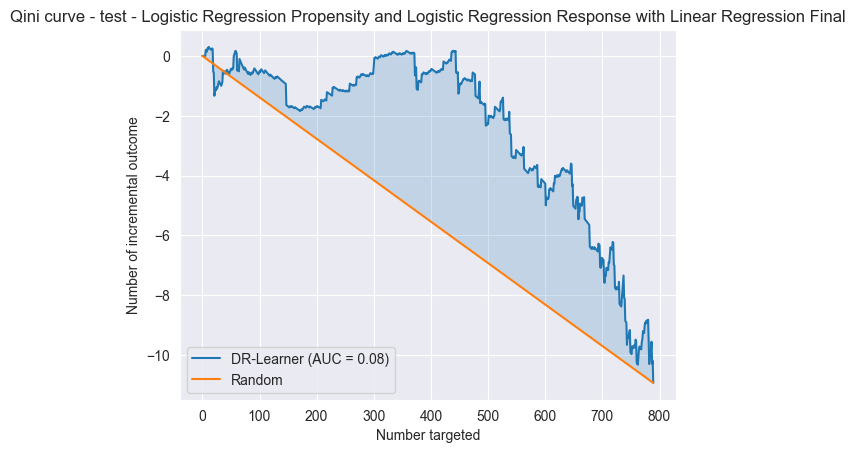

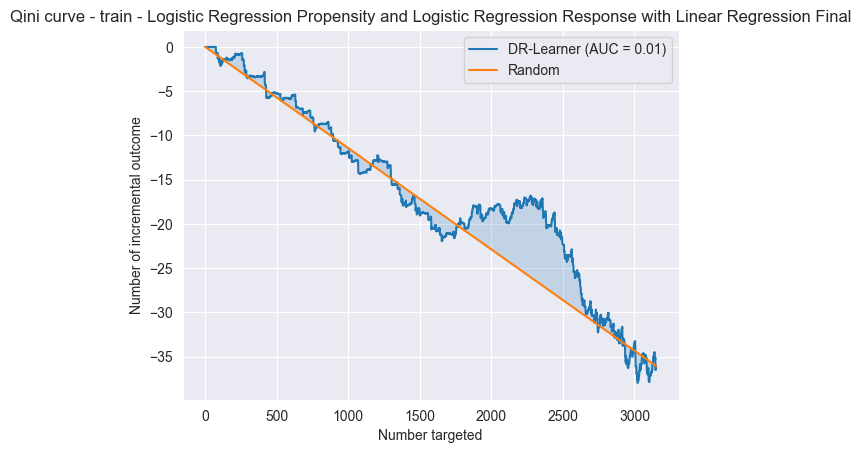

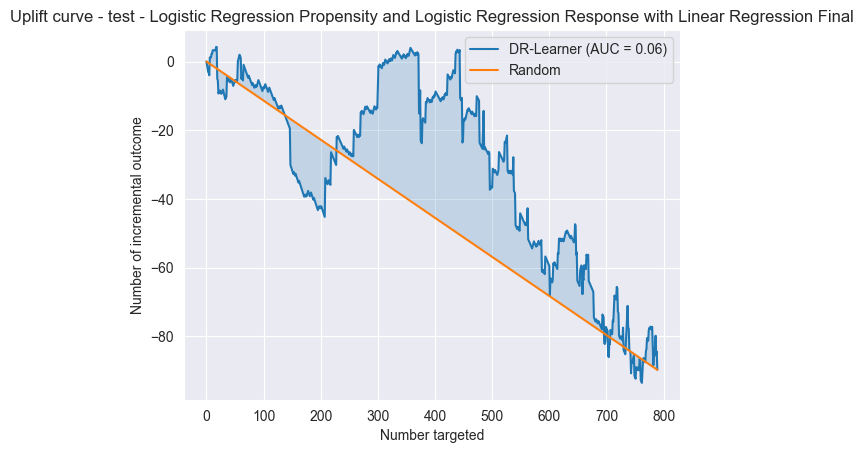

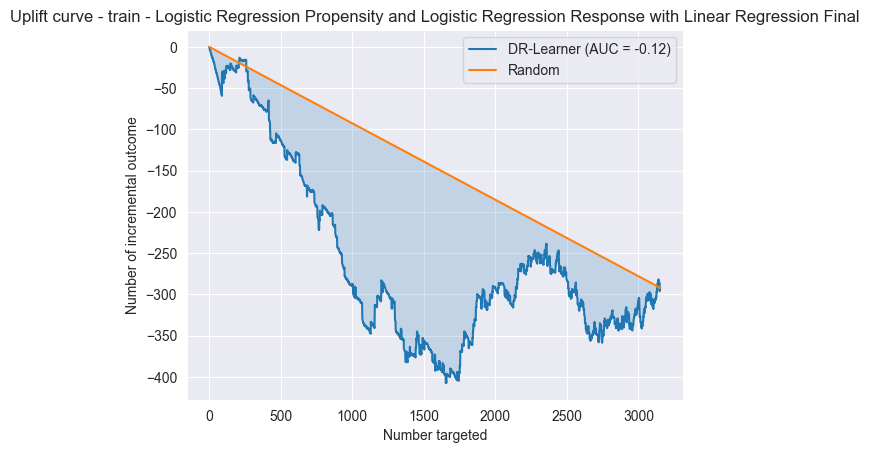

invalid value encountered in scalar divide


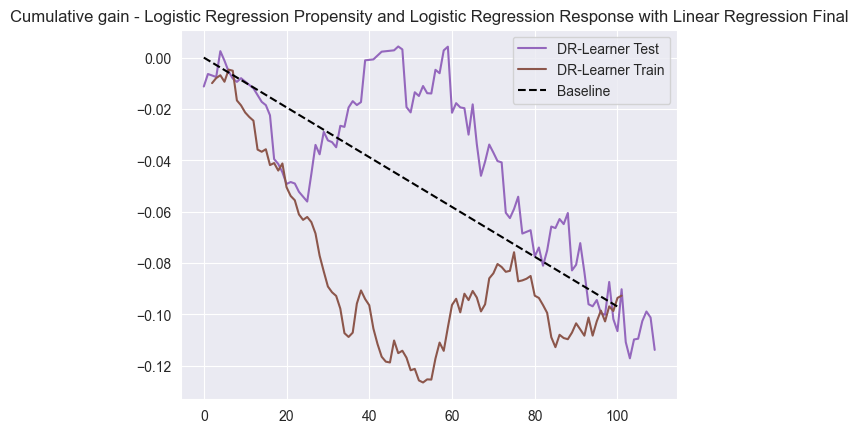

Results for Logistic Regression Propensity and Logistic Regression Response with Linear Regression Final:
Average Train Qini AUC: 0.022966, Average Test Qini AUC: 0.025802
Average Train Uplift AUC: -0.019943, Average Test Uplift AUC: 0.028353

Iteration 0 for Gradient Boosting Propensity and Gradient Boosting Response with Gradient Boosting Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


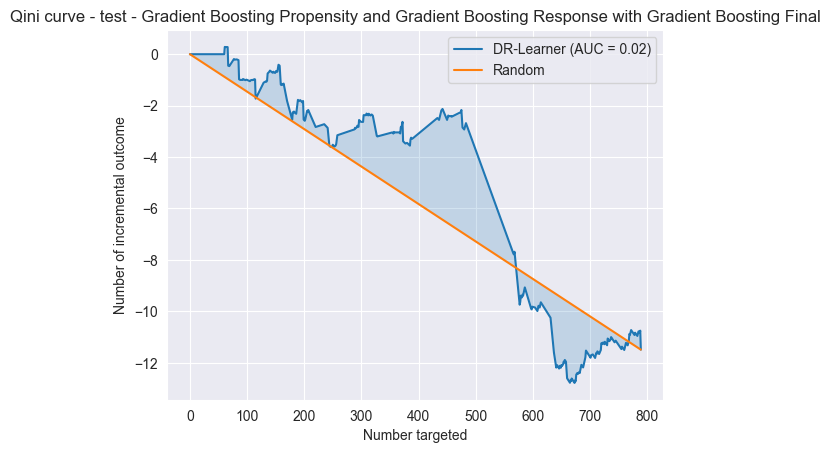

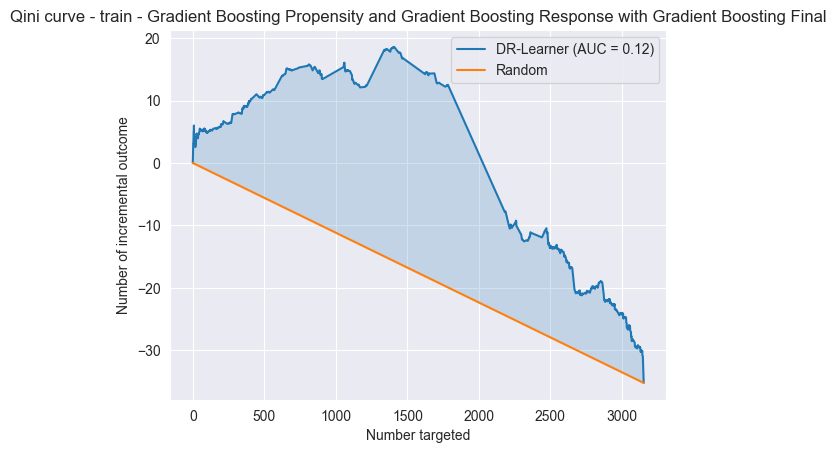

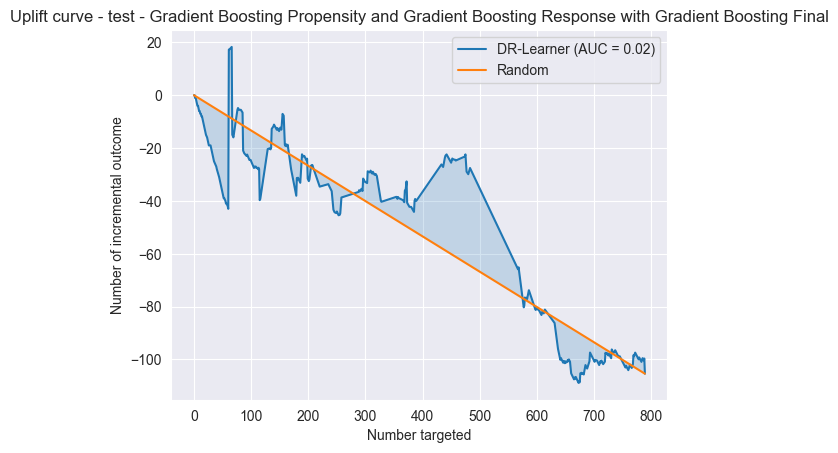

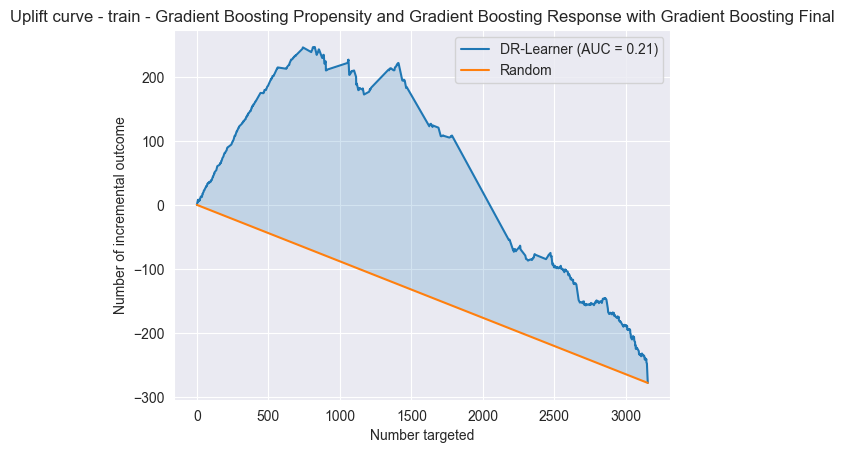

invalid value encountered in scalar divide


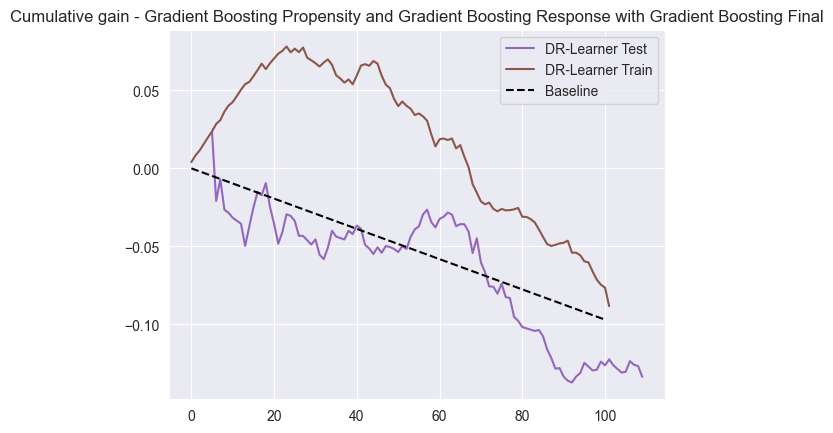

Iteration 1 for Gradient Boosting Propensity and Gradient Boosting Response with Gradient Boosting Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


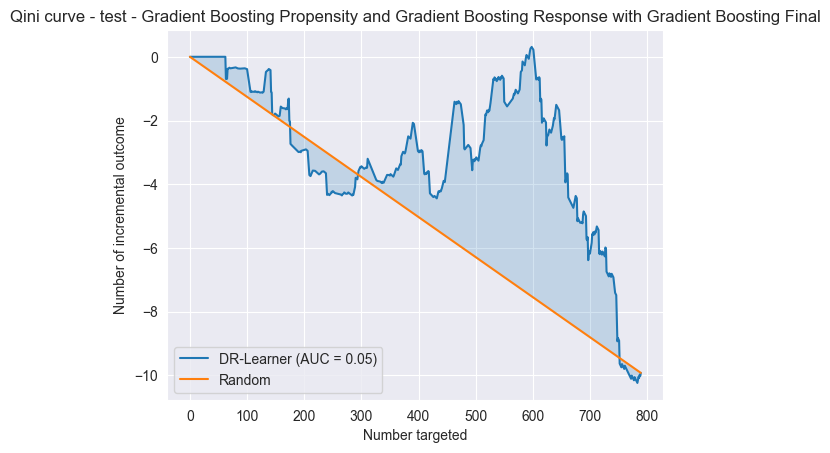

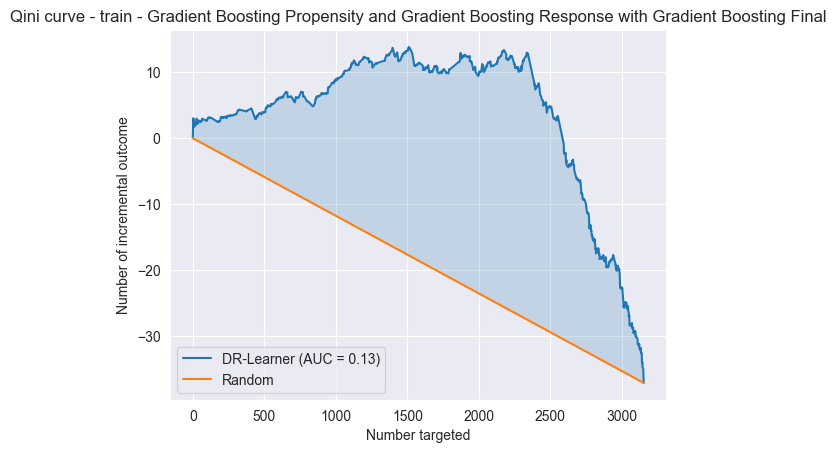

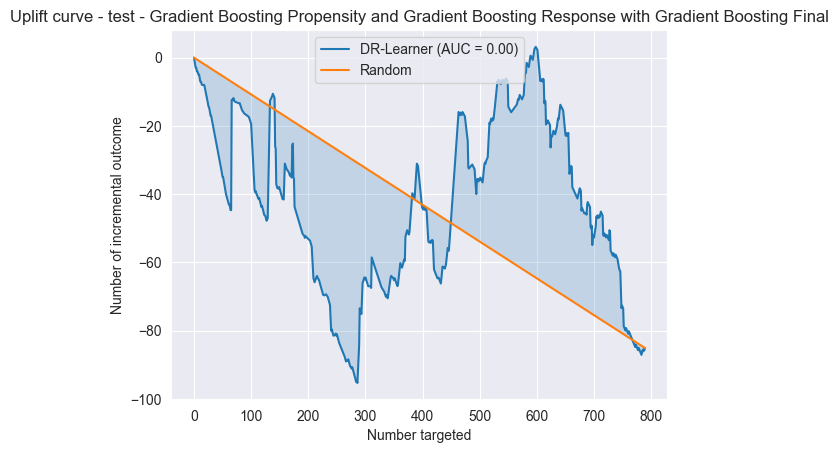

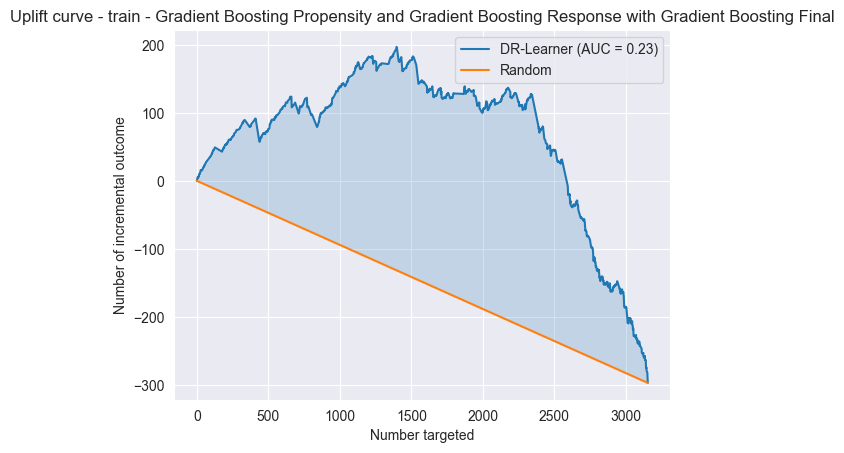

invalid value encountered in scalar divide


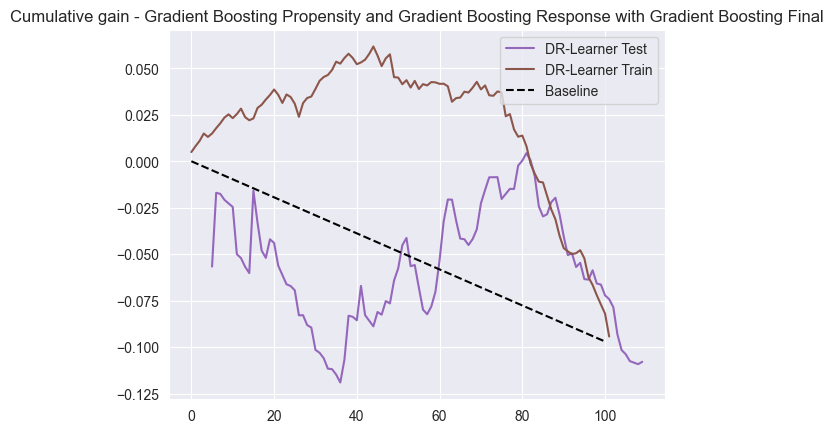

Iteration 2 for Gradient Boosting Propensity and Gradient Boosting Response with Gradient Boosting Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


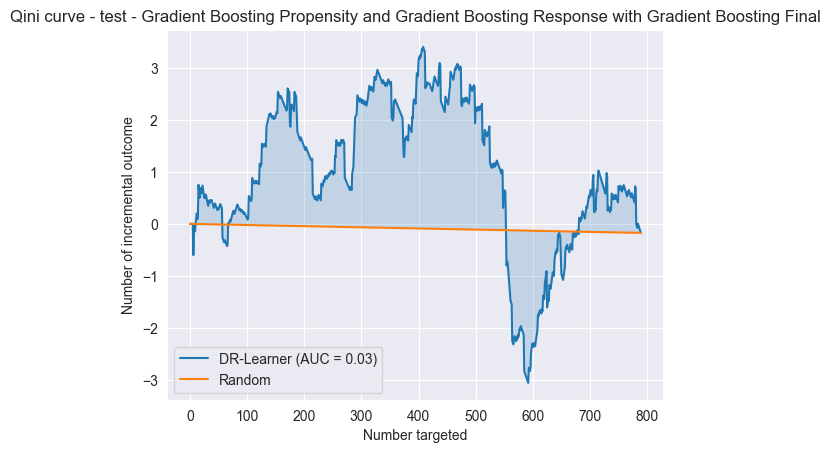

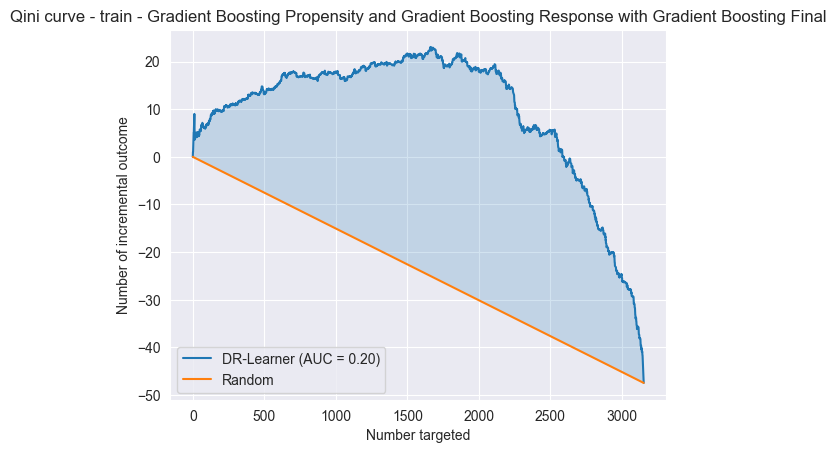

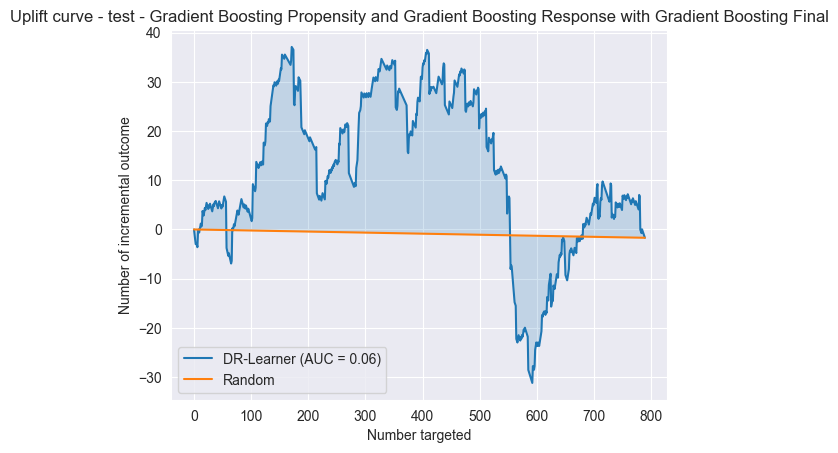

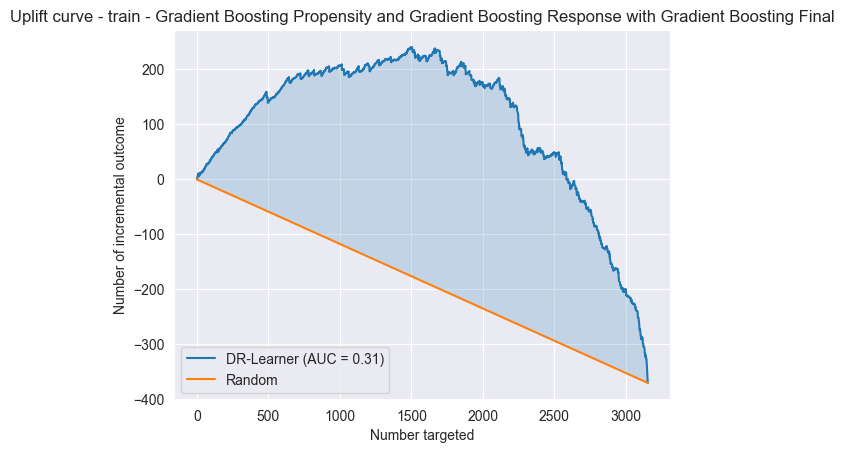

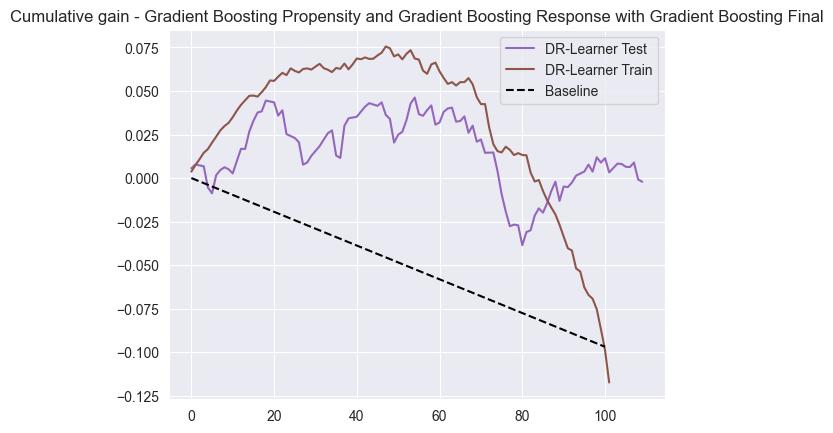

Iteration 3 for Gradient Boosting Propensity and Gradient Boosting Response with Gradient Boosting Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


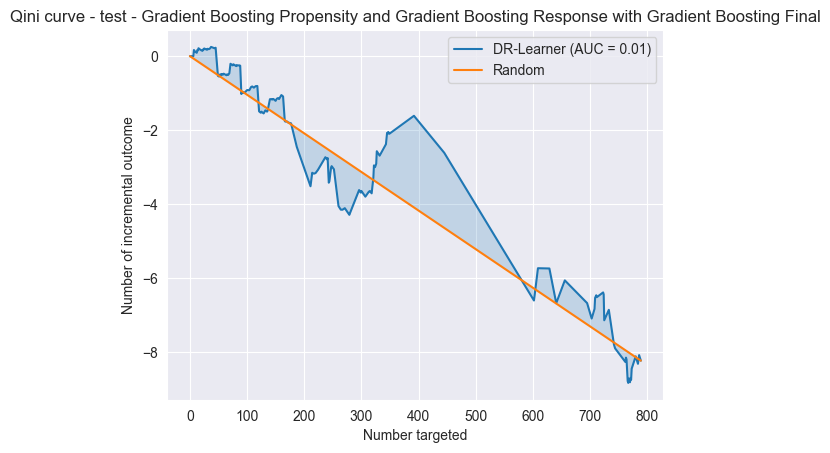

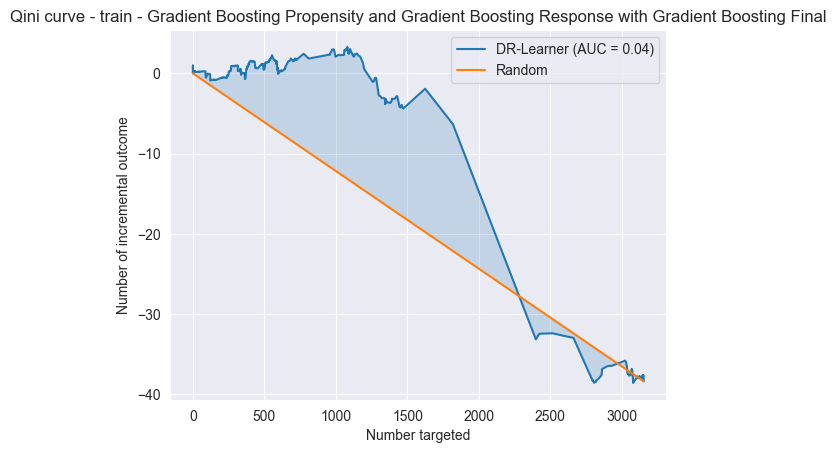

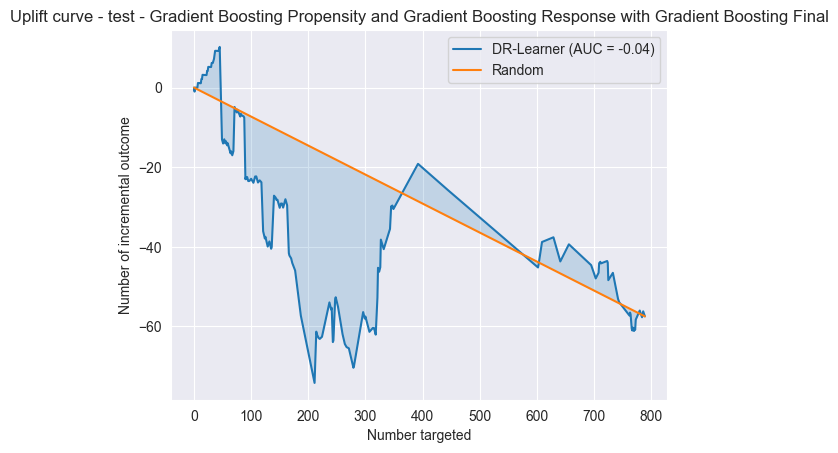

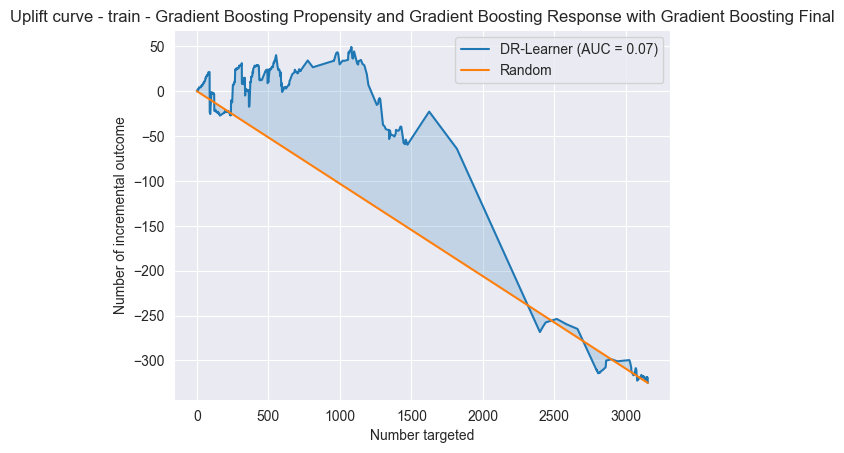

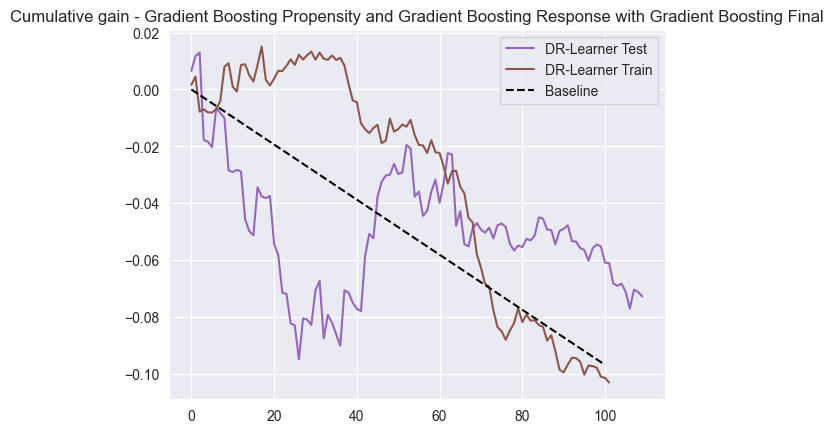

Iteration 4 for Gradient Boosting Propensity and Gradient Boosting Response with Gradient Boosting Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


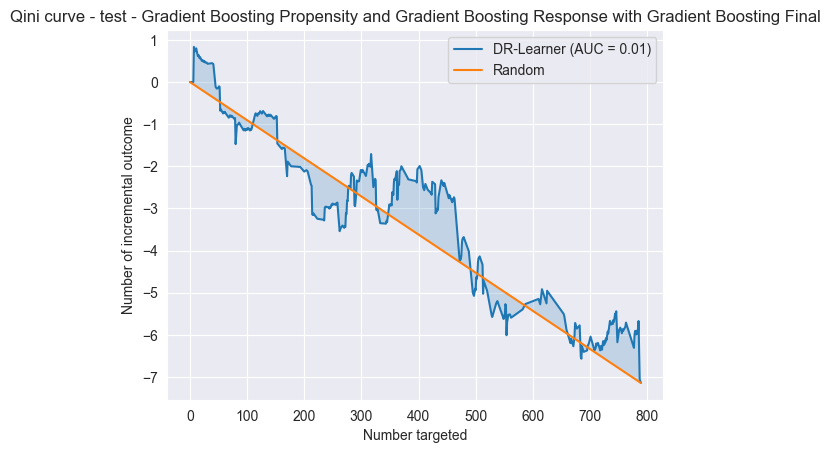

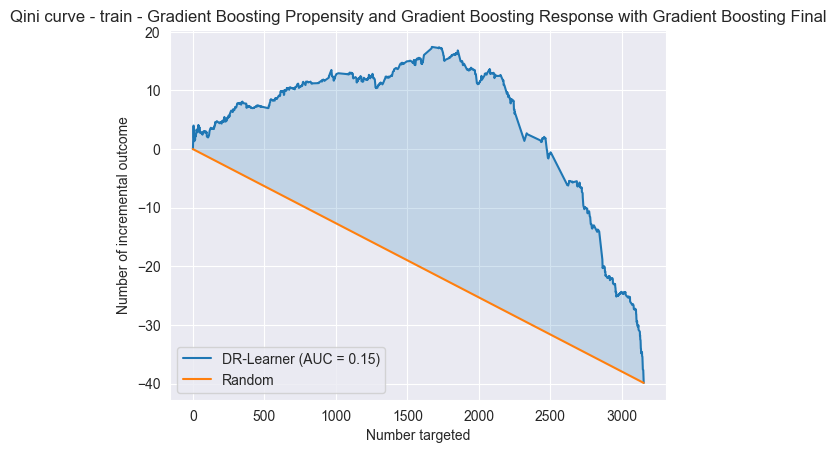

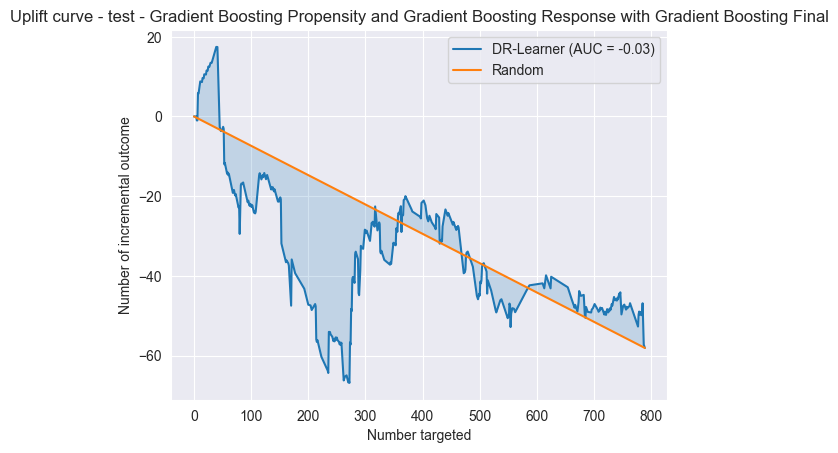

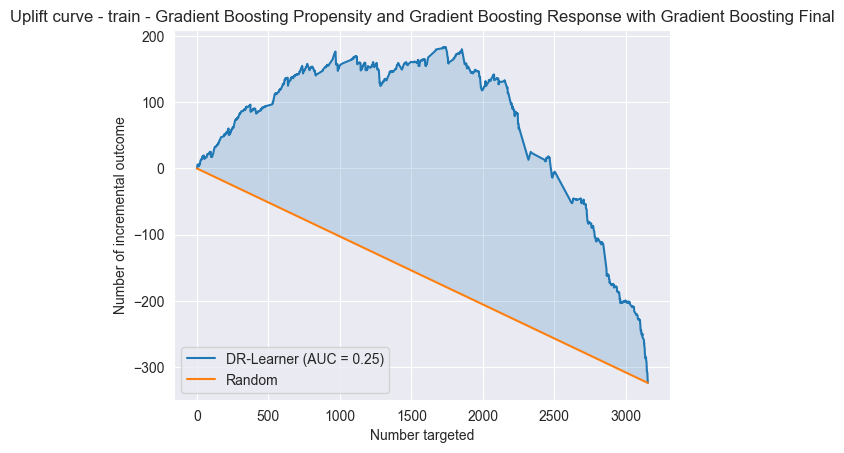

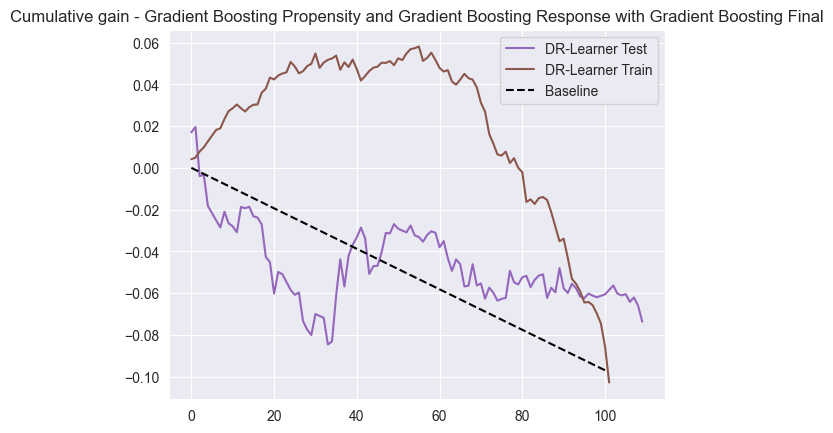

Iteration 5 for Gradient Boosting Propensity and Gradient Boosting Response with Gradient Boosting Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


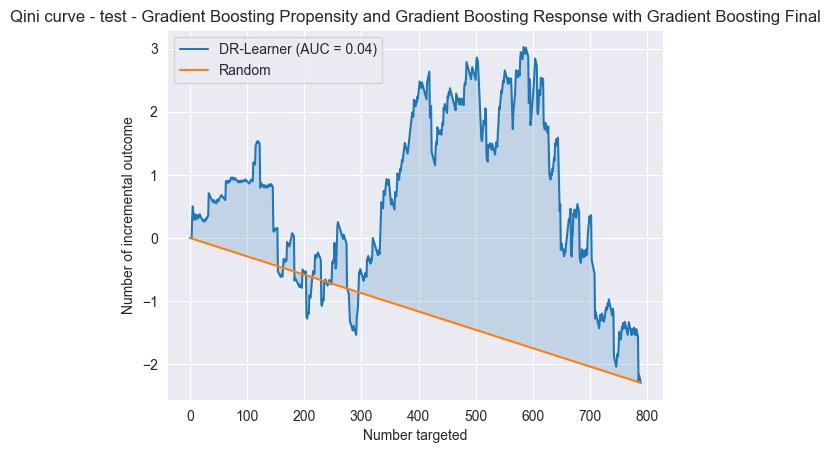

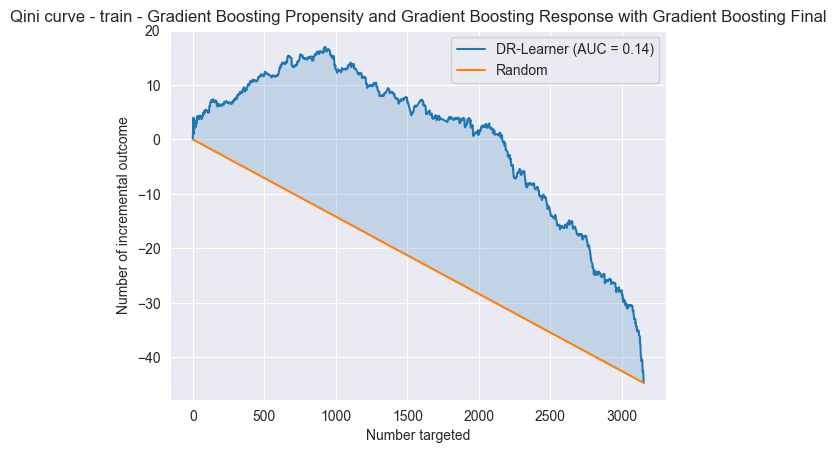

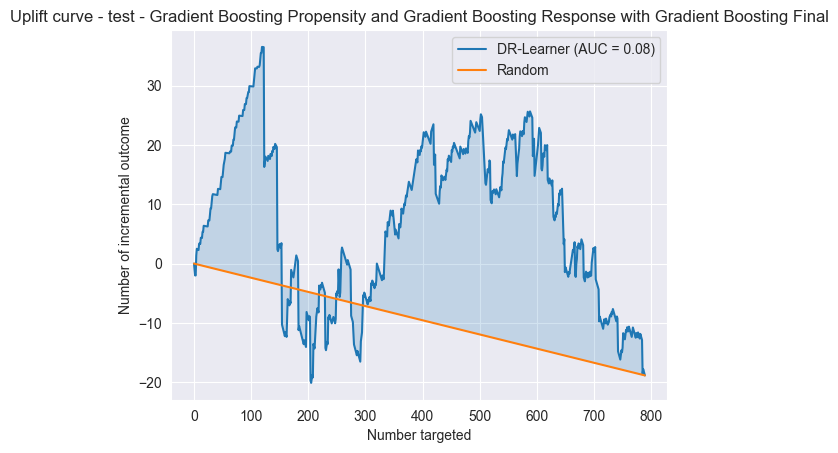

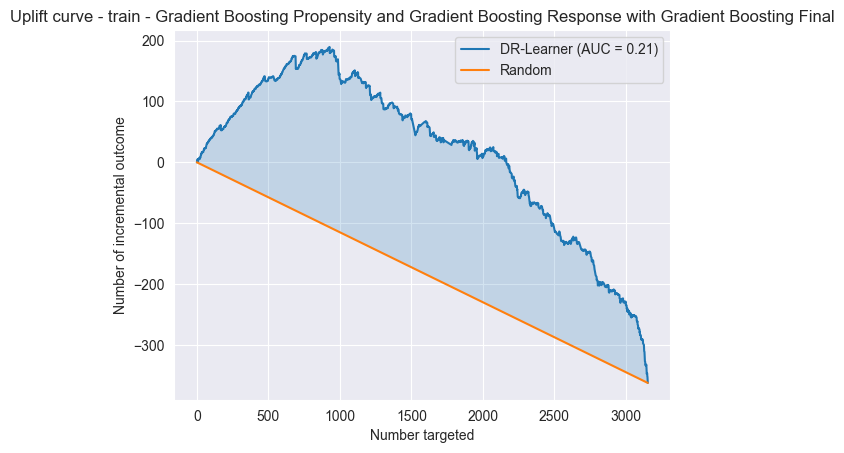

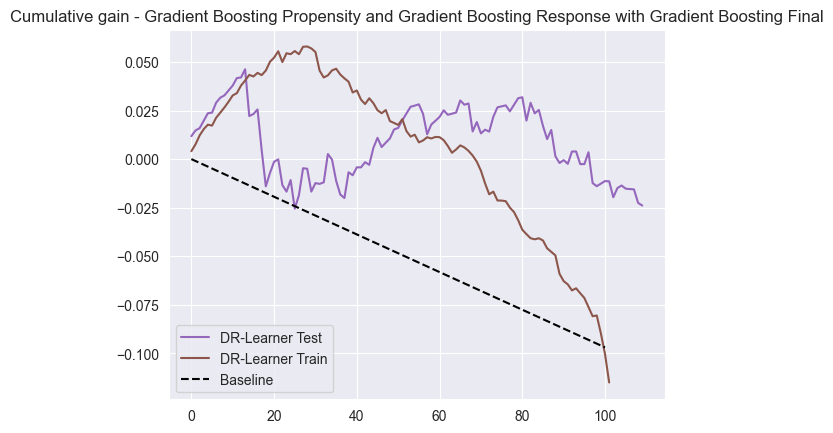

Iteration 6 for Gradient Boosting Propensity and Gradient Boosting Response with Gradient Boosting Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


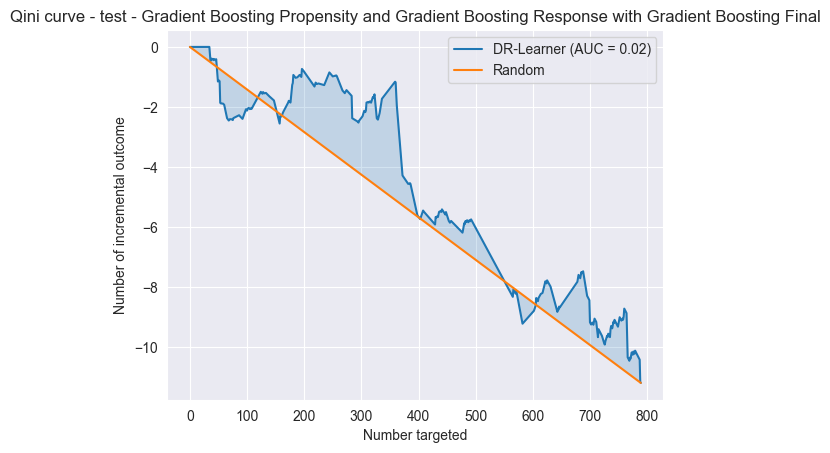

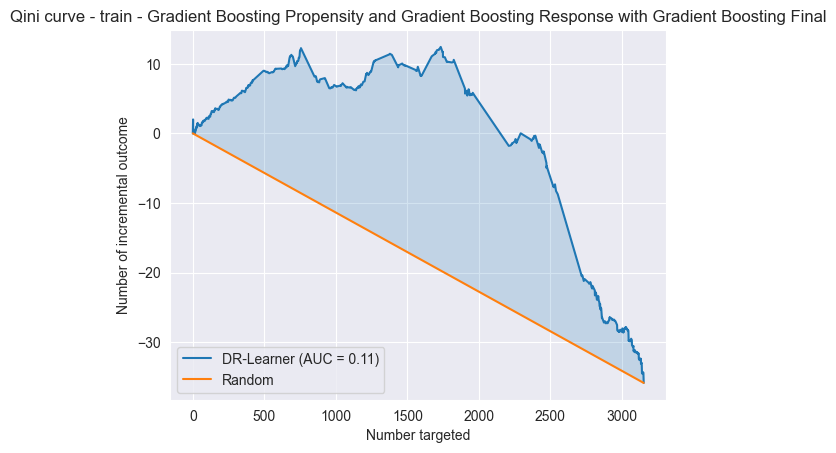

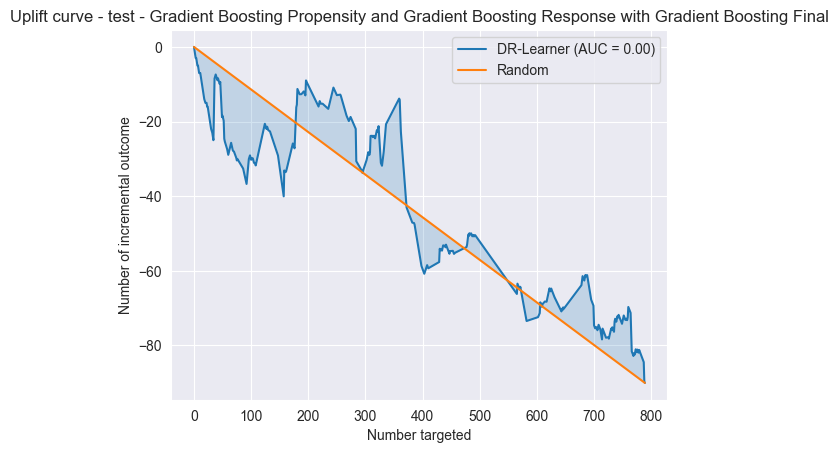

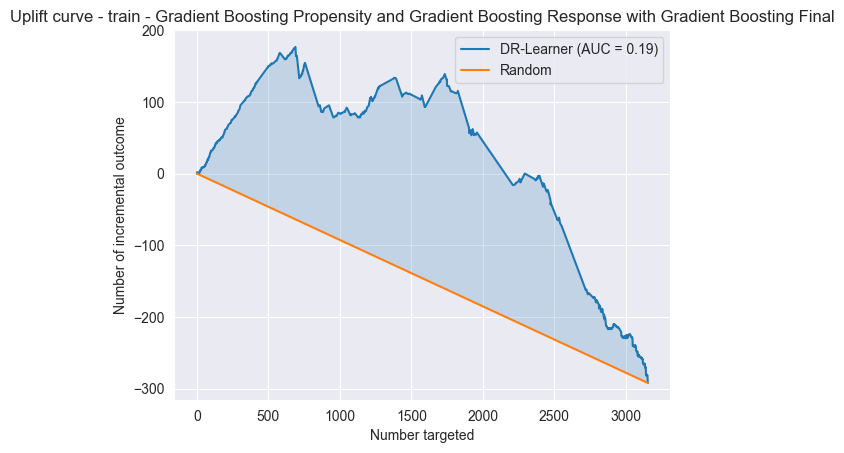

invalid value encountered in scalar divide


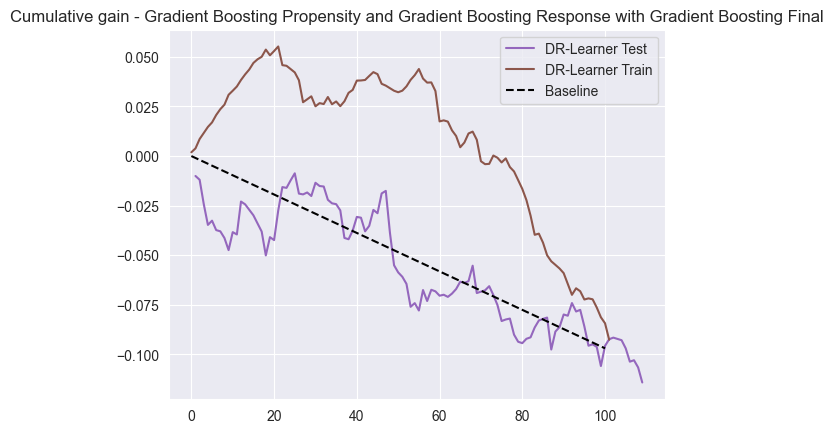

Iteration 7 for Gradient Boosting Propensity and Gradient Boosting Response with Gradient Boosting Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


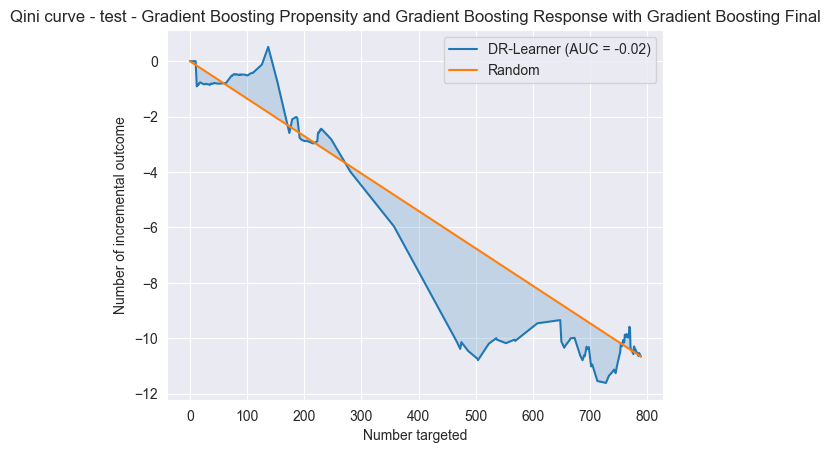

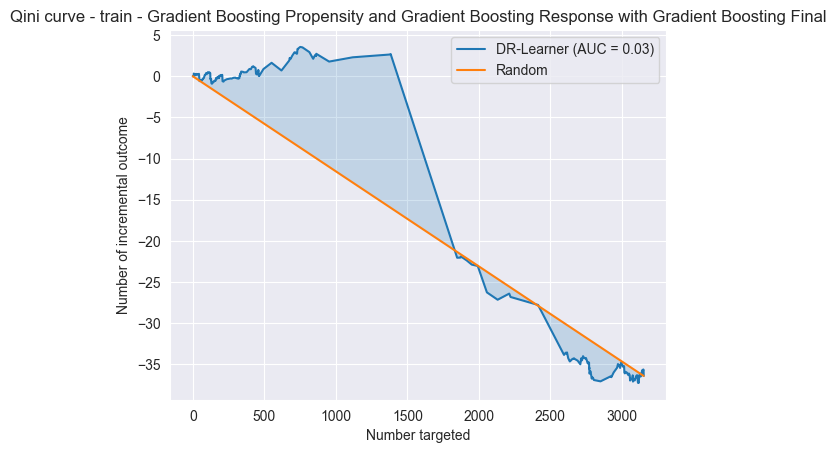

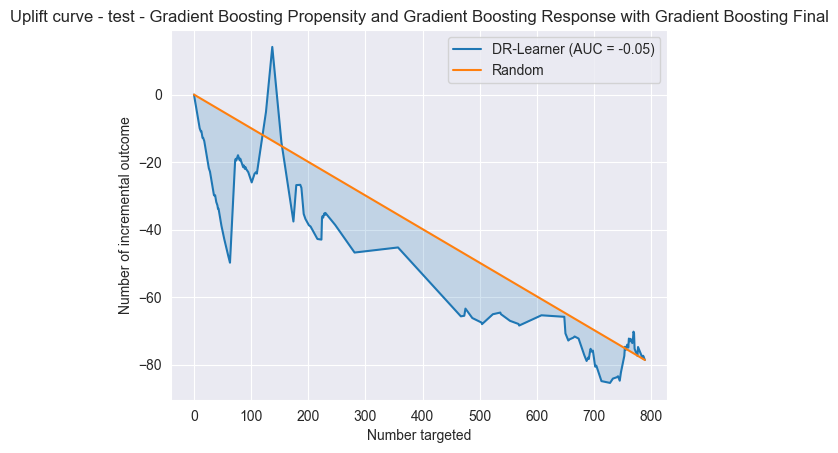

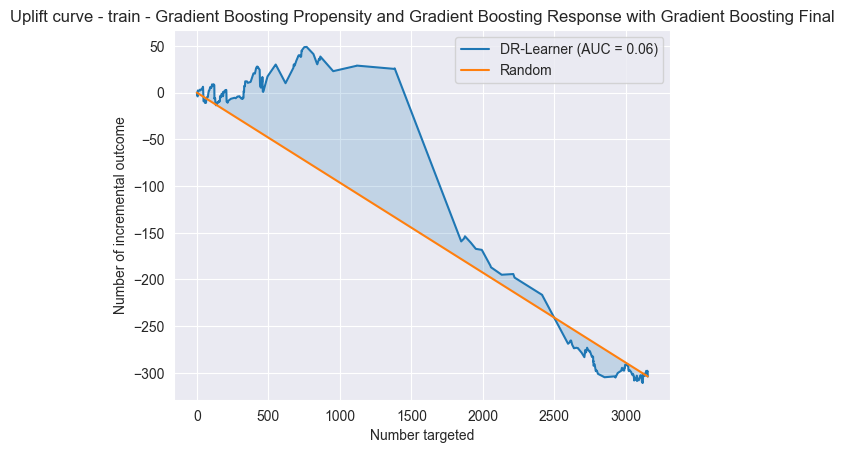

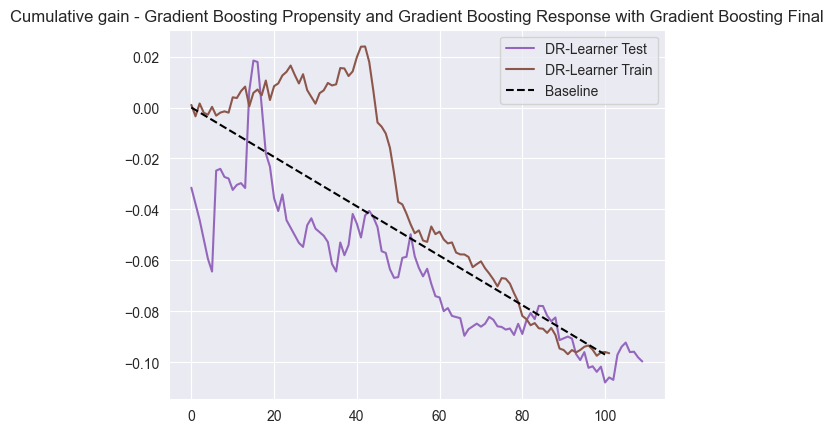

Iteration 8 for Gradient Boosting Propensity and Gradient Boosting Response with Gradient Boosting Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


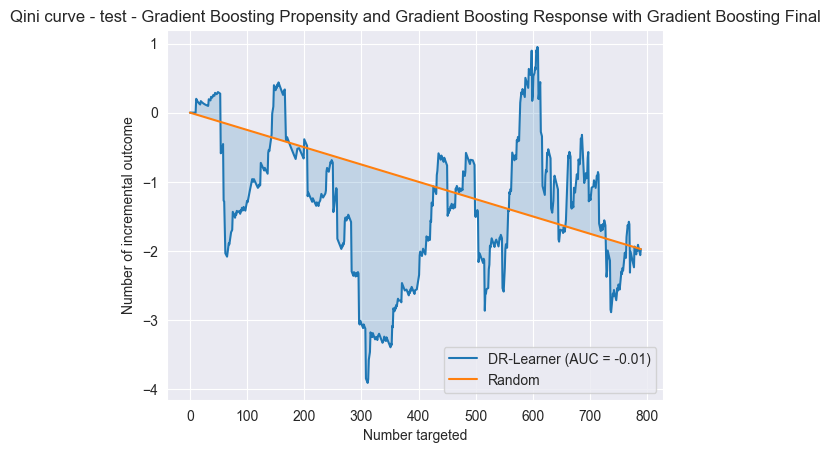

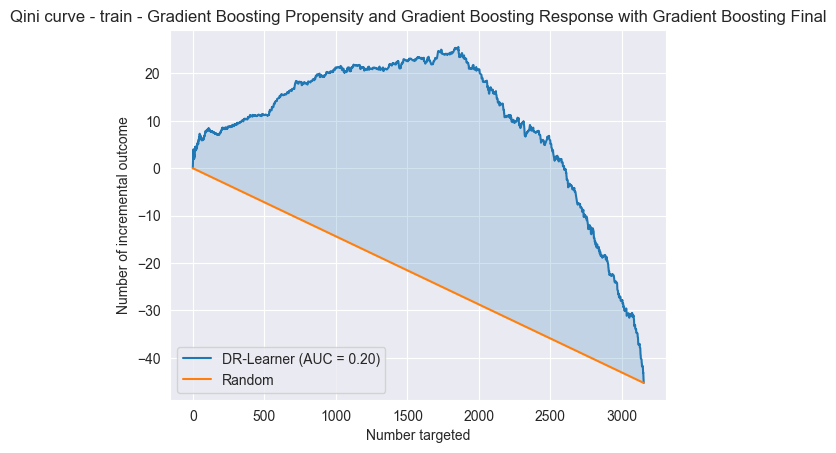

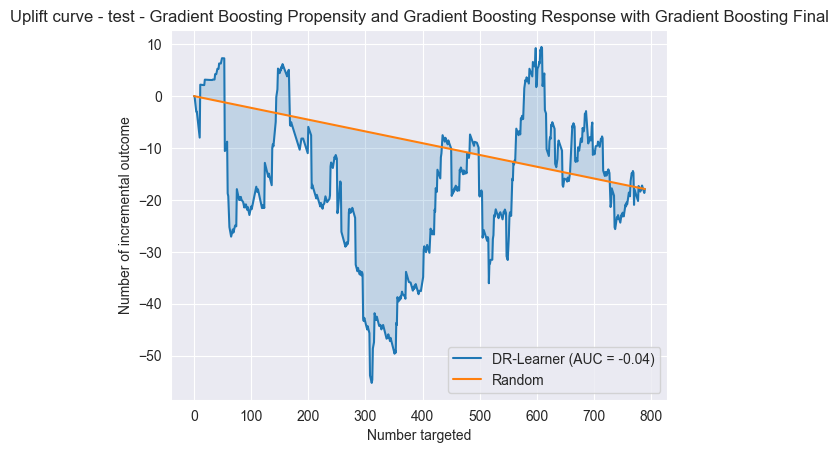

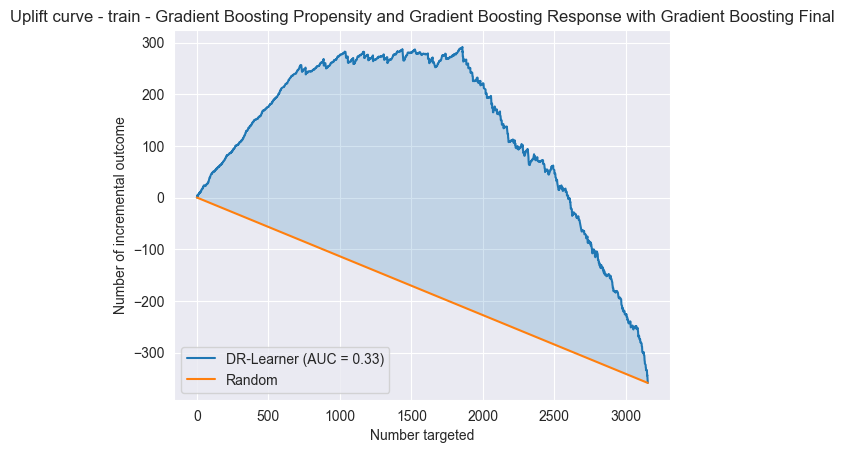

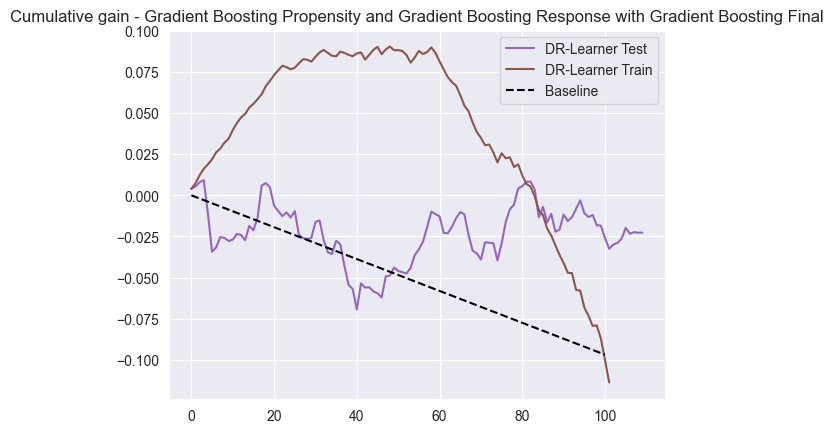

Iteration 9 for Gradient Boosting Propensity and Gradient Boosting Response with Gradient Boosting Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


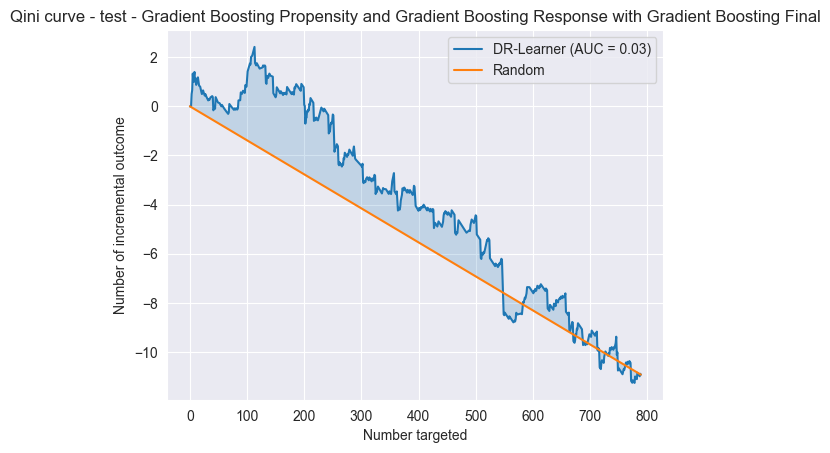

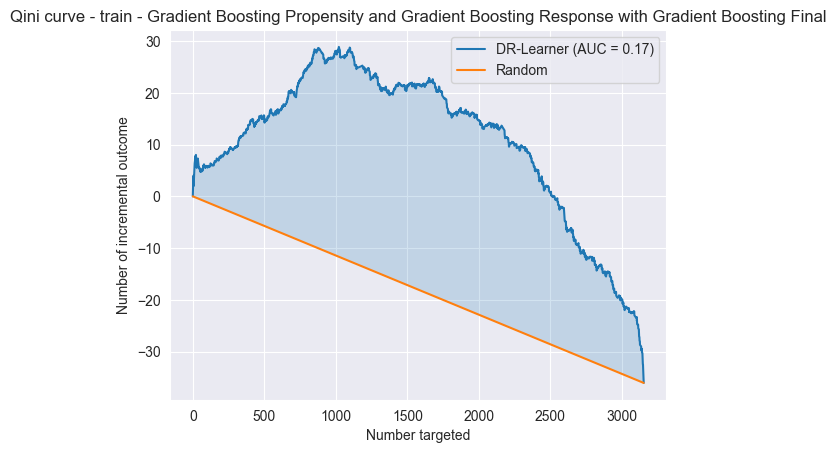

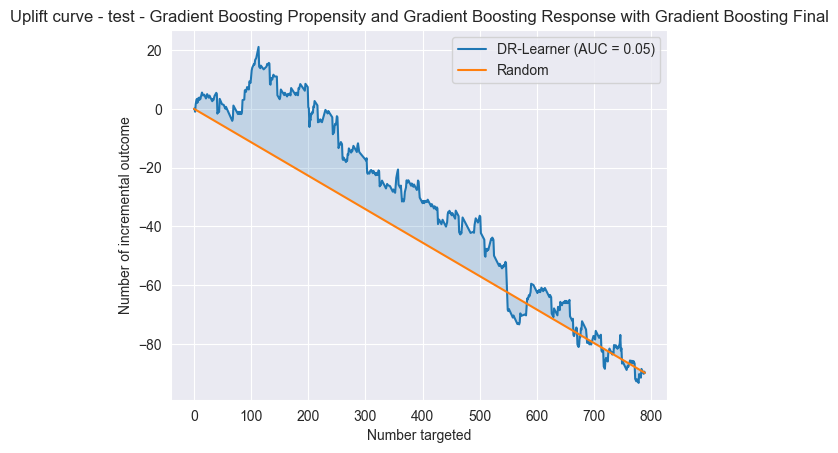

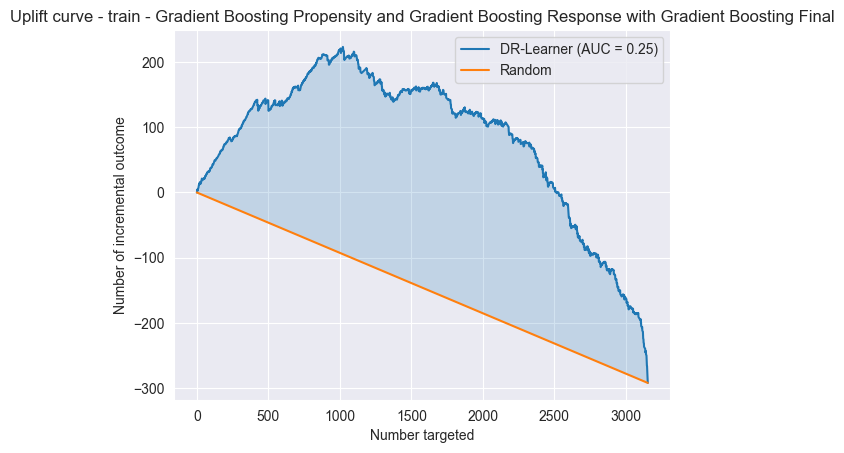

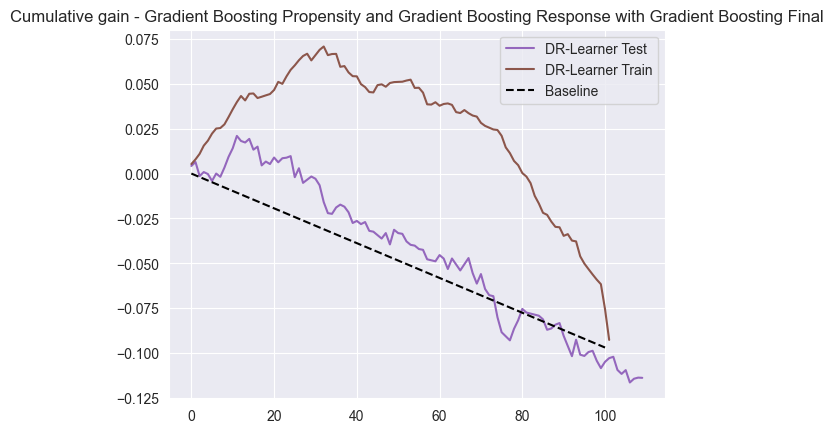

Results for Gradient Boosting Propensity and Gradient Boosting Response with Gradient Boosting Final:
Average Train Qini AUC: 0.129593, Average Test Qini AUC: 0.018670
Average Train Uplift AUC: 0.210816, Average Test Uplift AUC: 0.006058

Iteration 0 for K-Nearest Neighbors Propensity and Gradient Boosting Response with Gradient Boosting Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


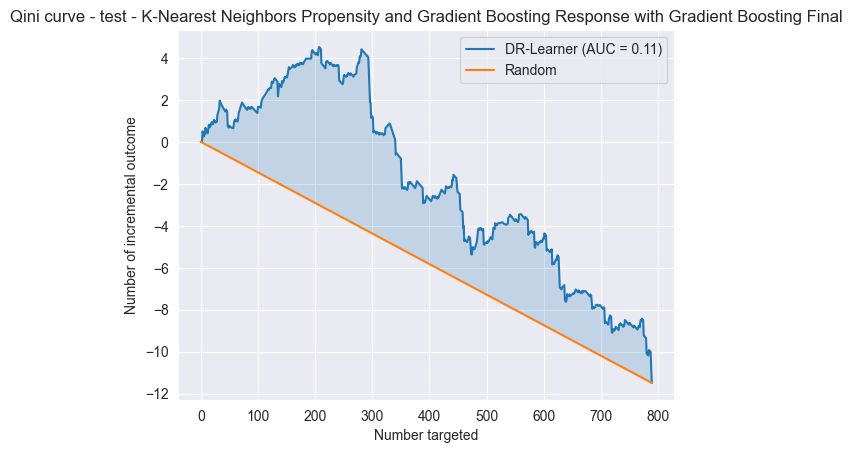

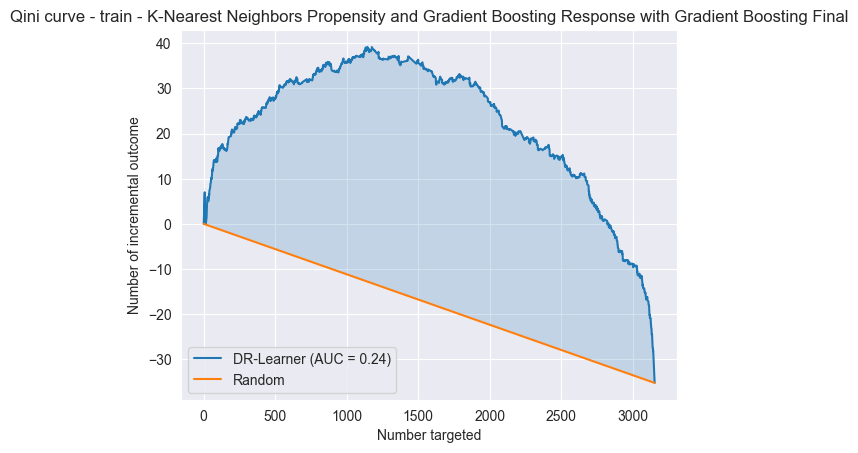

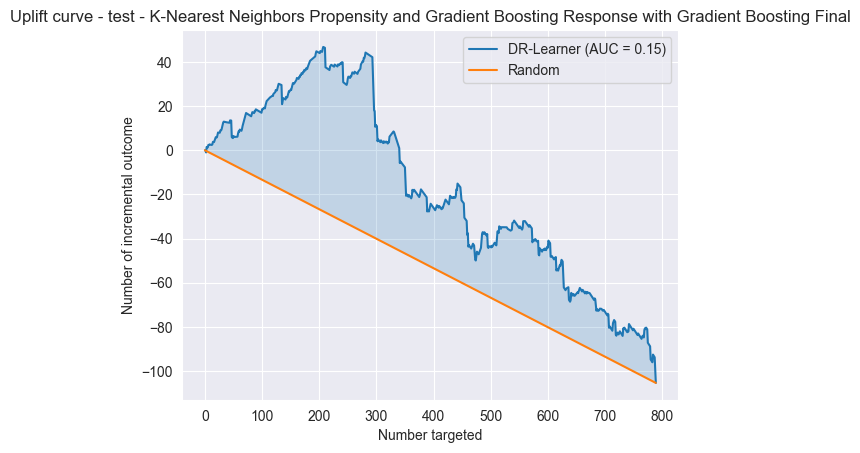

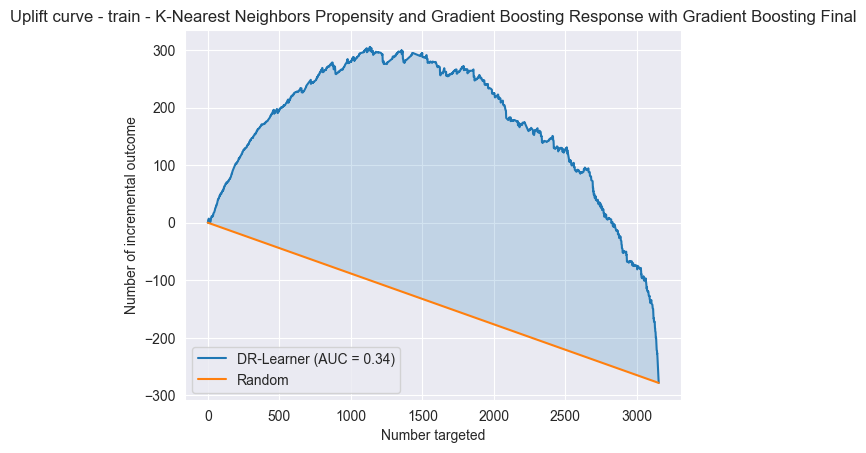

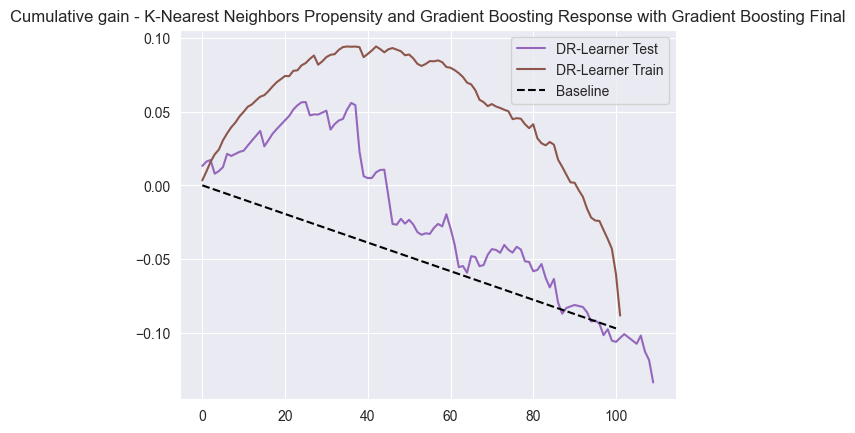

Iteration 1 for K-Nearest Neighbors Propensity and Gradient Boosting Response with Gradient Boosting Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


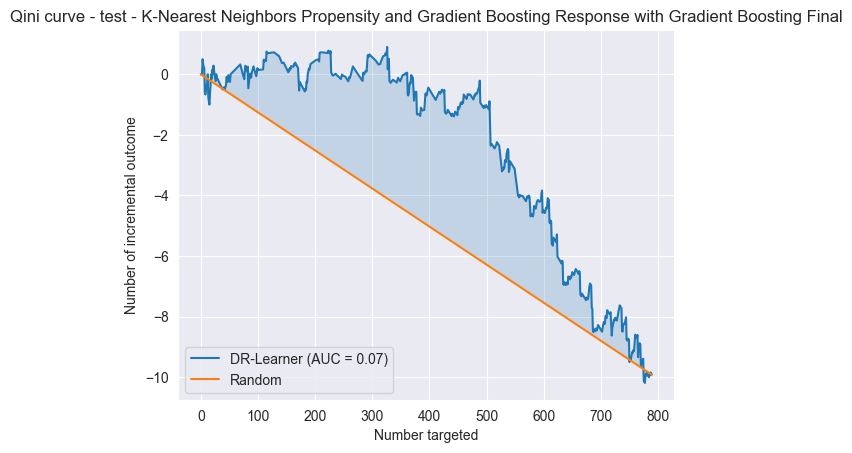

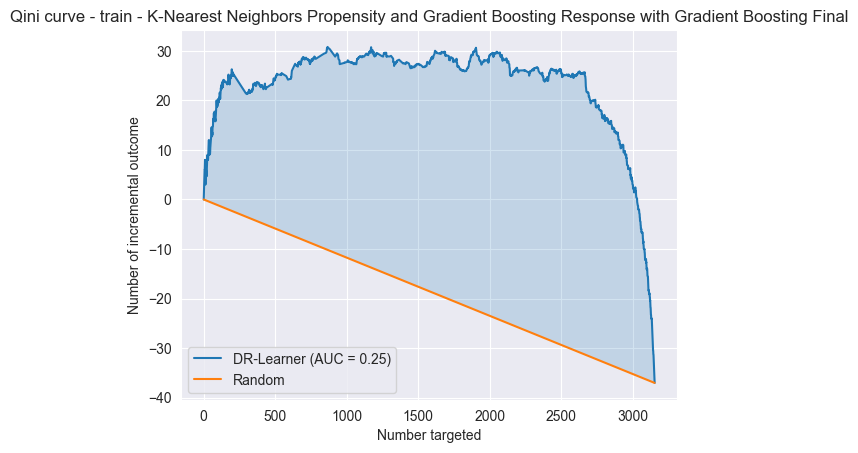

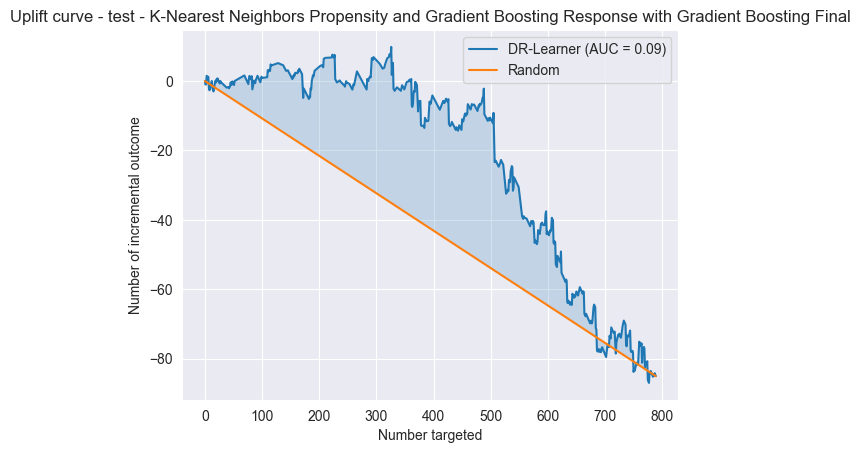

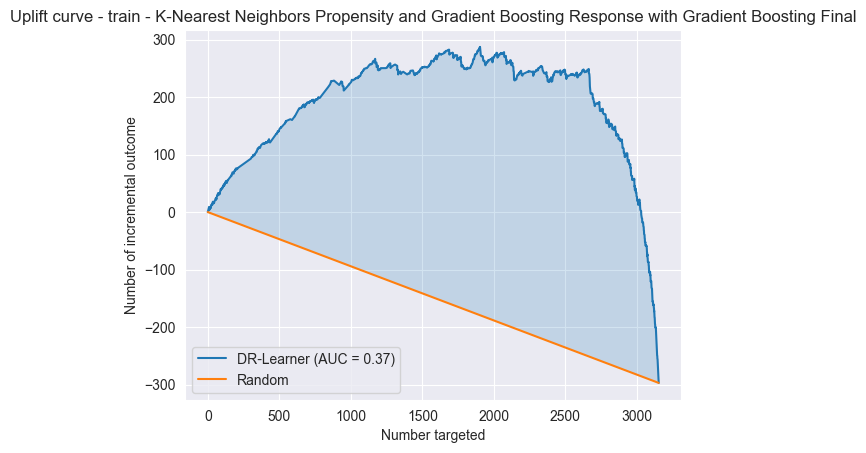

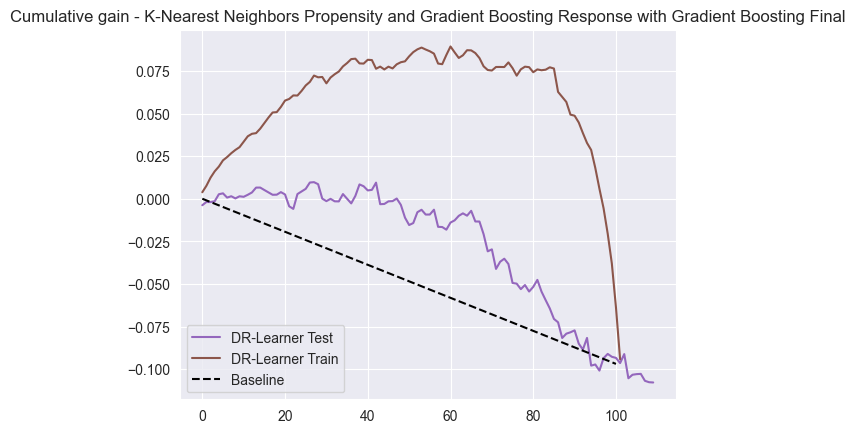

Iteration 2 for K-Nearest Neighbors Propensity and Gradient Boosting Response with Gradient Boosting Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


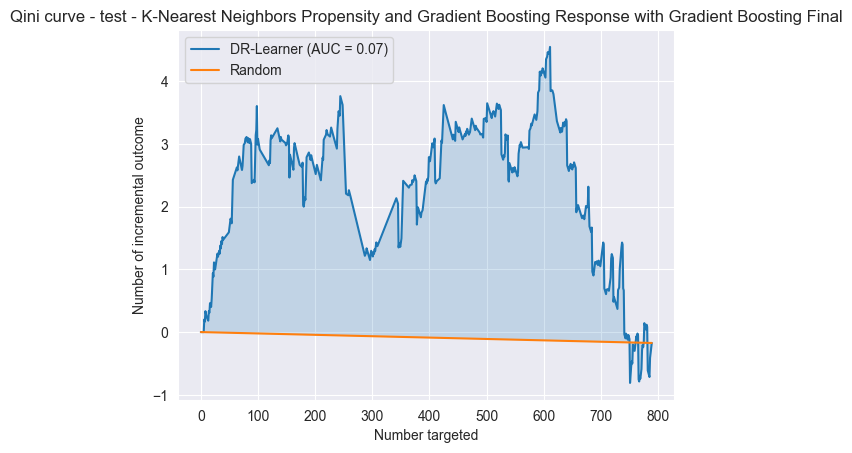

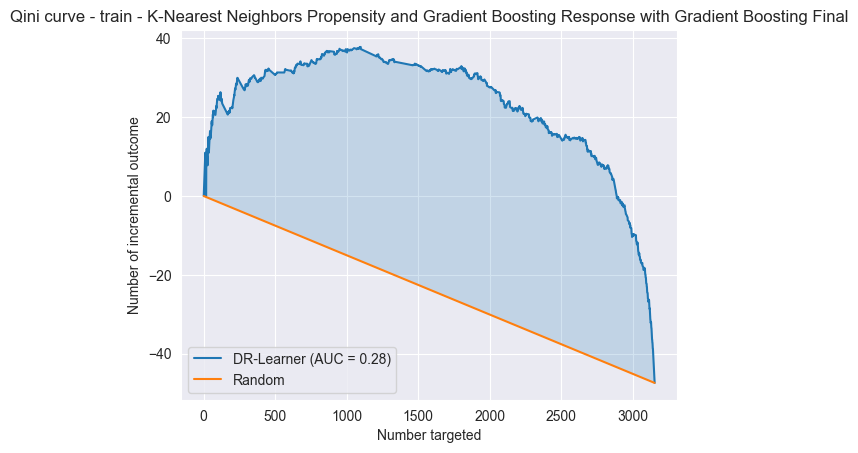

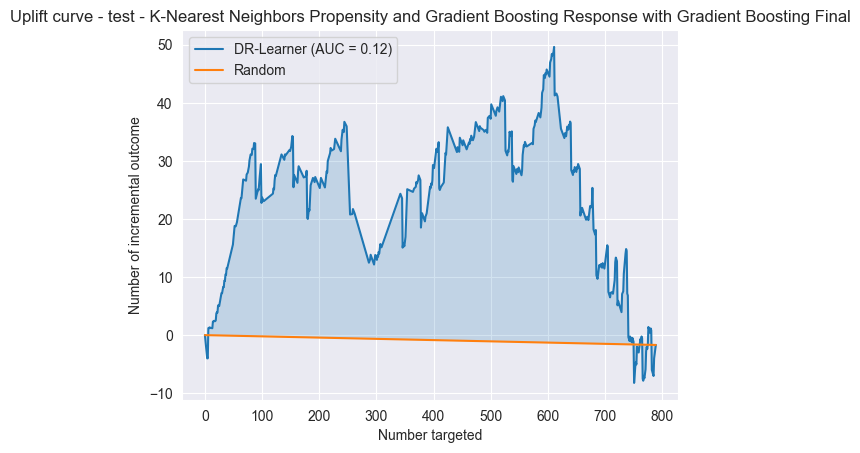

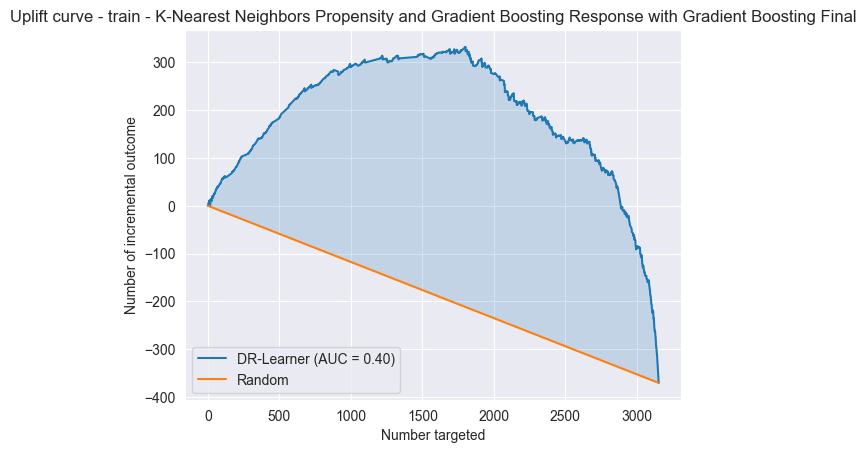

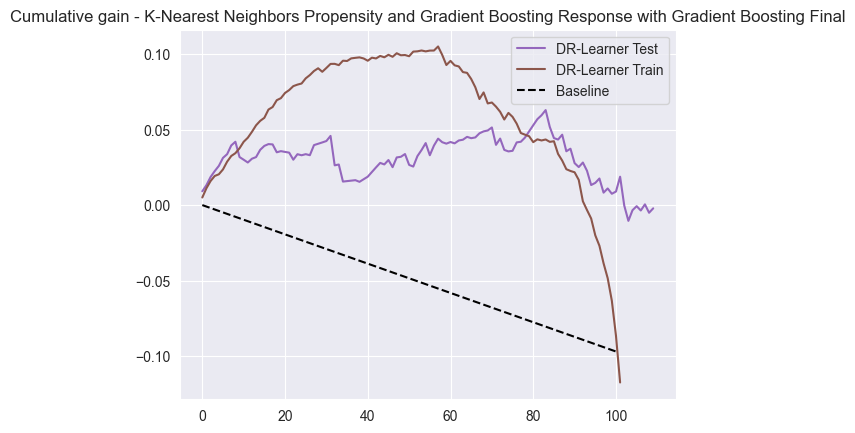

Iteration 3 for K-Nearest Neighbors Propensity and Gradient Boosting Response with Gradient Boosting Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


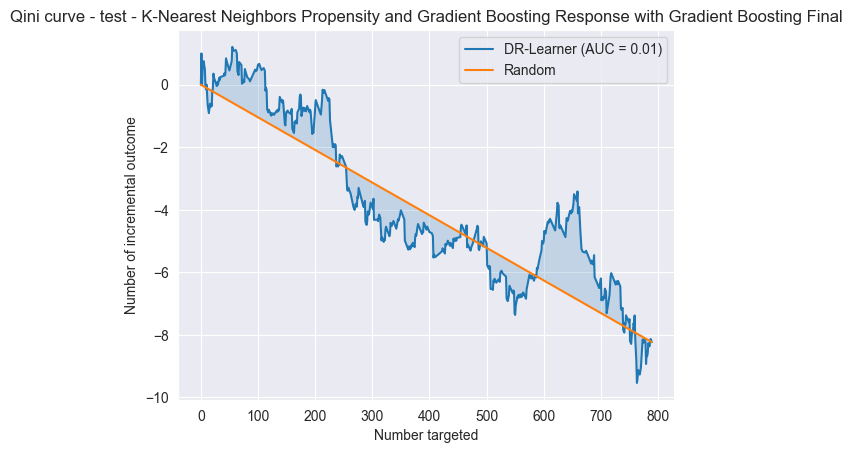

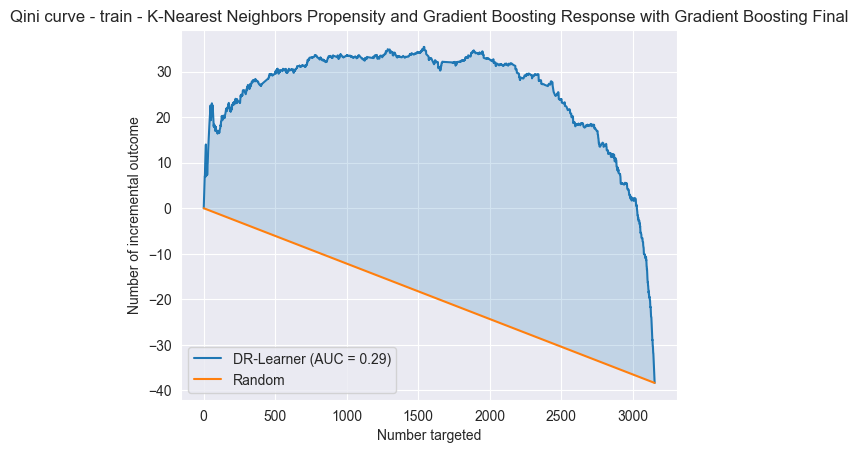

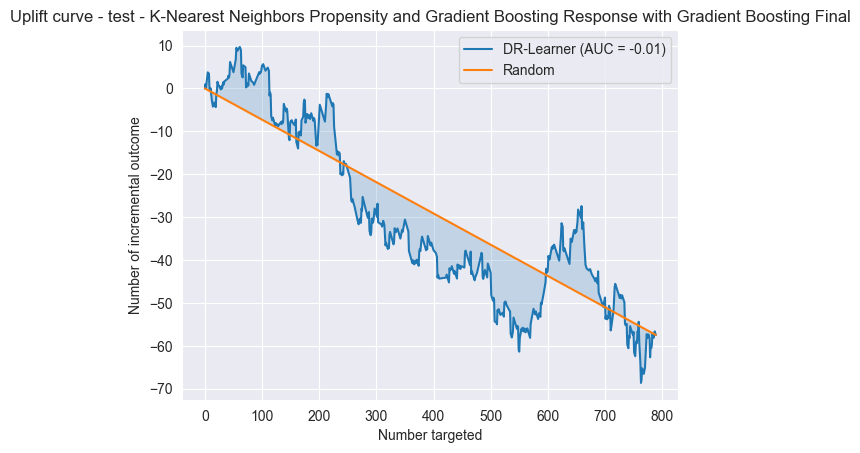

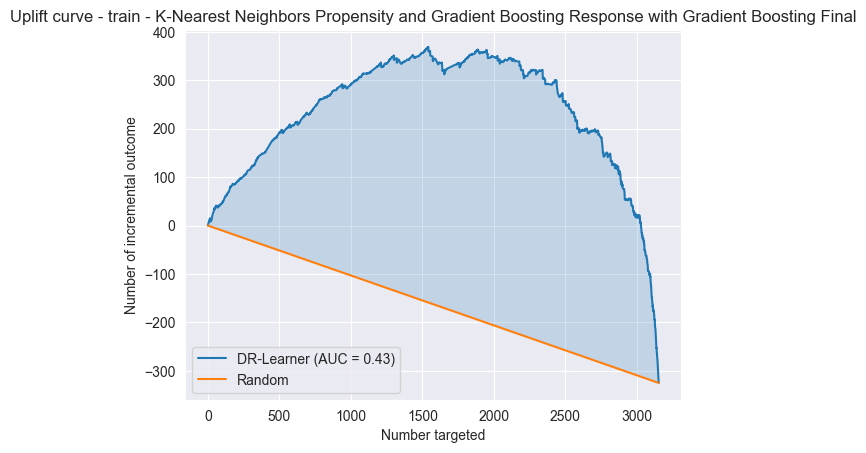

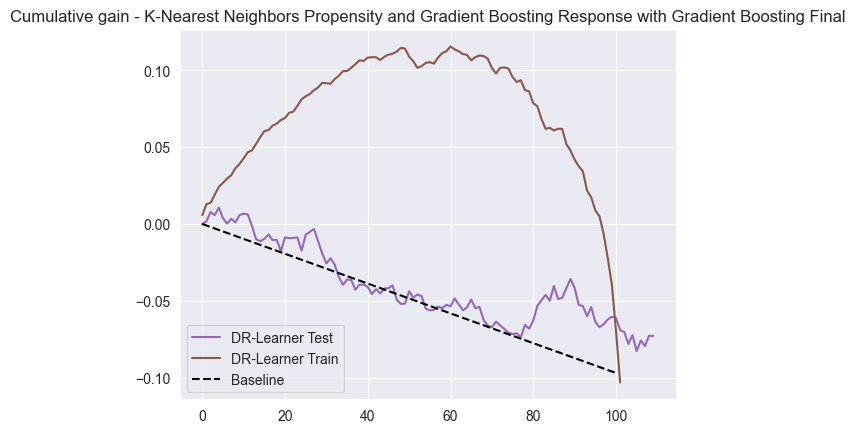

Iteration 4 for K-Nearest Neighbors Propensity and Gradient Boosting Response with Gradient Boosting Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


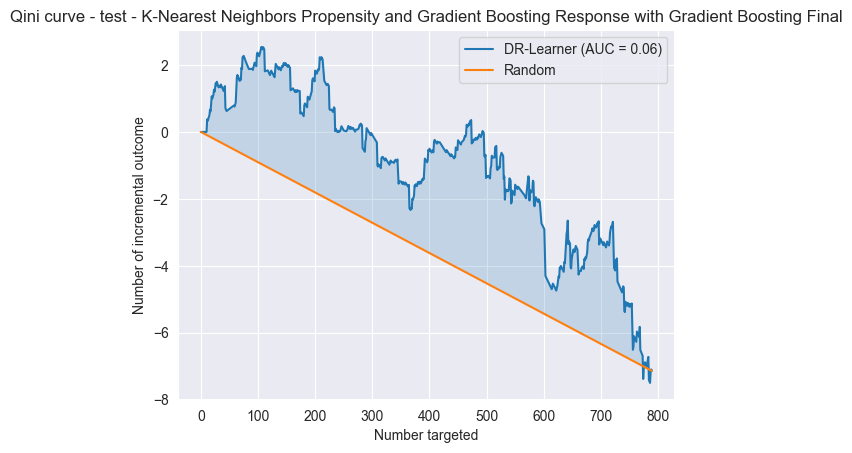

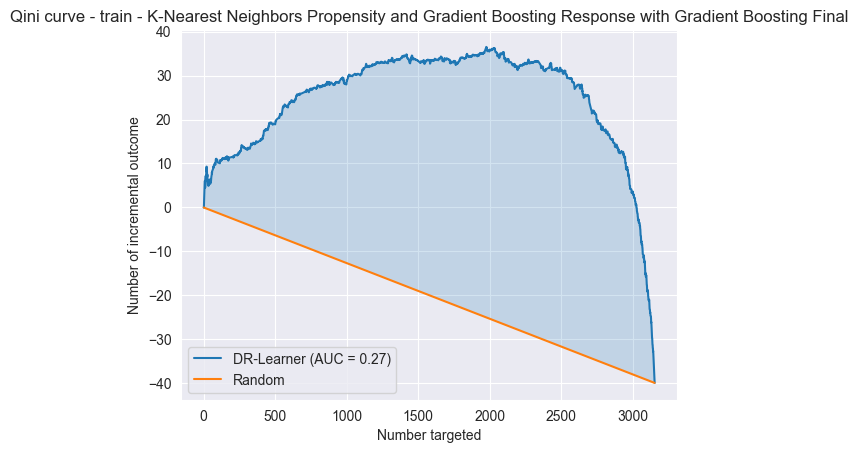

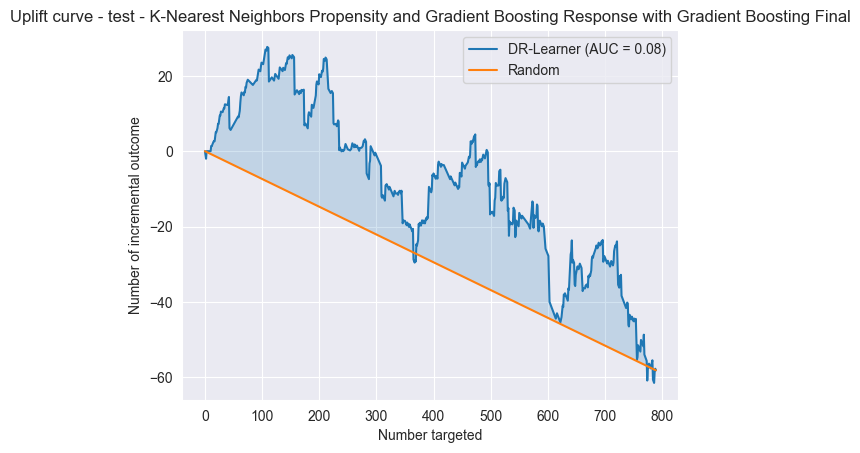

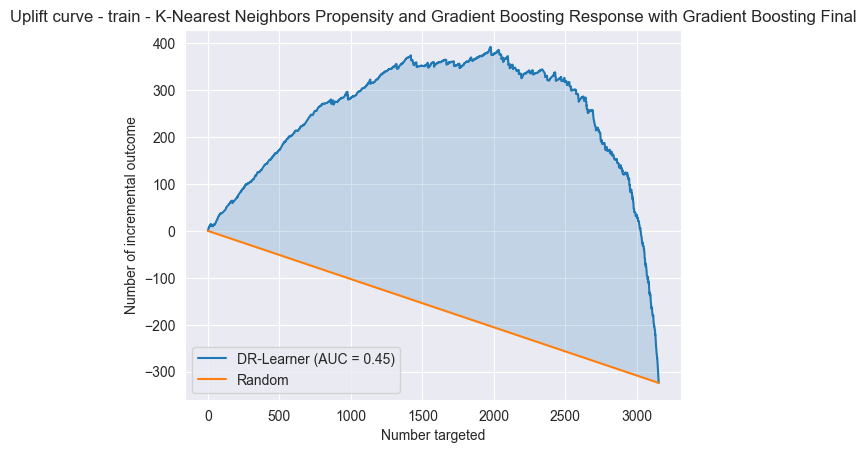

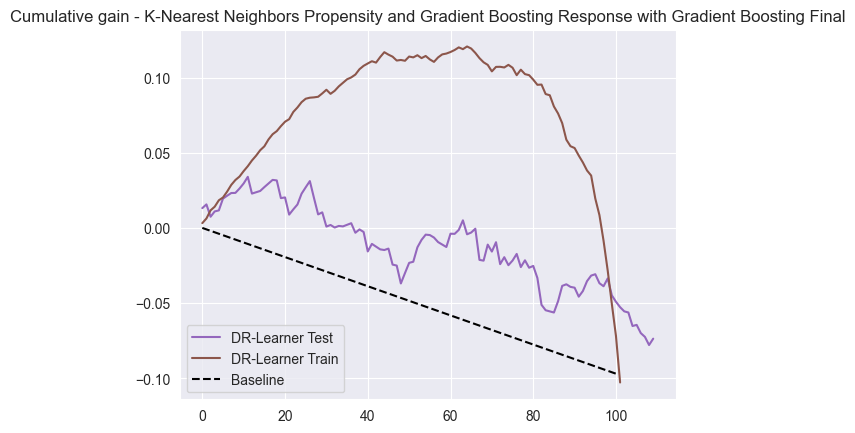

Iteration 5 for K-Nearest Neighbors Propensity and Gradient Boosting Response with Gradient Boosting Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


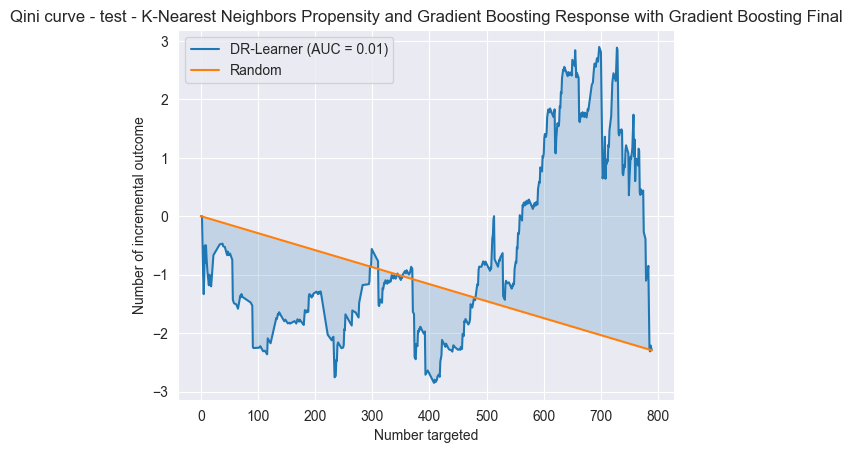

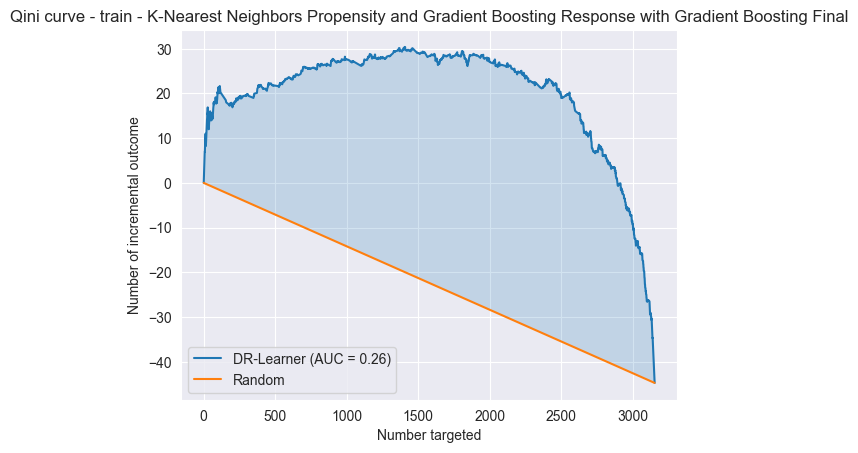

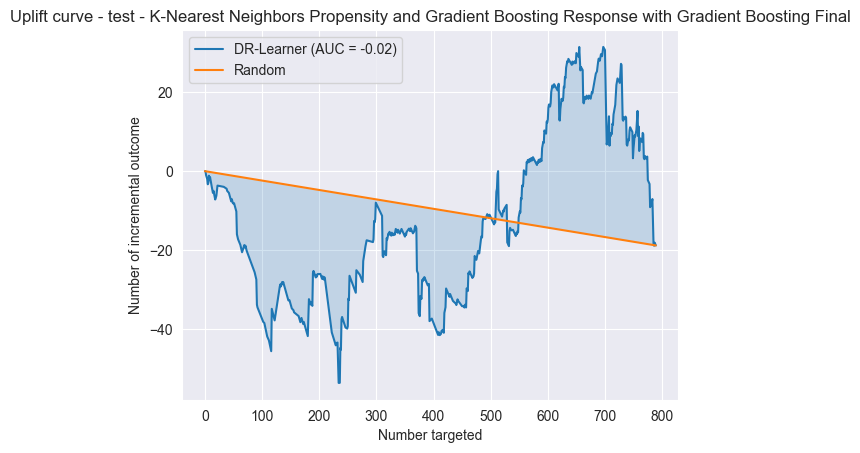

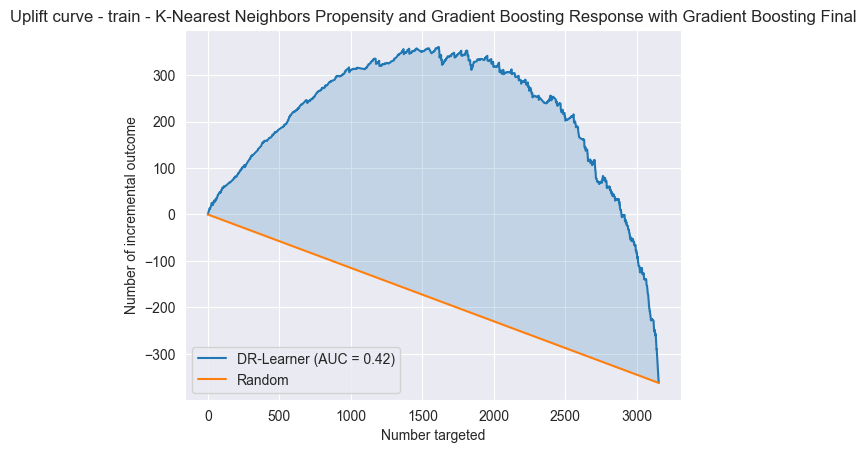

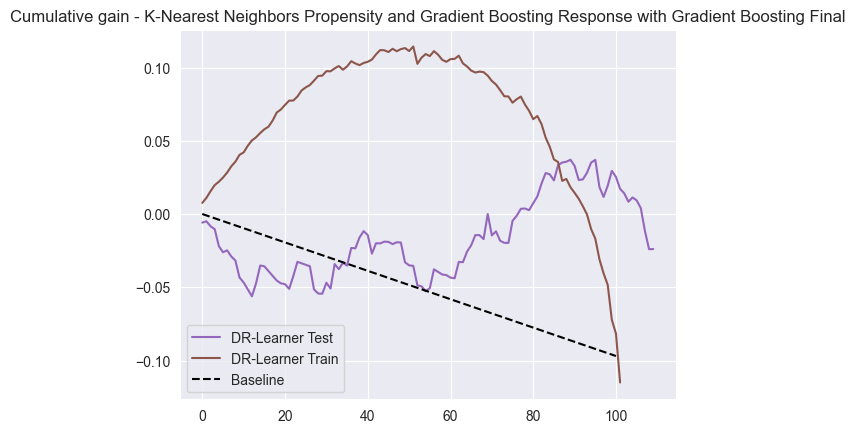

Iteration 6 for K-Nearest Neighbors Propensity and Gradient Boosting Response with Gradient Boosting Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


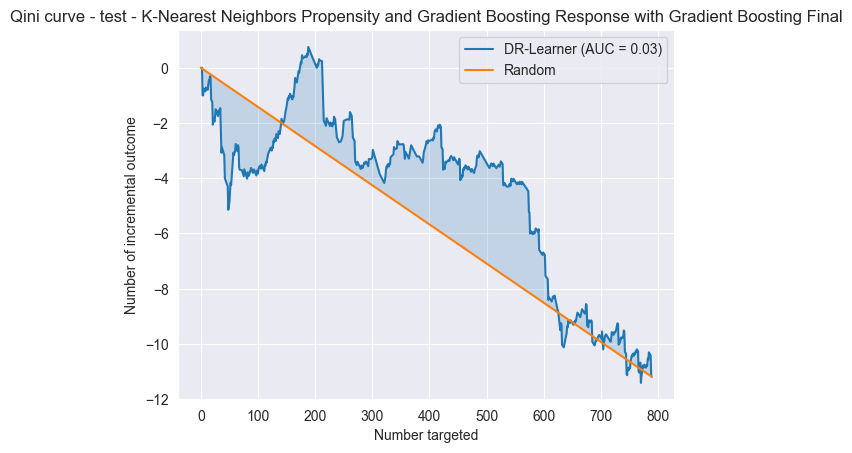

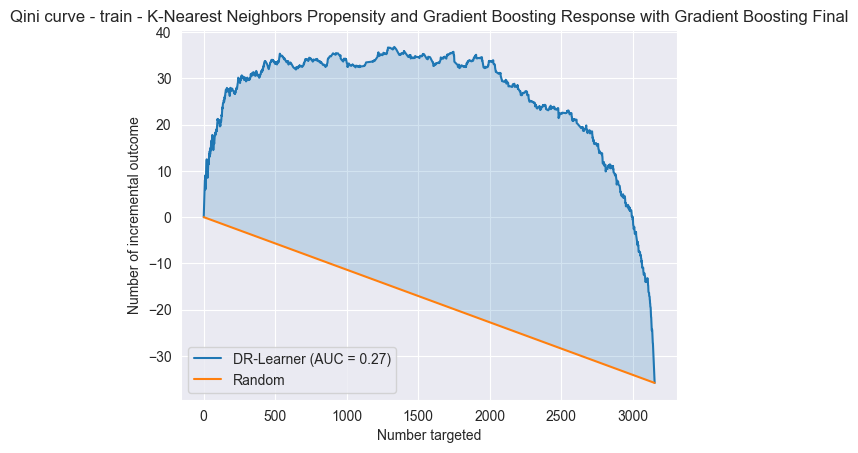

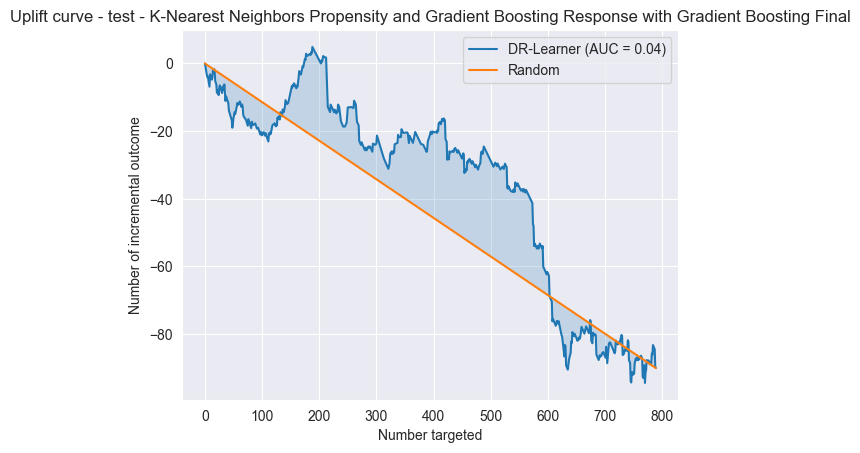

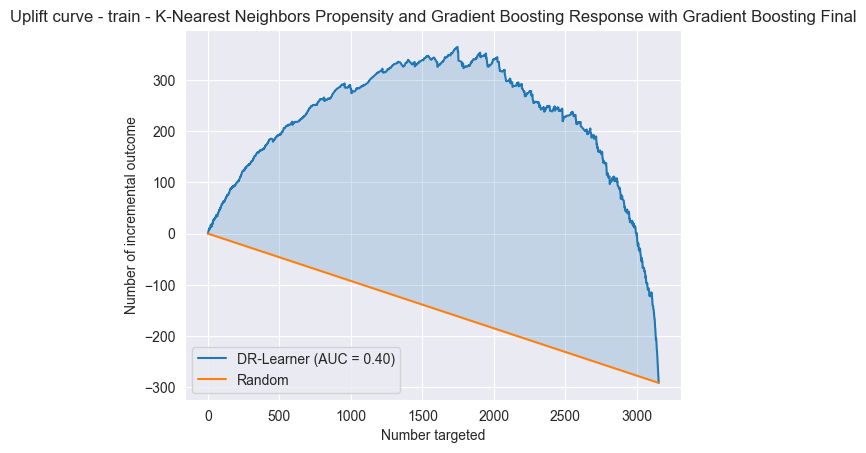

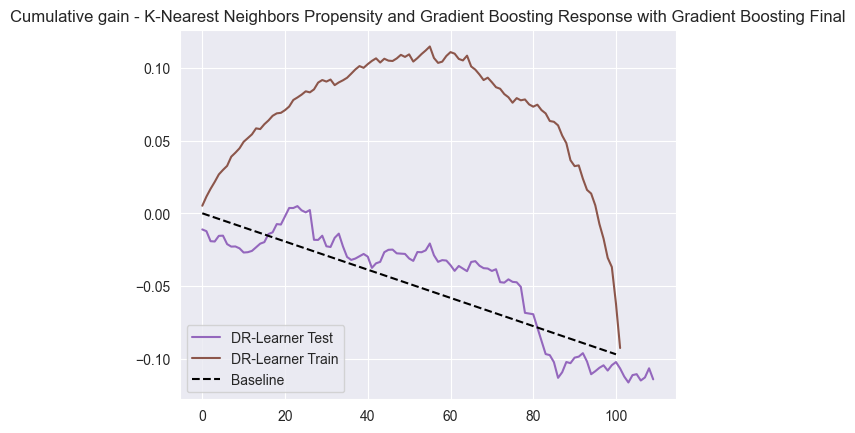

Iteration 7 for K-Nearest Neighbors Propensity and Gradient Boosting Response with Gradient Boosting Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


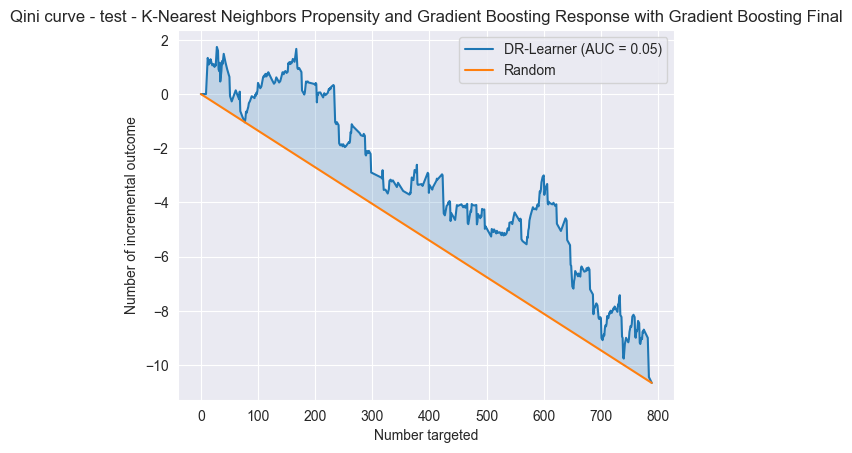

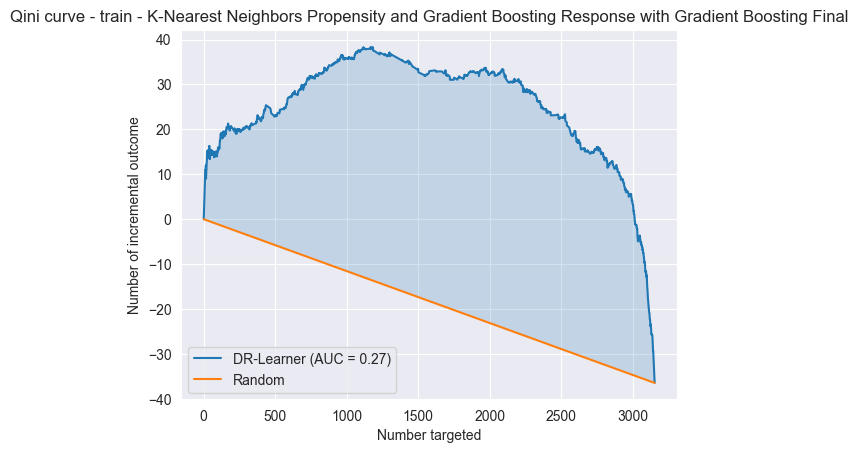

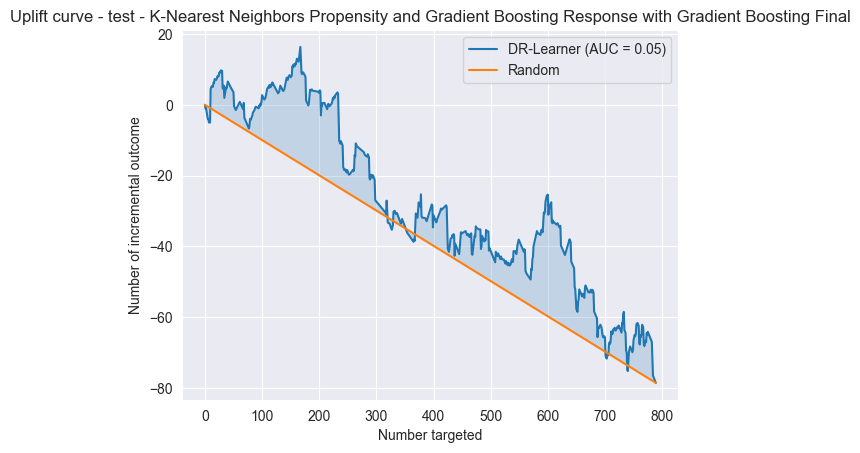

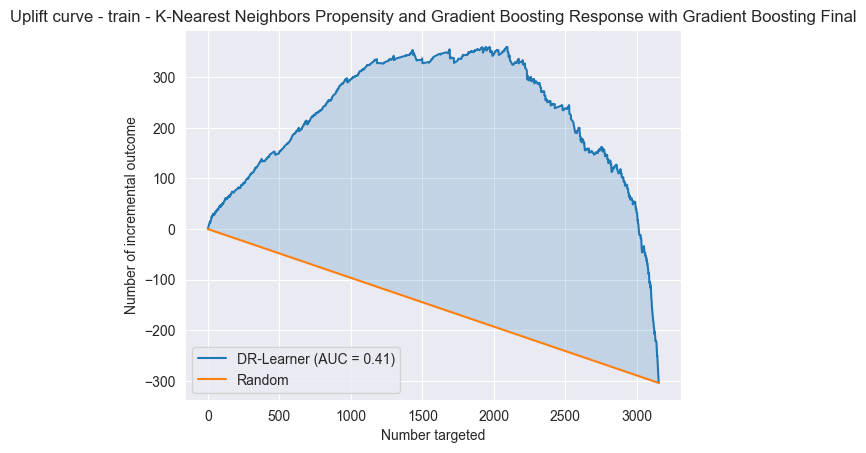

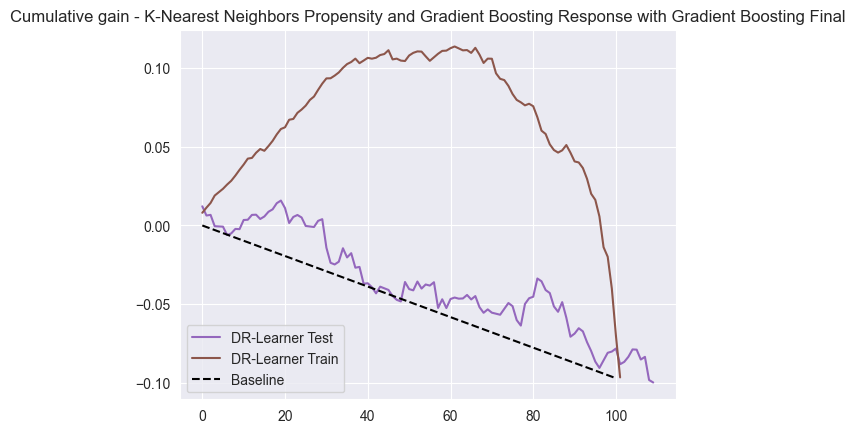

Iteration 8 for K-Nearest Neighbors Propensity and Gradient Boosting Response with Gradient Boosting Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


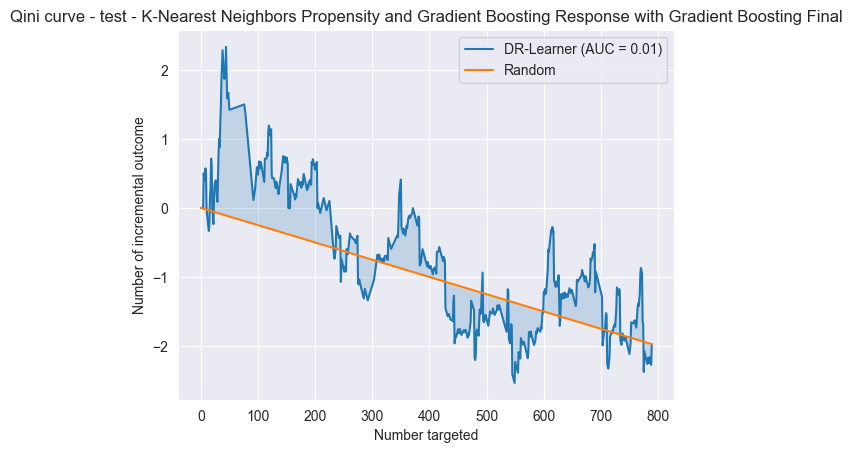

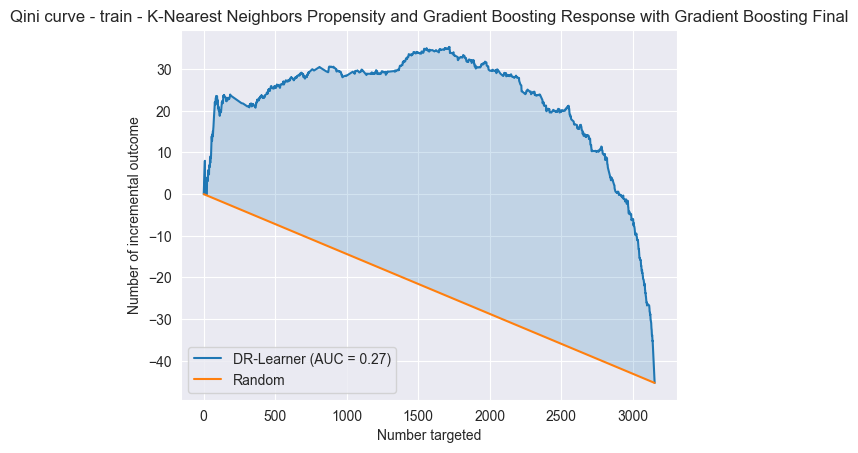

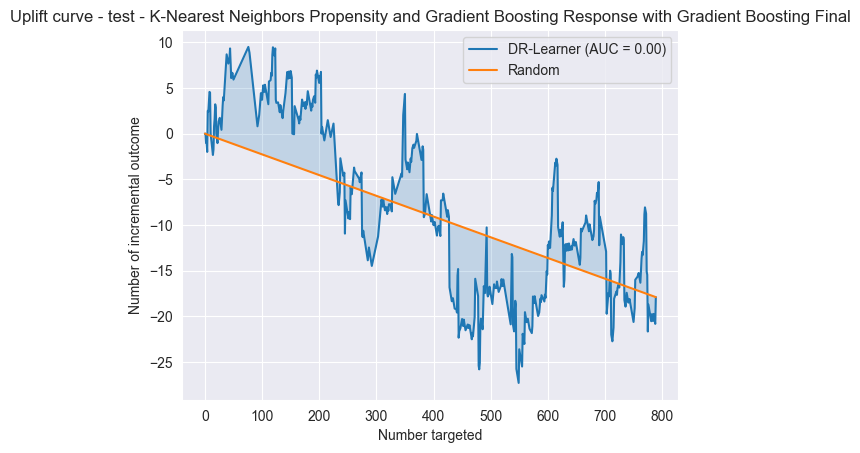

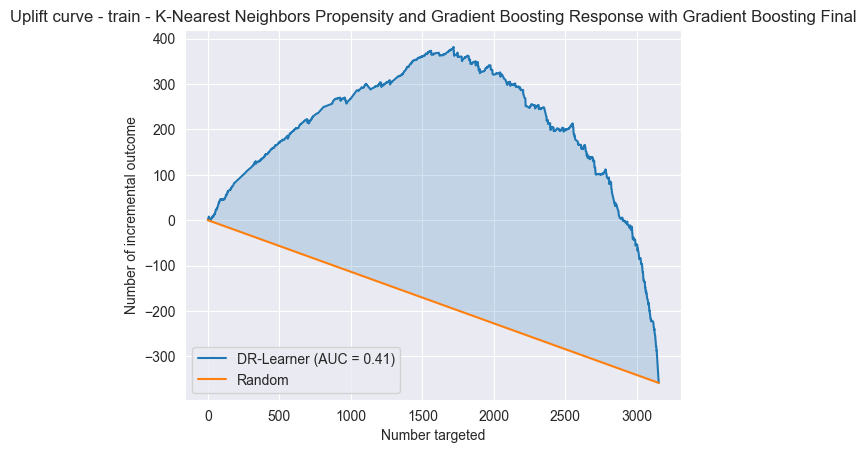

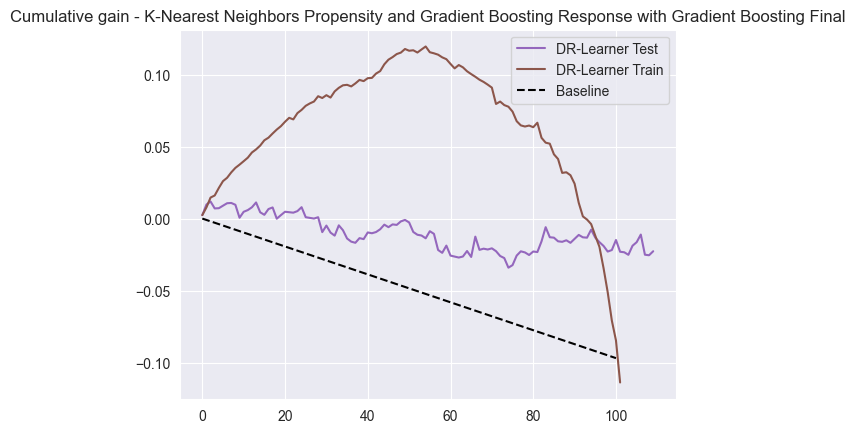

Iteration 9 for K-Nearest Neighbors Propensity and Gradient Boosting Response with Gradient Boosting Final


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


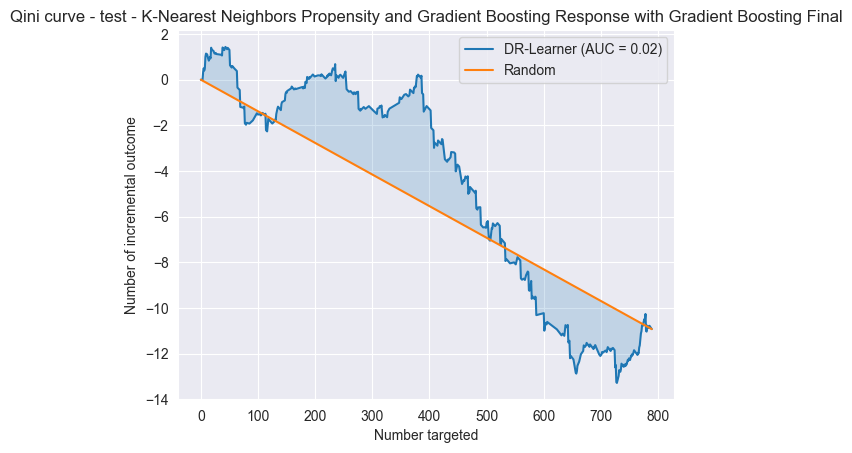

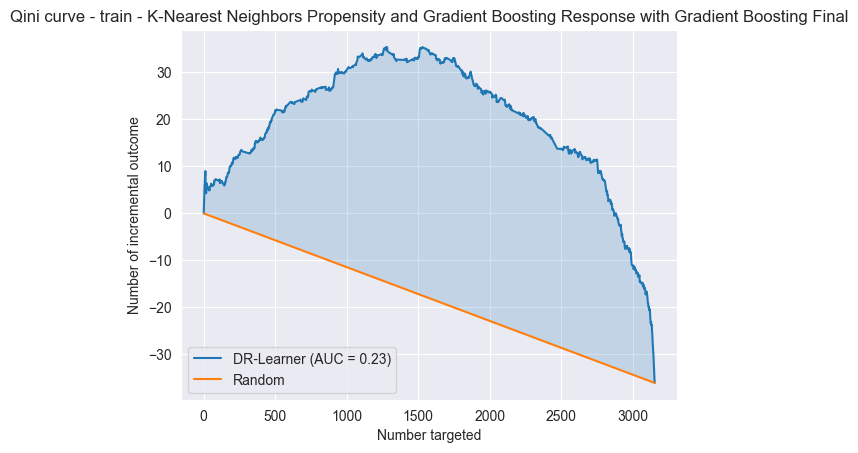

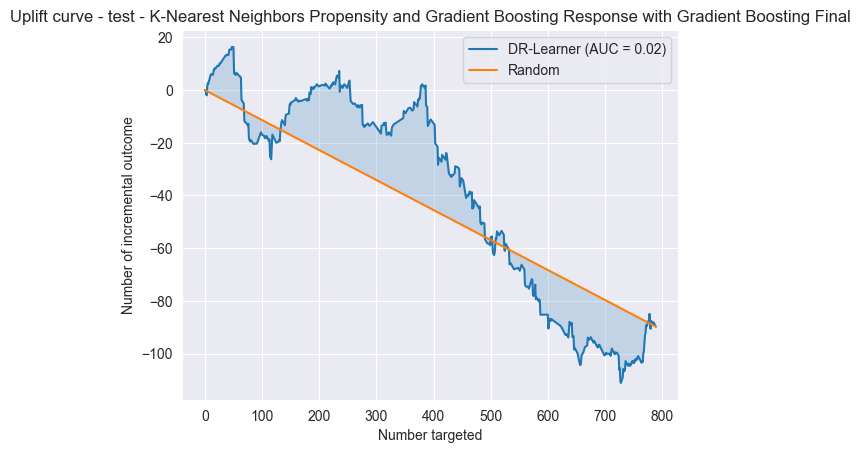

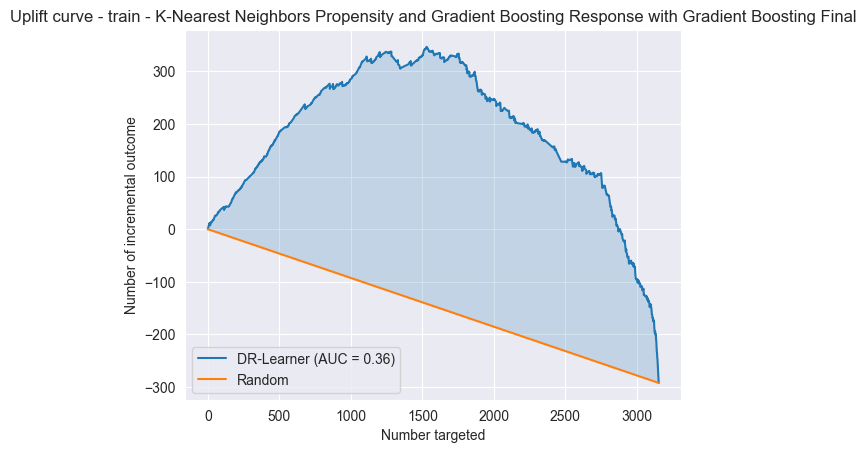

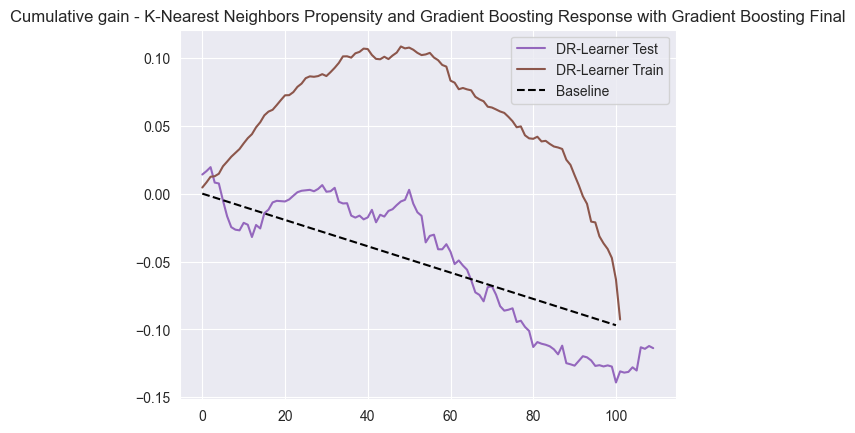

Results for K-Nearest Neighbors Propensity and Gradient Boosting Response with Gradient Boosting Final:
Average Train Qini AUC: 0.263782, Average Test Qini AUC: 0.042217
Average Train Uplift AUC: 0.397998, Average Test Uplift AUC: 0.054072



In [33]:
# Evaluate each configuration
for model_name, models in configurations.items():
    propensity_model = models['propensity']
    regression_model = models['regression']
    final_model = models['final']
    
    # Calibrate the propensity model
    calibrated_propensity_model = CalibratedClassifierCV(propensity_model, method='isotonic', cv=5)

    results = eval_model(calibrated_propensity_model, regression_model, final_model, X, Y, T, selected_features, model_name)

    # Calculate and print average metrics
    avg_train_qini_auc = np.mean([r['qini_auc'] for r in results['train']])
    avg_test_qini_auc = np.mean([r['qini_auc'] for r in results['test']])
    avg_train_uplift_auc = np.mean([r['uplift_auc'] for r in results['train']])
    avg_test_uplift_auc = np.mean([r['uplift_auc'] for r in results['test']])

    print(f"Results for {model_name}:")
    print(f"Average Train Qini AUC: {avg_train_qini_auc:.6f}, Average Test Qini AUC: {avg_test_qini_auc:.6f}")
    print(f"Average Train Uplift AUC: {avg_train_uplift_auc:.6f}, Average Test Uplift AUC: {avg_test_uplift_auc:.6f}\n")